# Database session 

In [1]:
import os
import sys
import numpy
import json
import subprocess
import isambard_dev
import operator
from operator import itemgetter
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
sns.set_style('darkgrid')
%matplotlib notebook

In [2]:
mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']

In [3]:
from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker

modules_path = "/home/ba13026/mpmodeling/analysis/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

import setup_geometry_interactions_db
import importlib
importlib.reload(setup_geometry_interactions_db)
from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base
from insert2db_geometry_interactions import interaction_direction

In [4]:
def compute_radial_metrics(profile_Y, metric):
    if metric == 'length':
        return max(profile_Y) - min(profile_Y)
    elif metric == 'mean':
        return numpy.mean(profile_Y)
    elif metric == 'std':
        return numpy.std(profile_Y)
    elif metric == 'cv':
        return numpy.std(profile_Y)/numpy.mean(profile_Y)
    elif metric == 'min':
        return min(profile_Y)
    elif metric == 'max':
        return max(profile_Y)

In [5]:
# path0 = '/home/ba13026/dbs/'
path0 = '/projects/s21/ba13026/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/'
dbfile = path0 + 'mutants_docked_geometry-interactions.db'
engine = create_engine('sqlite:///'+dbfile)
Base.metadata.bind = engine
DBSession = sessionmaker()
DBSession.bind = engine
session = DBSession()

# Conformation analysis

In [6]:
S_mutants = {}
metrics = ['length','mean','std','cv','min','max']

for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    S_mutants[mutant] = {}
    group = 'None'
    Theta = []; Psi = []; Phi = []
    # Create lists for radial metrics
    model_ids = [x[0] for x in session.query(Tags.id).filter_by(mutant = mutant)]
    for j in range(len(model_ids)):
        id = model_ids[j]
        ###########################################
        # Euler angles
        euler_angles_all = session.query(RigidBody.euler_angles).filter_by(id = id).all()[0][0]
        euler_angles = {
            'tilt' : numpy.mean(euler_angles_all[0]),
            'interchain' : numpy.mean(euler_angles_all[1]),
            'facing' : numpy.mean(euler_angles_all[2])
            }
        ###########################################
        # Primitive profile Radial/Length metrics
        primitive_profile = session.query(RadialProfiles.primitive).filter_by(id = id).all()[0][0]
        X,Y = primitive_profile
        primitive_R_metrics = {} 
        for key in metrics:
            if key != 'length':
                S = Y
            else:
                S = X
            primitive_R_metrics[key] = compute_radial_metrics(S,key)
        ###########################################
        # VdW profile Radial/Length metrics
        vdw_profile = session.query(RadialProfiles.vdw_aa_lower).filter_by(id = id).all()[0][0]
        X,Y = vdw_profile
        vdw_R_metrics = {} 
        for key in metrics:
            if key != 'length':
                S = Y
            else:
                S = X
            vdw_R_metrics[key] = compute_radial_metrics(S,key)
        ###########################################
        # Overall data as single list
        model_data = {
            'euler angles': euler_angles,
            'primitive metrics': primitive_R_metrics,
            'vdw metrics': vdw_R_metrics
        }
        
        S_mutants[mutant][id] = model_data

## Estimate PDFs and find local maxima

* The two-dimensional Probability Density Function (PDF) is estimated using *Gaussian Kernel Density Estimations (KDE)*

REF:

https://jakevdp.github.io/PythonDataScienceHandbook/05.13-kernel-density-estimation.html

* Local maxima for the estimated PDF are identified using `peak_local_max`, from `skimage` Python library for Image Processing. 

REF: 

http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.peak_local_max

http://scikit-image.org/docs/dev/auto_examples/segmentation/plot_peak_local_max.html

In [7]:
from scipy.stats import gaussian_kde
from scipy import ndimage as ndi
from skimage.feature import peak_local_max

def density_estimation(m1,m2):
    xmin=min(m1)
    xmax=max(m1)
    ymin=min(m2)
    ymax=max(m2)
    X, Y = numpy.mgrid[xmin:xmax:400j, ymin:ymax:400j]                                                     
    positions = numpy.vstack([X.ravel(), Y.ravel()])                                                       
    values = numpy.vstack([m1, m2])                                                                        
    kernel = gaussian_kde(values)                                                                 
    Z = numpy.reshape(kernel(positions).T, X.shape)
    return X,Y,Z

def find_maxima(X1,X2):
    X,Y,Z = list(density_estimation(X1,X2))
    # Find and filtre peaks by minimum pixel distance and fraction height glob-max
    coordinates = peak_local_max(Z, threshold_rel=0.5, min_distance=20)
    maxima = []
    for k in range(len(coordinates)):
        idx_0,idx_1 = coordinates[k]
        x_max, y_max = X[idx_0][0], Y[idx_0][idx_1]
        maxima.append((x_max, y_max))
    return maxima

<IPython.core.display.Javascript object>


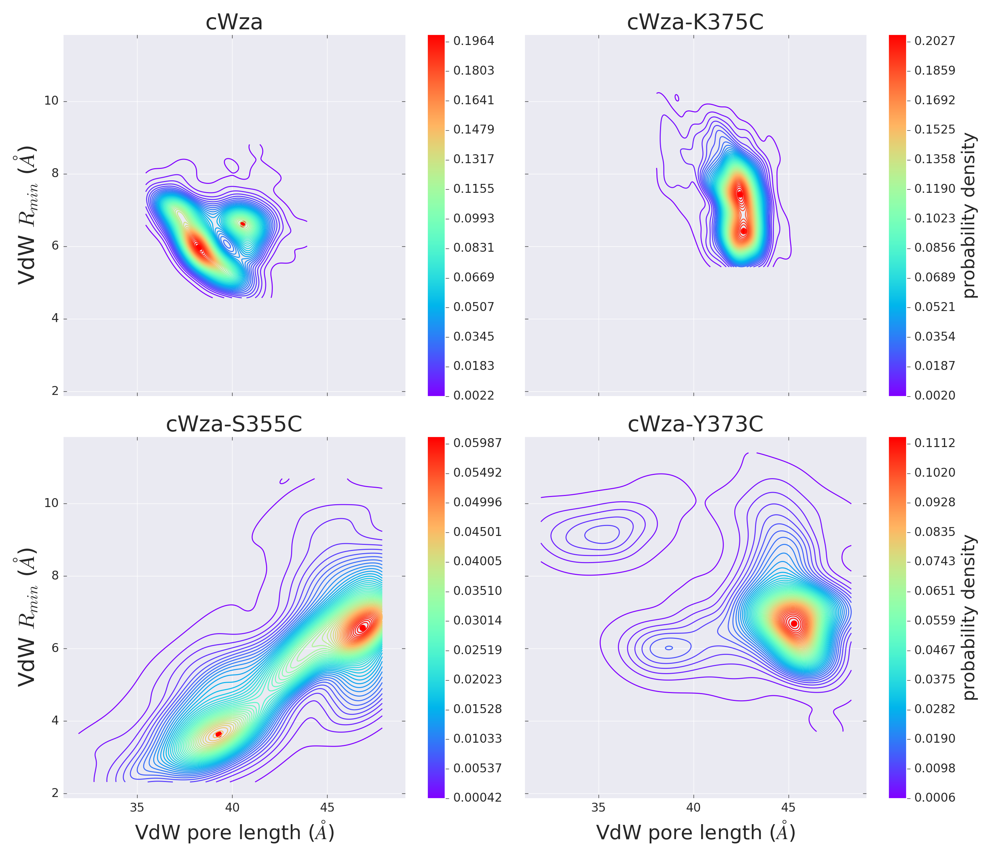

In [11]:
fig, ax = plt.subplots(2,2, figsize=(14,12),dpi=200,sharex=True,sharey=True)
n_mutants = len(mutant_names)
import matplotlib

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

labels = {
    'cWza':("","VdW $R_{min}$ ($\AA$)",""),
    'cWza-K375C':("","","probability density"),
    'cWza-S355C':("VdW pore length ($\AA$)","VdW $R_{min}$ ($\AA$)",""),
    'cWza-Y373C':("VdW pore length ($\AA$)","","probability density")
}

maxima_mutants = {}

kde_mutants = {}

cmap = plt.get_cmap('rainbow')

for i in range(n_mutants):
    mutant = mutant_names[i]
    key11,key12 = 'vdw metrics','length'
    key21,key22 = 'vdw metrics','min'
    X1 = [ S_mutants[mutant][id][key11][key12] for id in S_mutants[mutant].keys()]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in S_mutants[mutant].keys()]
    ################################
    # Estimate PDF and set levels for contour plot
    kde = gaussian_kde([X1,X2])
    kde_mutants[mutant] = kde
    Z = kde([X1,X2])
    pdf_max = max(Z)
    pdf_min = min(Z)
    n_contours = 50
    levels = numpy.linspace(pdf_min, pdf_max,n_contours)
    ##############################################
    Xc,Yc,Zc = list(density_estimation(X1,X2))
    CS = axes[mutant].contour(Xc,Yc,Zc,levels,cmap=cmap)
    ##############################################
    # Colorbar: Continuous
    norm= matplotlib.colors.Normalize(vmin=CS.cvalues.min(), vmax=CS.cvalues.max())
    SM = plt.cm.ScalarMappable(norm=norm, cmap = CS.cmap)
    SM.set_array([])
    CB = fig.colorbar(SM, ticks=CS.levels[::4], ax=axes[mutant])
    ##############################################
    #Find maxima and plot them
    maxima = find_maxima(X1,X2)
    maxima_mutants[mutant] = maxima
    maxima = sorted(maxima, key=itemgetter(1)) # Sort maxima by VdW Rmin 
    for k in range(len(maxima)):
        x,y = maxima[k]
        axes[mutant].scatter(x, y, s=30, marker='o', color='red')
    ##############################################
    # Customise plot
    axes[mutant].set_title(mutant, fontsize=22)
    axes[mutant].tick_params(axis='both',direction='in')
    l1,l2,l3 = labels[mutant]
    axes[mutant].set_xlabel(l1,fontsize=20)
    axes[mutant].set_ylabel(l2,fontsize=22)
    CB.set_label(l3,fontsize=18)

# fig.subplots_adjust(wspace=0.2)
plt.tight_layout()
plt.show()

In [12]:
Conformations = {}
for mutant in mutant_names:
    # Sort by VdW Rmin
    maxima_mutants[mutant] = sorted(maxima_mutants[mutant], key=itemgetter(1))
    if mutant != 'cWza-Y373C':
        Conformations[mutant] = {'Narrow': maxima_mutants[mutant][0], 'Wide': maxima_mutants[mutant][1]}
    else:
        Conformations[mutant] = {'Single': maxima_mutants[mutant][0]}

In [13]:
pd.DataFrame(Conformations,columns=mutant_names,index=['Narrow','Wide','Single'])

,cWza,cWza-K375C,cWza-S355C,cWza-Y373C
Narrow,"(38.2388313213, 5.96939759964)","(42.6309106965, 6.42164032842)","(39.2838957994, 3.6396426309)",NaN
Wide,"(40.5582458845, 6.61623798927)","(42.4464093674, 7.43420785531)","(46.8532066813, 6.57534079583)",NaN
Single,NaN,NaN,NaN,"(45.2750250307, 6.69590032053)"


## Identify regions of high probability

<IPython.core.display.Javascript object>


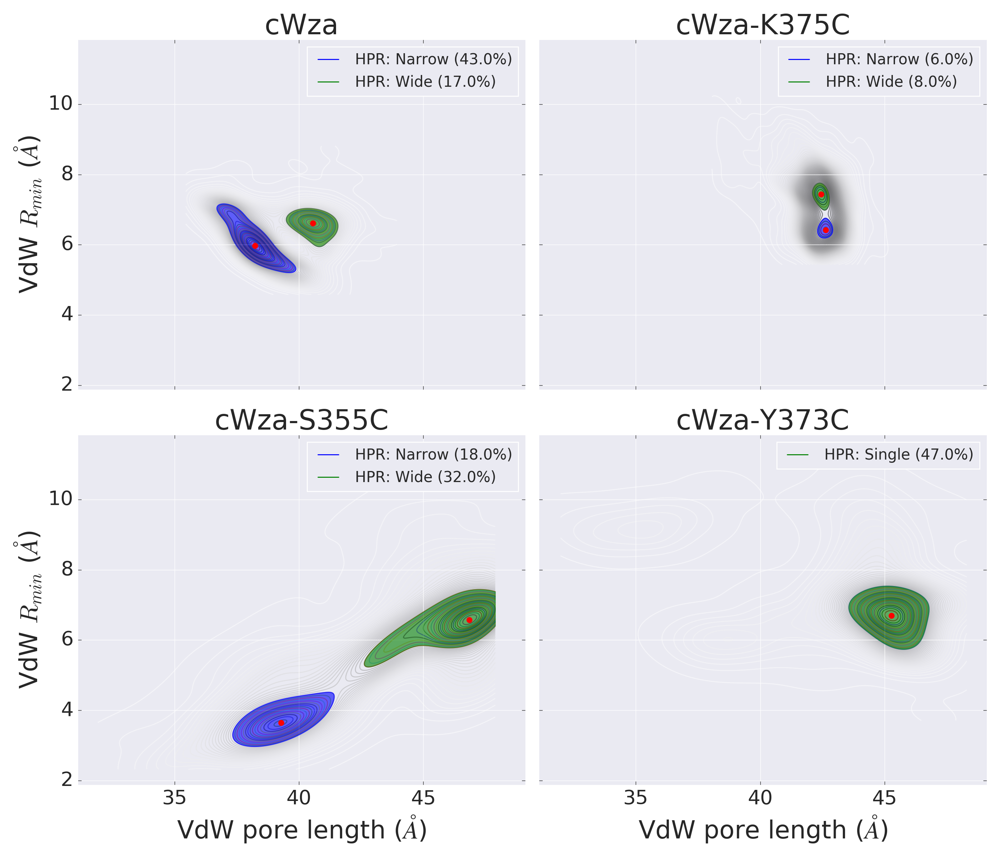

In [15]:
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon

fig, ax = plt.subplots(2,2, figsize=(14,12),dpi=200,sharex=True,sharey=True)

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

labels = {
    'cWza':("","VdW $R_{min}$ ($\AA$)",""),
    'cWza-K375C':("","","probability density"),
    'cWza-S355C':("VdW pore length ($\AA$)","VdW $R_{min}$ ($\AA$)",""),
    'cWza-Y373C':("VdW pore length ($\AA$)","","probability density")
}

Conformations = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single']
}

Colors = {
    'Narrow': 'blue',
    'Wide': 'green',
    'Single': 'green'
}

Contours_filtred = {}
Contours_mutants = {}
ContoursProb_filtred = {}
Filtered_Indices = {}
ff = 0.5 # filtering factor

for i in range(n_mutants):
    mutant = mutant_names[i]
    Contours_filtred[mutant] = {}
    Contours_mutants[mutant] = []
    ContoursProb_filtred[mutant] = {}
    ###############################################
    # Extract DB data
    ###############################################
    key11,key12 = 'vdw metrics','length'
    key21,key22 = 'vdw metrics','min'
    X1 = [ S_mutants[mutant][id][key11][key12] for id in S_mutants[mutant].keys()]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in S_mutants[mutant].keys()]
    ###############################################
    # Stuff for filtering models IDs
    ###############################################
    Filtered_Indices[mutant] = {}
    N_models = len(S_mutants[mutant].keys())
    Points = [Point(X1[n],X2[n]) for n in range(N_models)]
    ###############################################
    # Estimate PDF and set levels for contour plot
    ###############################################
    kde = gaussian_kde([X1,X2])
    Z = kde([X1,X2])
    pdf_max = max(Z)
    pdf_min = min(Z)
    n_contours = 50
    levels = numpy.linspace(pdf_min, pdf_max,n_contours)
    ###############################################
    # Draw all contour plots as black transparent background
    ###############################################
#     axes[mutant].scatter(X1,X2,color='black',alpha=0.1)
    Xc,Yc,Zc = list( density_estimation(X1,X2) )
    CS = axes[mutant].contour(Xc,Yc,Zc,levels,cmap='Greys',alpha=0.5,zorder=0)
    ###############################################
    maxima = maxima_mutants[mutant]
    n_maxima = len(maxima)
    maxima_indices = [(i,list(set(range(n_maxima))-set([i]))) for i in list(set(range(n_maxima)))]
        
    for n in range(n_maxima):
#         conf = Conformations[mutant][n]
        # Indeces of main maximum to isolate and remaining maxima
        n0,other_indices = maxima_indices[n]
        Contours_filtred[mutant][n0] = []
        ContoursProb_filtred[mutant][n0] = []
        point0 = Point(maxima[n0])
        other_points = [Point(maxima[n1]) for n1 in other_indices]
        # 
        peak0_height = kde(maxima[n0])[0]
    #     print(maxima[n0],peak0_height)
        x,y = maxima[n0]
#         axes[mutant].scatter(x,y,s=50,color='red',zorder=10)
        for l in range(len(CS.allsegs)):
            prob = CS.levels[l]
            for k in range(len(CS.allsegs[l])):
                # Extract contour line coordinates
                CS_coords = CS.allsegs[l][k]
                Contours_mutants[mutant].append(CS_coords)
                # Turn contour line into Polygon
                polygon = Polygon(CS_coords)
                # Check if maximum within contour line
                if polygon.contains(point0):
                    if all([not polygon.contains(point) for point in other_points]):
                        if prob > ff*peak0_height:
                            Contours_filtred[mutant][n0].append(CS_coords)
                            ContoursProb_filtred[mutant][n0].append(prob)
                            CS_coords = CS_coords.T
                            axes[mutant].plot(CS_coords[0],CS_coords[1],alpha=0.2,zorder=5)
    ###############################################                            
    # Customise plot
    ###############################################
    axes[mutant].set_title(mutant, fontsize=28)
    axes[mutant].tick_params(axis='both',direction='in',labelsize=20)
    l1,l2,l3 = labels[mutant]
    axes[mutant].set_xlabel(l1,fontsize=25)
    axes[mutant].set_ylabel(l2,fontsize=25)
    ###############################################
    # Fill regions of HP and show maxima
    ###############################################
    for n in range(n_maxima):
        x,y = maxima_mutants[mutant][n]
        axes[mutant].scatter(x,y,s=25,color='red',zorder=10)
        X,Y = Contours_filtred[mutant][n][0].T
        ###############################################
        # Count models
        ###############################################
        polygon = Polygon(Contours_filtred[mutant][n][0])
        Filtered_Indices[mutant][n] = [k for k in range(N_models) if polygon.contains(Points[k])]
        ###############################################
        if max(ContoursProb_filtred[mutant][n]) > 0.02:
            c = Colors[Conformations[mutant][n]]
            axes[mutant].fill(X,Y,color=c,alpha=0.6)
            C_name = Conformations[mutant][n] # Conformation name
            N_models_C = len(Filtered_Indices[mutant][n]) # No models per conformation
            Percentage = numpy.floor(100*(N_models_C/N_models)) # Percentage
            # Add legend box
            axes[mutant].plot([],[],label='HPR: '+C_name+' ('+str(Percentage)+'%)',color=c)
    ###############################################
    axes[mutant].legend(loc='best',fontsize=15)

# axes[mutant].set_xlim(35,50)
# axes[mutant].set_ylim(2,10)

plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


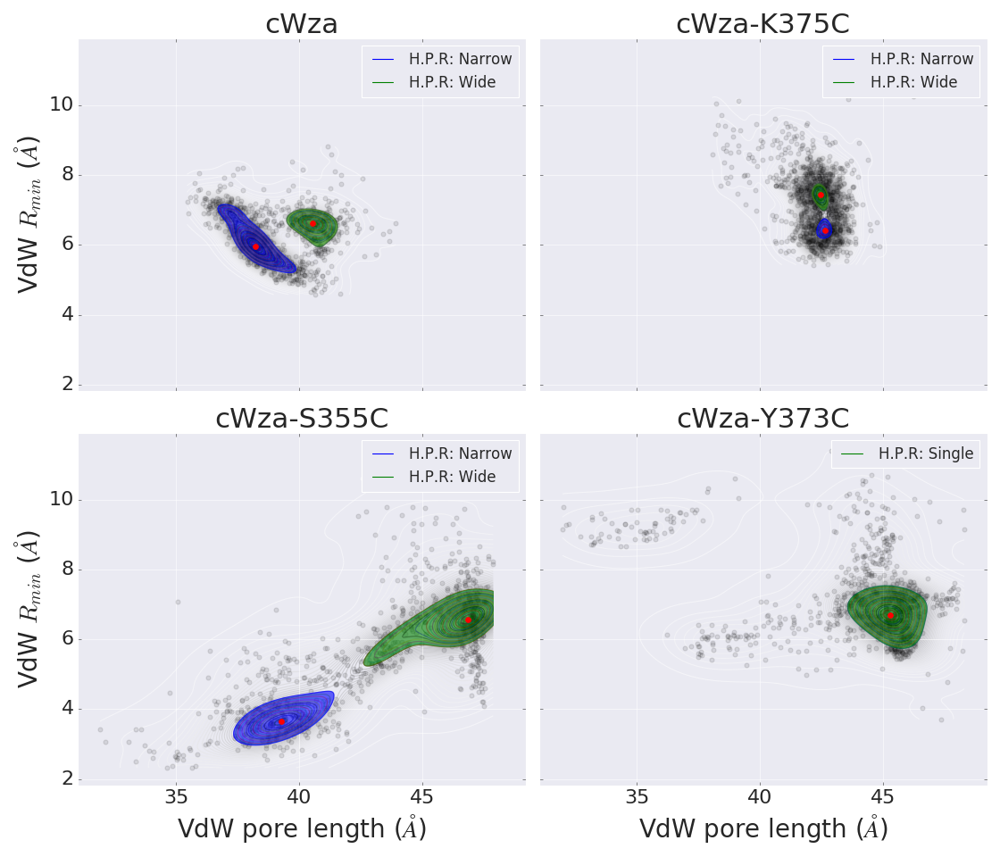

In [26]:
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon

fig, ax = plt.subplots(2,2, figsize=(14,12),sharex=True,sharey=True)

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

labels = {
    'cWza':("","VdW $R_{min}$ ($\AA$)",""),
    'cWza-K375C':("","","probability density"),
    'cWza-S355C':("VdW pore length ($\AA$)","VdW $R_{min}$ ($\AA$)",""),
    'cWza-Y373C':("VdW pore length ($\AA$)","","probability density")
}

Conformations = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single']
}

Colors = {
    'Narrow': 'blue',
    'Wide': 'green',
    'Single': 'green'
}

Contours_filtred = {}
Contours_mutants = {}
ContoursProb_filtred = {}

ff = 0.5 # filtering factor

for i in range(n_mutants):
    mutant = mutant_names[i]
    Contours_filtred[mutant] = {}
    Contours_mutants[mutant] = []
    ContoursProb_filtred[mutant] = {}
    ###############################################
    # Extract DB data
    ###############################################
    key11,key12 = 'vdw metrics','length'
    key21,key22 = 'vdw metrics','min'
    X1 = [ S_mutants[mutant][id][key11][key12] for id in S_mutants[mutant].keys()]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in S_mutants[mutant].keys()]
    ###############################################
    # Estimate PDF and set levels for contour plot
    ###############################################
    kde = gaussian_kde([X1,X2])
    Z = kde([X1,X2])
    pdf_max = max(Z)
    pdf_min = min(Z)
    n_contours = 50
    levels = numpy.linspace(pdf_min, pdf_max,n_contours)
    ###############################################
    # Draw all contour plots as black transparent background
    ###############################################
    axes[mutant].scatter(X1,X2,color='black',alpha=0.1)
    Xc,Yc,Zc = list( density_estimation(X1,X2) )
    CS = axes[mutant].contour(Xc,Yc,Zc,levels,cmap='Greys',alpha=0.5,zorder=0)
    ###############################################
    maxima = maxima_mutants[mutant]
    n_maxima = len(maxima)
    maxima_indices = [(i,list(set(range(n_maxima))-set([i]))) for i in list(set(range(n_maxima)))]
    #
    for n in range(n_maxima):
#         conf = Conformations[mutant][n]
        # Indeces of main maximum to isolate and remaining maxima
        n0,other_indices = maxima_indices[n]
        Contours_filtred[mutant][n0] = []
        ContoursProb_filtred[mutant][n0] = []
        point0 = Point(maxima[n0])
        other_points = [Point(maxima[n1]) for n1 in other_indices]
        # 
        peak0_height = kde(maxima[n0])[0]
    #     print(maxima[n0],peak0_height)
        x,y = maxima[n0]
#         axes[mutant].scatter(x,y,s=50,color='red',zorder=10)
        for l in range(len(CS.allsegs)):
            prob = CS.levels[l]
            for k in range(len(CS.allsegs[l])):
                # Extract contour line coordinates
                CS_coords = CS.allsegs[l][k]
                Contours_mutants[mutant].append(CS_coords)
                # Turn contour line into Polygon
                polygon = Polygon(CS_coords)
                # Check if maximum within contour line
                if polygon.contains(point0):
                    if all([not polygon.contains(point) for point in other_points]):
                        if prob > ff*peak0_height:
                            Contours_filtred[mutant][n0].append(CS_coords)
                            ContoursProb_filtred[mutant][n0].append(prob)
                            CS_coords = CS_coords.T
                            axes[mutant].plot(CS_coords[0],CS_coords[1],alpha=0.2,zorder=5)
    ###############################################                            
    # Customise plot
    ###############################################
    axes[mutant].set_title(mutant, fontsize=28)
    axes[mutant].tick_params(axis='both',direction='in',labelsize=20)
    l1,l2,l3 = labels[mutant]
    axes[mutant].set_xlabel(l1,fontsize=25)
    axes[mutant].set_ylabel(l2,fontsize=25)
    ###############################################
    # Fill regions of HP and show maxima
    ###############################################
    for n in range(n_maxima):
        x,y = maxima_mutants[mutant][n]
        axes[mutant].scatter(x,y,s=25,color='red',zorder=10)
        X,Y = Contours_filtred[mutant][n][0].T
        if max(ContoursProb_filtred[mutant][n]) > 0.02:
            c = Colors[Conformations[mutant][n]]
            axes[mutant].fill(X,Y,color=c,alpha=0.6)
            axes[mutant].plot([],[],label='H.P.R: '+Conformations[mutant][n],color=c)
    ###############################################
    axes[mutant].legend(loc='best',fontsize=15)

# axes[mutant].set_xlim(35,50)
# axes[mutant].set_ylim(2,10)
    
plt.tight_layout()
plt.show()

## Interaction groups : Distribution of partition sets in Conformational Space

In [27]:
wd = '/projects/s21/ba13026/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/'
filename = wd+'filtered_ids_new.json'

with open(filename,'r') as fp:
    Filtered_IDs = json.load(fp)

In [28]:
wd = '/projects/s21/ba13026/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/'
filename = wd+'filtered_ids_interaction_groups.json'
with open(filename,'r') as fp:
    Models_Out_IDs = json.load(fp)

<IPython.core.display.Javascript object>


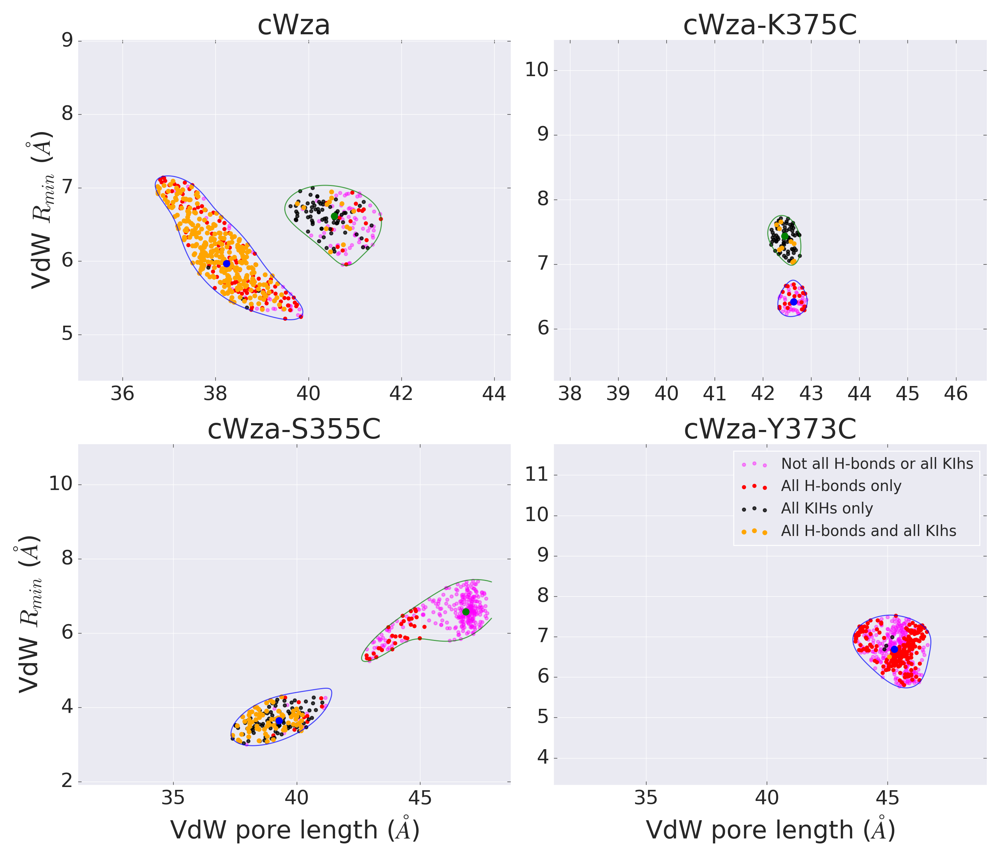

In [29]:
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon

fig, ax = plt.subplots(2,2, figsize=(14,12),dpi=200)

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

labels = {
    'cWza':("","VdW $R_{min}$ ($\AA$)",""),
    'cWza-K375C':("","","probability density"),
    'cWza-S355C':("VdW pore length ($\AA$)","VdW $R_{min}$ ($\AA$)",""),
    'cWza-Y373C':("VdW pore length ($\AA$)","","probability density")
}

Colors = ['blue','green']
# Colors = {
#     'Narrow': 'blue',
#     'Wide': 'green',
#     'Single': 'green'
# }

#############################################
MyTags  = [
    json.dumps(['cWza', 'conformation0']),
    json.dumps(['cWza', 'conformation1']),
    json.dumps(['cWza-K375C', 'conformation0']),
    json.dumps(['cWza-K375C', 'conformation1']),
    json.dumps(['cWza-S355C', 'conformation0']),
    json.dumps(['cWza-S355C', 'conformation1']),
    json.dumps(['cWza-Y373C', 'conformation0'])
]

for tags in MyTags:
    mutant, C_x = json.loads(tags)
    X_all = set(list(Filtered_IDs[mutant][C_x]))
    
    X_hbonds = set(Models_Out_IDs['hbonds'][tags])
    X_kihs = set(Models_Out_IDs['kihs'][tags])
    X_hbonds_NOT_kihs = set(X_hbonds - X_kihs)
    X_kihs_NOT_hbonds = set(X_kihs - X_hbonds)
    X_hbonds_AND_kihs = set(X_hbonds & X_kihs)
    X_hbonds_NOR_kihs = X_all - set(X_hbonds | X_kihs)
    
    key11,key12 = 'vdw metrics','length'
    key21,key22 = 'vdw metrics','min'

    X1 = [ S_mutants[mutant][id][key11][key12] for id in list(X_hbonds_NOR_kihs)]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in list(X_hbonds_NOR_kihs)]
    axes[mutant].scatter(X1,X2,s=10,color='magenta',label = 'Not all H-bonds or all KIhs',alpha=0.4)
    
    X1 = [ S_mutants[mutant][id][key11][key12] for id in list(X_hbonds_NOT_kihs)]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in list(X_hbonds_NOT_kihs)]
    axes[mutant].scatter(X1,X2,s=10,color='red',label = 'All H-bonds only',alpha=1)

    X1 = [ S_mutants[mutant][id][key11][key12] for id in list(X_kihs_NOT_hbonds)]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in list(X_kihs_NOT_hbonds)]
    axes[mutant].scatter(X1,X2,s=10,color='black',label = 'All KIHs only',alpha=0.75)
    
    X1 = [ S_mutants[mutant][id][key11][key12] for id in list(X_hbonds_AND_kihs)]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in list(X_hbonds_AND_kihs)]
    axes[mutant].scatter(X1,X2,s=15,color='orange',label = 'All H-bonds and all KIhs',alpha=1)
#############################################

Contours_filtred = {}
Contours_mutants = {}
ContoursProb_filtred = {}

ff = 0.5 # filtering factor
n_mutants = len(mutant_names)
for i in range(n_mutants):
    mutant = mutant_names[i]
    Contours_filtred[mutant] = {}
    Contours_mutants[mutant] = []
    ContoursProb_filtred[mutant] = {}
    ###############################################
    # Extract DB data
    ###############################################
    key11,key12 = 'vdw metrics','length'
    key21,key22 = 'vdw metrics','min'
    X1 = [ S_mutants[mutant][id][key11][key12] for id in S_mutants[mutant].keys()]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in S_mutants[mutant].keys()]

    ###############################################
    # Estimate PDF and set levels for contour plot
    ###############################################
    kde = gaussian_kde([X1,X2])
    Z = kde([X1,X2])
    pdf_max = max(Z)
    pdf_min = min(Z)
    n_contours = 50
    levels = numpy.linspace(pdf_min, pdf_max,n_contours)
    ###############################################
    # Draw all contour plots as black transparent background
    ###############################################
#     axes[mutant].scatter(X1,X2,color='black',alpha=0.1)
    Xc,Yc,Zc = list( density_estimation(X1,X2) )
    CS = axes[mutant].contour(Xc,Yc,Zc,levels,color='black',alpha=0,zorder=0)
    ###############################################
    maxima = maxima_mutants[mutant]
    n_maxima = len(maxima)
    maxima_indices = [(i,list(set(range(n_maxima))-set([i]))) for i in list(set(range(n_maxima)))]
    #
    for n in range(n_maxima):
#         conf = Conformations[mutant][n]
        # Indeces of main maximum to isolate and remaining maxima
        n0,other_indices = maxima_indices[n]
        Contours_filtred[mutant][n0] = []
        ContoursProb_filtred[mutant][n0] = []
        point0 = Point(maxima[n0])
        other_points = [Point(maxima[n1]) for n1 in other_indices]
        # 
        peak0_height = kde(maxima[n0])[0]
    #     print(maxima[n0],peak0_height)
        x,y = maxima[n0]
#         axes[mutant].scatter(x,y,s=50,color='red',zorder=10)
        for l in range(len(CS.allsegs)):
            prob = CS.levels[l]
            for k in range(len(CS.allsegs[l])):
                # Extract contour line coordinates
                CS_coords = CS.allsegs[l][k]
                Contours_mutants[mutant].append(CS_coords)
                # Turn contour line into Polygon
                polygon = Polygon(CS_coords)
                # Check if maximum within contour line
                if polygon.contains(point0):
                    if all([not polygon.contains(point) for point in other_points]):
                        if prob > ff*peak0_height:
                            Contours_filtred[mutant][n0].append(CS_coords)
                            ContoursProb_filtred[mutant][n0].append(prob)
                            CS_coords = CS_coords.T
#                             axes[mutant].plot(CS_coords[0],CS_coords[1],color=Colors[n],alpha=0.7,zorder=5)
#                             axes[mutant].plot(CS_coords[0],CS_coords[1],color=Colors[n],alpha=0.2,zorder=5)
    ###############################################                            
    # Customise plot
    ###############################################
    axes[mutant].set_title(mutant, fontsize=28)
    axes[mutant].tick_params(axis='both',direction='in',labelsize=20)
    l1,l2,l3 = labels[mutant]
    axes[mutant].set_xlabel(l1,fontsize=25)
    axes[mutant].set_ylabel(l2,fontsize=25)
    
    ###############################################
    # Fill regions of HP and show maxima
    ###############################################
    maxima_color = ['blue','green']
    for n in range(n_maxima):
        x,y = maxima_mutants[mutant][n]
        X,Y = Contours_filtred[mutant][n][0].T
        # Plot boundary of regio of HP
        if max(ContoursProb_filtred[mutant][n]) > 0.02:
            axes[mutant].plot(X,Y,color=Colors[n],alpha=0.7)
            axes[mutant].scatter(x,y,s=40,color=maxima_color[n],zorder=10,alpha=1)
    ###############################################

axes[mutant].legend(loc='best',fontsize=15)
    
plt.tight_layout()
plt.show()

## Sample models 

### How many models have we already simulated?

List of finishsed simulations obatined using 

```bash
ls cWza*/conformation*/refined1_0001_INPUT_*_ignorechain/complex/mdf/md_100ns.gro > FINISHED_md_100ns.t
xt
```

In [30]:
infile = wd+"FINISHED_md_100ns.txt"
Models_all_finished_md = ['/'.join(x.split('/')[:3]) for x in open(infile,'r').readlines()]

In [31]:
len(Models_all_finished_md)

279

**How many of these models fall within each interaction partition, per conformational group?**

Get all models IDs per mutually exclusive partition, per conformational group, per mutant

In [32]:
Models_IDs = {}

for tags in MyTags:
    Models_IDs[tags]= {}
    mutant, C_x = json.loads(tags)
    ###############################################
    X_all = set(list(Filtered_IDs[mutant][C_x]))
    X_hbonds = set(Models_Out_IDs['hbonds'][tags])
    X_kihs = set(Models_Out_IDs['kihs'][tags])
    X_hbonds_NOT_kihs = set(X_hbonds - X_kihs)
    X_kihs_NOT_hbonds = set(X_kihs - X_hbonds)
    X_hbonds_AND_kihs = set(X_hbonds & X_kihs)
    X_hbonds_NOR_kihs = X_all - set(X_hbonds | X_kihs)
    ###############################################
    Models_IDs[tags]['hbonds_NOR_kihs'] = list(X_hbonds_NOR_kihs)
    Models_IDs[tags]['hbonds_NOT_kihs'] = list(X_hbonds_NOT_kihs)
    Models_IDs[tags]['kihs_NOT_hbonds'] = list(X_kihs_NOT_hbonds)
    Models_IDs[tags]['hbonds_AND_kihs'] = list(X_hbonds_AND_kihs)

Get pdbnames of the above

In [33]:
Models_PDBs = {}

for tags in MyTags:
    mutant, C_x = json.loads(tags)
    ##################################
    # Correct mislabelling
    if mutant == 'cWza-Y373C':
        C_x = "conformation1"
    elif mutant == 'cWza-K375C' and C_x == "conformation0":
        C_x = "conformation1"
    elif mutant == 'cWza-K375C' and C_x == "conformation1":
        C_x = "conformation0"
    ##################################
    Models_PDBs[tags] = {}
    for partition in list(Models_IDs[tags].keys()):
        Models_PDBs[tags][partition] = []
        for id in list(map(int,Models_IDs[tags][partition])):
            pdbname = session.query(Tags.pdb_name).filter_by(id=id).all()[0][0][:-4]
            modeldir = mutant+"/"+C_x+"/"+pdbname
            Models_PDBs[tags][partition].append(modeldir)

Classify URMD-finished models according to identified partitions

In [34]:
PARTITIONS = ['hbonds_NOT_kihs', 'hbonds_NOR_kihs', 'kihs_NOT_hbonds', 'hbonds_AND_kihs']
Models_all_finished_md_Classified = {}

for tags in MyTags:
    Models_all_finished_md_Classified[tags] = {}
    for partition in PARTITIONS:
        Models_all_finished_md_Classified[tags][partition] = []

for modeldir in Models_all_finished_md:
    mutant, C_x, pdbname = modeldir.split("/")
    ##################################
    # Correct mislabelling
    if mutant == 'cWza-Y373C':
        C_x = "conformation0"
    elif mutant == 'cWza-K375C' and C_x == "conformation0":
        C_x = "conformation1"
    elif mutant == 'cWza-K375C' and C_x == "conformation1":
        C_x = "conformation0"
    ##################################
    tags = json.dumps([mutant, C_x])
    for partition in list(Models_PDBs[tags].keys()):
        if modeldir in Models_PDBs[tags][partition]:
            Models_all_finished_md_Classified[tags][partition].append(modeldir)

### How many more models do we need to simulate (in principle)?

Work out target sample size needed per partition, considering the models with finished MD simulations.

In [35]:
sample_size_standard = 10 # standard target value
sample_size_dict = {}
COUNTER = 0
COUNTER_extra = 0

for tags in MyTags:
    sample_size_dict[tags] = {}
    for partition in PARTITIONS:
        sample_size_dict[tags][partition] = []
        N_models = len(Models_all_finished_md_Classified[tags][partition])
        if N_models < sample_size_standard:
            sample_size_target = sample_size_standard - N_models
            COUNTER_extra = COUNTER_extra + sample_size_target
            sample_size_dict[tags][partition] = sample_size_target
        else:
            sample_size_dict[tags][partition] = 0     
        COUNTER = COUNTER + N_models

In [36]:
COUNTER, COUNTER_extra

(278, 84)

In [494]:
COUNTER, COUNTER_extra

(182, 172)

### Choose remaning models to submit for PRMD or URMD simulation

Sample models according to random distribution

In [37]:
from numpy.random import choice

def get_sample(data, sample_size):
    data = list(data)
    try:
        sample_ids = choice(list(data), sample_size, replace=False)
        return sample_ids
    except:
        return data

In [38]:
Samples_PDBs = {}

for tags in MyTags:
    Samples_PDBs[tags] = {}
    for partition in PARTITIONS:
        ###############################################
        X = set(Models_PDBs[tags][partition]) #  All models pdbnames per partition, in conformational group
        Y = set(Models_all_finished_md_Classified[tags][partition]) # All MD finished models
        Z = X - (X & Y) # Set to sample from
        ###############################################
        sz = sample_size_dict[tags][partition]
        Samples_PDBs[tags][partition] = get_sample(Z,sz)

Actual size of samples

In [497]:
Samples_PDBs_list = []

COUNTER = 0
for tags in MyTags:
    for partition in PARTITIONS:
        N = len(Samples_PDBs[tags][partition])
        if N > 0:
            Samples_PDBs_list = Samples_PDBs_list + list(Samples_PDBs[tags][partition])
        COUNTER = COUNTER + N

In [498]:
COUNTER

89

Save samples per interaction partitions within each conformational group

In [500]:
outfile = wd + 'Interaction_Partition_Sample.txt'
with open(outfile,'w') as fp:
    for modeldir in Samples_PDBs_list:
        fp.write(modeldir+'\n')
fp.close()

**Sample randomly models for URMD from conformation group**

Modify these lines

In [39]:
MyTags

['["cWza", "conformation0"]',
 '["cWza", "conformation1"]',
 '["cWza-K375C", "conformation0"]',
 '["cWza-K375C", "conformation1"]',
 '["cWza-S355C", "conformation0"]',
 '["cWza-S355C", "conformation1"]',
 '["cWza-Y373C", "conformation0"]']

In [51]:
import itertools
X = list(Models_PDBs['["cWza", "conformation1"]'].values())
len(list(itertools.chain.from_iterable(X))) # SAMPLE FROM THIS MODEL

170

In [38]:
Samples_PDBs = {}

tag = '["cWza", "conformation1"]'
Samples_PDBs[tags] = {}
for partition in PARTITIONS:
    ###############################################
    X = set(Models_PDBs[tags][partition]) #  All models pdbnames per partition, in conformational group
    Y = set(Models_all_finished_md_Classified[tags][partition]) # All MD finished models
    Z = X - (X & Y) # Set to sample from
    ###############################################
    sz = sample_size_dict[tags][partition]
    Samples_PDBs[tags][partition] = get_sample(Z,sz)

### Identify reminaing models in sample for simulation

In [21]:
import json
import os

In [8]:
wd = '/projects/s21/ba13026/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/'

In [50]:
MyTags  = [
    json.dumps(['cWza', 'conformation0']),
    json.dumps(['cWza', 'conformation1']),
    json.dumps(['cWza-K375C', 'conformation0']),
    json.dumps(['cWza-K375C', 'conformation1']),
    json.dumps(['cWza-S355C', 'conformation0']),
    json.dumps(['cWza-S355C', 'conformation1']),
    json.dumps(['cWza-Y373C', 'conformation1'])
]

**CASE 1** Models from a sample

In [69]:
with open(wd+'EMMD_Sample.json') as fp:
    models_dirs = json.load(fp)

In [70]:
for tag in MyTags:
    COUNTER = 0
    for d in models_dirs:
        mutant, group, model = d.split('/')
        if json.dumps([mutant,group]) == tag :
            COUNTER +=1
    print(COUNTER, tag)

86 ["cWza", "conformation0"]
33 ["cWza", "conformation1"]
16 ["cWza-K375C", "conformation0"]
11 ["cWza-K375C", "conformation1"]
36 ["cWza-S355C", "conformation0"]
59 ["cWza-S355C", "conformation1"]
92 ["cWza-Y373C", "conformation1"]


In [81]:
file1 = 'prmd.gro'
file2 = 'md_100ns.gro'
prefix = '/complex/mdf/'

models_for_md = []
prefix = '/complex/mdf/'

for tag in MyTags:
    COUNTER = 0
    for d in models_dirs:
        mutant, group, model = d.split('/')
        if json.dumps([mutant,group]) == tag :
            path1 = wd+d+prefix+file1
            path2 = wd+d+prefix+file2
            if os.path.isfile(path1) and not os.path.isfile(path2):
                COUNTER += 1
                models_for_md.append(d)
    print(COUNTER, tag)

18 ["cWza", "conformation0"]
11 ["cWza", "conformation1"]
0 ["cWza-K375C", "conformation0"]
0 ["cWza-K375C", "conformation1"]
17 ["cWza-S355C", "conformation0"]
19 ["cWza-S355C", "conformation1"]
45 ["cWza-Y373C", "conformation1"]


In [88]:
len(models_for_md)

110

In [90]:
with open(wd+'remaining_models_md_100ns.json','w') as fp:
    json.dump(models_for_md, fp, indent=4)
fp.close()

In [91]:

with open(wd+'remaining_models_md_100ns.txt','w') as fp:
    for d in models_for_md:
        fp.write(d+'\n')
fp.close()

Prepare files

```bash
nohup python parallel_md_100ns-prep.py 10 remaining_models_md_100ns.json > remaining_models_md_100ns.out
```

```bash
awk '{system("cd "$1"; sbatch complex/jobf/md_100ns.bg.slurm; cd -")}' remaining_models_md_100ns.txt^C
```

### Choose more models from conformation groups for simulation

**CASE 2** All embedded models

In [57]:
models_dirs = []
for tag in MyTags:
    prefix = '/'.join(json.loads(tag))
    models_dirs = models_dirs + [prefix+'/'+d for d in os.listdir(wd+prefix)]

In [58]:
for tag in MyTags:
    COUNTER = 0
    for d in models_dirs:
        mutant, group, model = d.split('/')
        if json.dumps([mutant,group]) == tag :
            COUNTER +=1
    print(COUNTER, tag)

436 ["cWza", "conformation0"]
170 ["cWza", "conformation1"]
84 ["cWza-K375C", "conformation0"]
60 ["cWza-K375C", "conformation1"]
183 ["cWza-S355C", "conformation0"]
320 ["cWza-S355C", "conformation1"]
475 ["cWza-Y373C", "conformation1"]


In [ ]:
file1 = 'prmd.gro'
file2 = 'md_100ns.gro'
prefix = '/complex/mdf/'

models_list = []
models_dir = os.listdir(wd+'cWza/conformation1/')
for f in models_dir:
    path1 = wd+'cWza/conformation1/'+f+prefix+file1
    path2 = wd+'cWza/conformation1/'+f+prefix+file2
    if os.path.isfile(path1) and not os.path.isfile(path2):
        models_list.append('cWza/conformation1/'+f)

In [19]:
len(models_list)

11

In [87]:
models_list


['cWza/conformation1/refined1_0001_INPUT_0145_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0200_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0291_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0408_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0092_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0254_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0976_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0455_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0247_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0899_ignorechain',
 'cWza/conformation1/refined1_0001_INPUT_0931_ignorechain']

**Sample according to probability**

Get PDB names and model dirs for sample ids

Save sample dict

**TEST** Check whether dirs exist

### Decide type of simulation 

**TEST**: Check if PRMD done for models in samples

In [502]:
infile = wd + 'Interaction_Partition_Sample.txt'

Samples_PDBs_list = [x.strip() for x in open(infile,'r').readlines()]

In [504]:
Models_sample_submit = {'prmd':[],'md':[]}

for modeldir in Samples_PDBs_list:
    ##########################################
    filename0 = '/complex/mdf/em_20000stps.gro'
    filename1 = '/complex/mdf/prmd.gro'
    filename2 = '/complex/mdf/md_100ns.gro'
    ##########################################
    filepath0 = wd + modeldir + filename0
    filepath1 = wd + modeldir + filename1
    filepath2 = wd + modeldir + filename2
    ##########################################
    if os.path.isfile(filepath0) and not os.path.isfile(filepath1):
        Models_sample_submit['prmd'].append(modeldir)
    elif os.path.isfile(filepath1) and not os.path.isfile(filepath2):
        Models_sample_submit['md'].append(modeldir)

In [511]:
with open(wd+'submit_for_prmd.txt','w') as fp:
    for modeldir in Models_sample_submit['prmd']:
        fp.write(modeldir+'\n')

with open(wd+'submit_for_prmd.json','w') as fp:
    json.dump(Models_sample_submit['prmd'], fp, indent=4)
        
with open(wd+'submit_for_md.txt','w') as fp:
    for modeldir in Models_sample_submit['md']:
        fp.write(modeldir+'\n')
        
with open(wd+'submit_for_md.json','w') as fp:
    json.dump(Models_sample_submit['md'], fp, indent=4)

Submitted jobs

```bash
nohup python parallel_prmd-prep.py 10 submit_for_prmd.json > submit_for_prmd.out &


for modeldir in `cat submit_for_prmd.txt`; do 
    cd  ${modeldir}
    sbatch complex/jobf/prmd.slurm
    cd -
done

```

**Save identity of models accoring to interaction partitions**

In [516]:
outfile = wd+'all_docked-pdbs_conformations_interaction-partitioned.json'
with open(outfile,'w') as fp:
    json.dump(Models_PDBs, fp, indent=4)

## Obtain model identity per conformational group

In [66]:
Filtered_Indices = {}
for i in range(n_mutants):
    mutant = mutant_names[i]
    Filtered_Indices[mutant] = {}
    ###################################
    key11,key12 = 'vdw metrics','length'
    key21,key22 = 'vdw metrics','min'
    IDs = [id for id in S_mutants[mutant].keys()]
    X1 = [ S_mutants[mutant][id][key11][key12] for id in IDs]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in IDs]
    N = len(IDs)
    Points = [Point(X1[j],X2[j]) for j in range(N)]
    ###################################
    n_maxima = len(maxima_mutants[mutant])
    for n in range(n_maxima):
        polygon = Polygon(Contours_filtred[mutant][n][0])
        Filtered_Indices[mutant][n] = [k for k in range(N) if polygon.contains(Points[k])]

Show countour lines within boundaries of regions of high probability

<IPython.core.display.Javascript object>


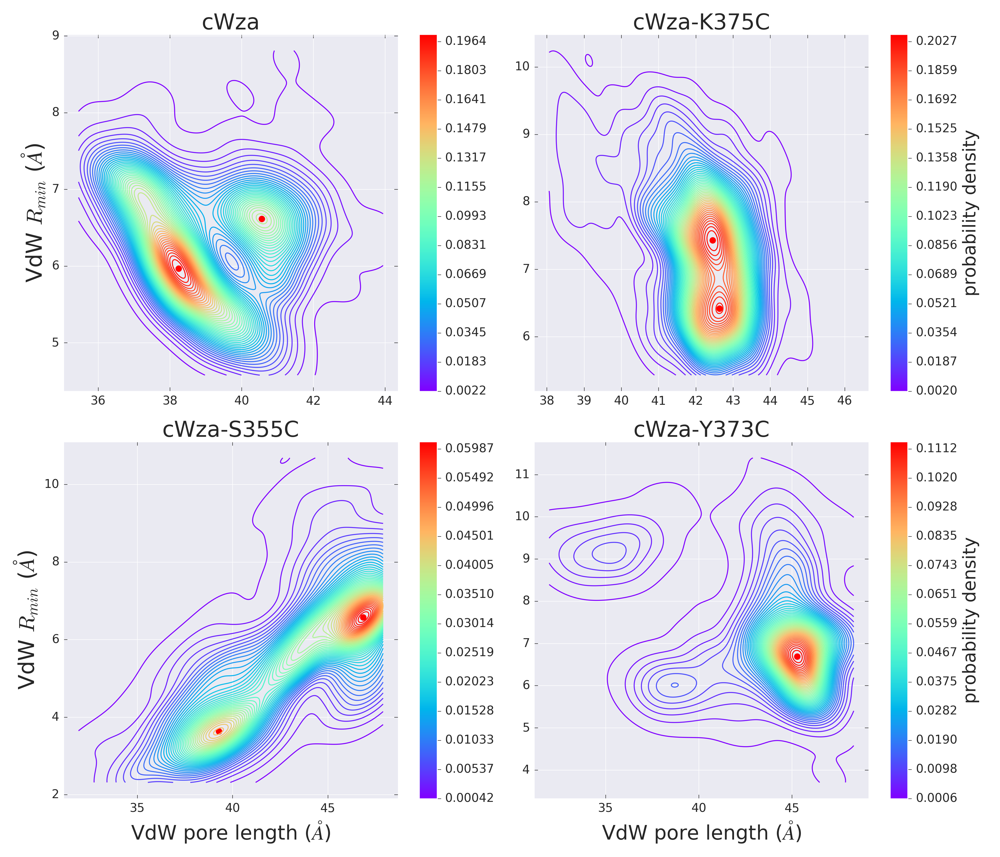

In [112]:
fig, ax = plt.subplots(2,2, figsize=(14,12),dpi=250)

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

labels = {
    'cWza':("","VdW $R_{min}$ ($\AA$)",""),
    'cWza-K375C':("","","probability density"),
    'cWza-S355C':("VdW pore length ($\AA$)","VdW $R_{min}$ ($\AA$)",""),
    'cWza-Y373C':("VdW pore length ($\AA$)","","probability density")
}

maxima_mutants = {}

kde_mutants = {}

cmap = plt.get_cmap('rainbow')
Norm_maps = {}
CBs_mutants = {}

for i in range(n_mutants):
    mutant = mutant_names[i]
    key11,key12 = 'vdw metrics','length'
    key21,key22 = 'vdw metrics','min'
    X1 = [ S_mutants[mutant][id][key11][key12] for id in S_mutants[mutant].keys()]
    X2 = [ S_mutants[mutant][id][key21][key22] for id in S_mutants[mutant].keys()]
    ################################
    # Estimate PDF and set levels for contour plot
    kde = gaussian_kde([X1,X2])
    kde_mutants[mutant] = kde
    Z = kde([X1,X2])
    pdf_max = max(Z)
    pdf_min = min(Z)
    n_contours = 50
    levels = numpy.linspace(pdf_min, pdf_max,n_contours)
    ##############################################
    Xc,Yc,Zc = list(density_estimation(X1,X2))
    CS = axes[mutant].contour(Xc,Yc,Zc,levels,cmap=cmap)
    ##############################################
    # Colorbar: Continuous
    norm= matplotlib.colors.Normalize(vmin=CS.cvalues.min(), vmax=CS.cvalues.max())
    Norm_maps[mutant] = norm
    SM = plt.cm.ScalarMappable(norm=norm, cmap = CS.cmap)
    SM.set_array([])
    # Show values for every 4 contour lines
    CB = fig.colorbar(SM, ticks=CS.levels[::4], ax=axes[mutant])
    CBs_mutants[mutant] = CB
    ##############################################
    # Find maxima and plot them
    maxima = find_maxima(X1,X2)
    maxima = sorted(maxima, key=itemgetter(1)) # Sort maxima by VdW Rmin 
    maxima_mutants[mutant] = maxima
    for k in range(len(maxima)):
        x,y = maxima[k]
        axes[mutant].scatter(x,y,s=30,marker='o',color='red')
    ##############################################
    # Customise plot
    axes[mutant].set_title(mutant, fontsize=22)
    axes[mutant].tick_params(axis='both',direction='in')
    l1,l2,l3 = labels[mutant]
    axes[mutant].set_xlabel(l1,fontsize=20)
    axes[mutant].set_ylabel(l2,fontsize=22)
    CB.set_label(l3,fontsize=18)

# fig.subplots_adjust(wspace=0.2)
plt.tight_layout()

plt.show()

In [61]:
maxima_mutants

{'cWza': [(38.238831321274162, 5.9693975996432966),
  (40.558245884503691, 6.6162379892747873)],
 'cWza-K375C': [(42.630910696544809, 6.4216403284226224),
  (42.446409367362236, 7.4342078553105928)],
 'cWza-S355C': [(39.283895799352997, 3.6396426308975558),
  (46.853206681267665, 6.5753407958330605)],
 'cWza-Y373C': [(45.275025030717444, 6.69590032052864)]}

<IPython.core.display.Javascript object>


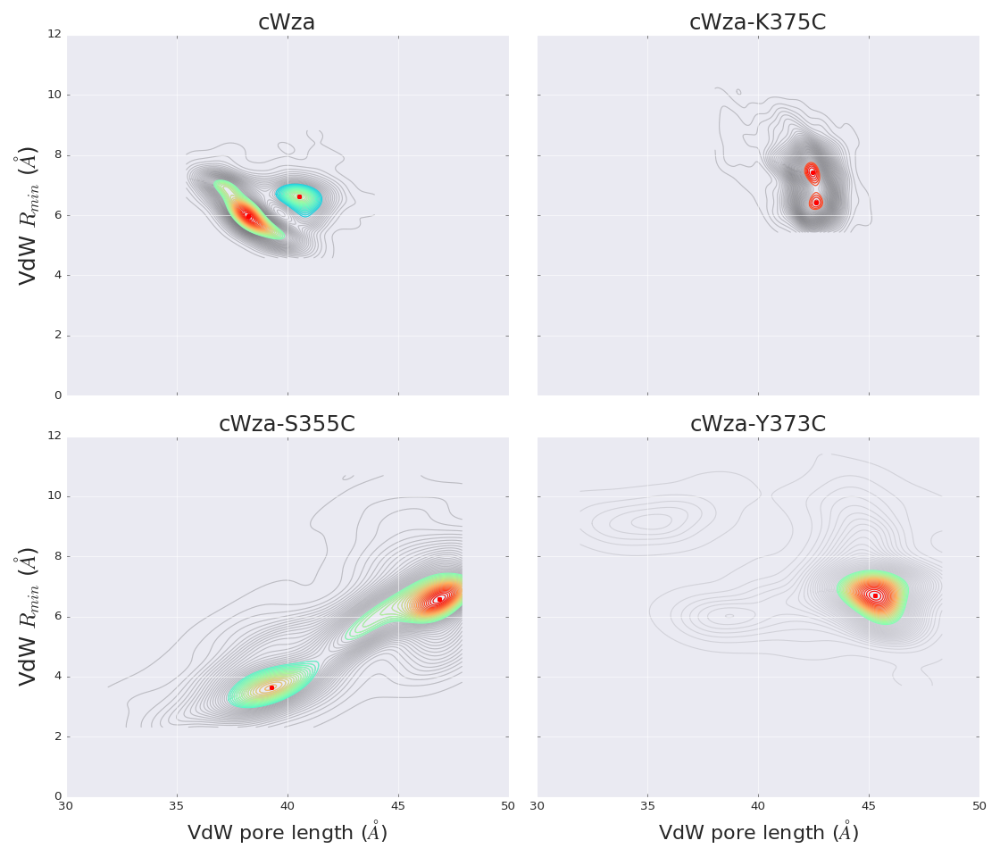

In [56]:
fig, ax = plt.subplots(2,2, figsize=(14,12),sharex=True,sharey=True)

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

labels = {
    'cWza':("","VdW $R_{min}$ ($\AA$)",""),
    'cWza-K375C':("","","probability density"),
    'cWza-S355C':("VdW pore length ($\AA$)","VdW $R_{min}$ ($\AA$)",""),
    'cWza-Y373C':("VdW pore length ($\AA$)","","probability density")
}

cmap = plt.get_cmap('rainbow')

for i in range(n_mutants):
    mutant = mutant_names[i]
    norm = Norm_maps[mutant]
    for n0 in range(len(maxima_mutants[mutant])):
        for i in range(len(Contours_filtred[mutant][n0])):
            if max(ContoursProb_filtred[mutant][n0]) > 0.02:
                contour = Contours_filtred[mutant][n0][i]
                X,Y = contour.T
                axes[mutant].plot(X,Y,c=CS.cmap(norm(ContoursProb_filtred[mutant][n0][i])),zorder=5)
                #####
                x,y = maxima_mutants[mutant][n0]
                axes[mutant].scatter(x,y,s=10,marker='o',color='red',zorder=10)

            else:
                pass
    cb = CBs_mutants[mutant]
    cb.drawedges
    l1,l2,l3 = labels[mutant]
    CBs_mutants[mutant].set_label(l3,fontsize=18)

for i in range(n_mutants):
    mutant = mutant_names[i]
    for contour in Contours_mutants[mutant]:
        X,Y = contour.T
        axes[mutant].plot(X,Y,color='black',alpha=0.1,zorder = 0)
    ##############################################
    # Customise plot
    axes[mutant].set_title(mutant, fontsize=22)
    axes[mutant].tick_params(axis='both',direction='in')
    l1,l2,l3 = labels[mutant]
    axes[mutant].set_xlabel(l1,fontsize=20)
    axes[mutant].set_ylabel(l2,fontsize=22)
#     CB.set_label(l3,fontsize=18)

plt.tight_layout()
plt.show()

In [57]:
pd.DataFrame(Conformations,columns=mutant_names,index=['Narrow','Wide','Single'])

,cWza,cWza-K375C,cWza-S355C,cWza-Y373C
Narrow,"(38.2388313213, 5.96939759964)","(42.6309106965, 6.42164032842)","(39.2838957994, 3.6396426309)",NaN
Wide,"(40.5582458845, 6.61623798927)","(42.4464093674, 7.43420785531)","(46.8532066813, 6.57534079583)",NaN
Single,NaN,NaN,NaN,"(45.2750250307, 6.69590032053)"


In [67]:
Filtered_PDBs = {}
Filtered_IDs = {}

for i in range(n_mutants):
    mutant = mutant_names[i]
    n_maxima = len(maxima_mutants[mutant])
    Filtered_PDBs[mutant] = {}
    Filtered_IDs[mutant] = {}
    ############################
    IDs = [id for id in S_mutants[mutant].keys()]
    for n in range(n_maxima):
        Filtered_IDs[mutant][n] = itemgetter(*Filtered_Indices[mutant][n])(IDs)
        PDB_names = session.query(
                Tags.pdb_name).filter_by(
                mutant = mutant).filter(
                Tags.id.in_(Filtered_IDs[mutant][n])).all()
        PDB_names = [x[0] for x in PDB_names]
        Filtered_PDBs[mutant][n] = PDB_names

In [105]:
for mutant in mutant_names:
    confn = list(Filtered_IDs[mutant].keys())
    for n0 in confn:
        new_key = 'conformation'+str(n0)
        Filtered_IDs[mutant][new_key] = Filtered_IDs[mutant].pop(n0)

Save data in JSON file

In [107]:
with open(path0+'filtered_ids_new.json','w') as fp:
    json.dump(Filtered_IDs, fp, sort_keys=True, indent=4)

Recover data

In [96]:
import json
with open(path0+'filtered_ids_new.json','r') as fp:
    Filtered_IDs = json.load(fp)

# pre-MD (docked)

## Rigid body analysis

### Backbone unit orientation

<IPython.core.display.Javascript object>


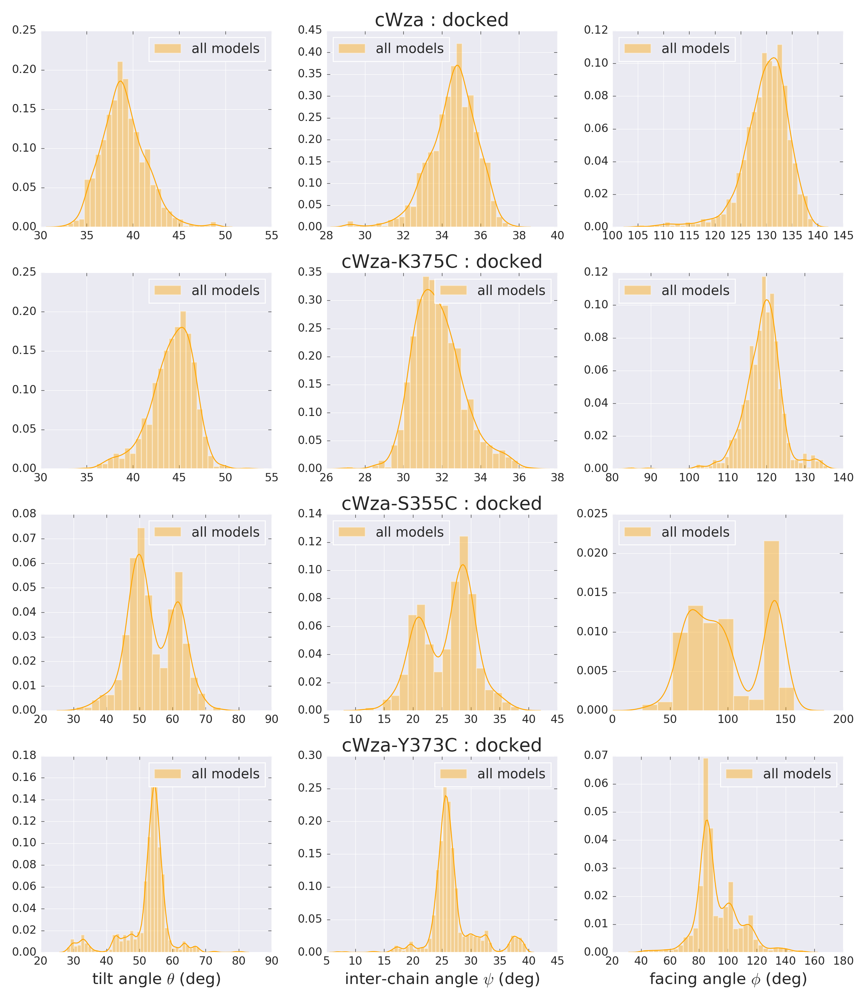

In [88]:
n_mutants = len(mutant_names)
f_hist, ax = plt.subplots(n_mutants,3,figsize=(13,15),dpi=200)

Colors = {
    'None':'orange'
}

xlabels = [
    "tilt angle $\\theta$ (deg)",
    "inter-chain angle $\\psi$ (deg)",
    "facing angle $\\phi$ (deg)"
]

for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    group = 'None'
    Theta = []; Psi = []; Phi = []
    # Create lists for radial metrics
    model_ids = [x[0] for x in session.query(Tags.id).filter_by(mutant = mutant)]
    for j in range(len(model_ids)):
        id = model_ids[j]
        euler_angles = session.query(RigidBody.euler_angles).filter_by(id = id).all()[0][0]
        theta_per_chain, psi_per_chain_pair, phi_per_chain = euler_angles
        ###########################################
        Theta.append( numpy.mean(theta_per_chain) )
        Psi.append( numpy.mean(psi_per_chain_pair) )
        Phi.append( numpy.mean(phi_per_chain) )

    sns.distplot(Theta,color=Colors[group],label='all models',ax=ax[i,0])
    sns.distplot(Psi,color=Colors[group],label='all models',ax=ax[i,1])
    sns.distplot(Phi,color=Colors[group],label='all models',ax=ax[i,2])

    ax[i,1].set_title(mutant+' : docked',fontsize=20)
        
f_hist.subplots_adjust(hspace=0.3)
   
for i in range(3):
    ax[-1,i].set_xlabel(xlabels[i],fontsize=17)
    for k in range(len(mutant_names)):
        ax[k,i].tick_params(axis='both',direction='in')
        ax[k,i].legend(loc='best')
    
f_hist.tight_layout()
plt.show()

### Conformational separation

<IPython.core.display.Javascript object>


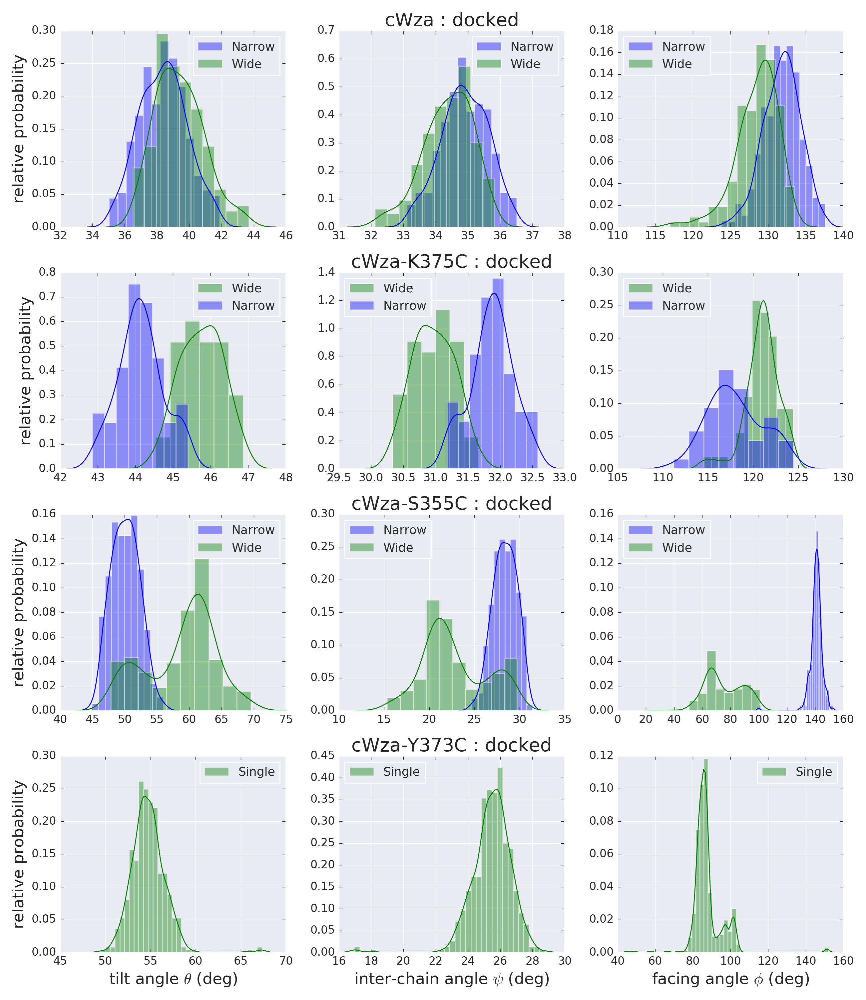

In [102]:
import seaborn as sns
sns.set_style('darkgrid')

n_mutants = len(mutant_names)
f_hist, ax = plt.subplots(n_mutants,3,figsize=(13,15),dpi=200)

xlabels = [
    "tilt angle $\\theta$ (deg)",
    "inter-chain angle $\\psi$ (deg)",
    "facing angle $\\phi$ (deg)"
]

Colors = {
    'cWza':{'Narrow':'blue', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'green', 'Wide':'blue'},
    'cWza-S355C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single']
}

# MyTags  = [
#     json.dumps(['cWza', 'conformation0']),
#     json.dumps(['cWza', 'conformation1']),
#     json.dumps(['cWza-K375C', 'conformation0']),
#     json.dumps(['cWza-K375C', 'conformation1']),
#     json.dumps(['cWza-S355C', 'conformation0']),
#     json.dumps(['cWza-S355C', 'conformation1']),
#     json.dumps(['cWza-Y373C', 'conformation0'])
# ]



for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    n_maxima = len(maxima_mutants[mutant])
    for n in range(n_maxima):
        conformation = Conformations[mutant][n]
        Theta = []; Psi = []; Phi = []
        # Create lists for radial metrics
        model_ids = Filtered_IDs[mutant]['conformation'+str(n)]
        for j in range(len(model_ids)):
            id = model_ids[j]
            euler_angles = session.query(RigidBody.euler_angles).filter_by(id = id).all()[0][0]
            theta_per_chain, psi_per_chain_pair, phi_per_chain = euler_angles
            ###########################################
            Theta.append( numpy.mean(theta_per_chain) )
            Psi.append( numpy.mean(psi_per_chain_pair) )
            Phi.append( numpy.mean(phi_per_chain) )
        ###########################################
        if mutant == 'cWza-K375C' and n == 0:
            mylabel = 'Wide'
        elif mutant == 'cWza-K375C' and n == 1:
            mylabel = 'Narrow'
        else:
            mylabel = conformation
        sns.distplot(Theta,color=Colors[mutant][conformation],ax=ax[i,0],label = mylabel)
        sns.distplot(Psi,color=Colors[mutant][conformation],ax=ax[i,1],label = mylabel)
        sns.distplot(Phi,color=Colors[mutant][conformation],ax=ax[i,2],label = mylabel)
        #
        ax[i,0].tick_params(axis='both',direction='in')
        ax[i,1].tick_params(axis='both',direction='in')
        ax[i,2].tick_params(axis='both',direction='in')
    #
    ax[i,1].set_title(mutant+' : docked',fontsize=20)
    ax[i,0].set_ylabel('relative probability',fontsize=17)
    #
    ax[i,0].legend(loc='best',fontsize=13)
    ax[i,1].legend(loc='best',fontsize=13)
    ax[i,2].legend(loc='best',fontsize=13)
    
f_hist.subplots_adjust(hspace=0.3)
   
for i in range(3):
    ax[-1,i].set_xlabel(xlabels[i],fontsize=17)
#     ax[0,i].legend(loc='best',fontsize=15)
    
#     ax[0,i].legend(loc='best')
plt.tight_layout()
plt.show()

### Unit radial profiles

<IPython.core.display.Javascript object>


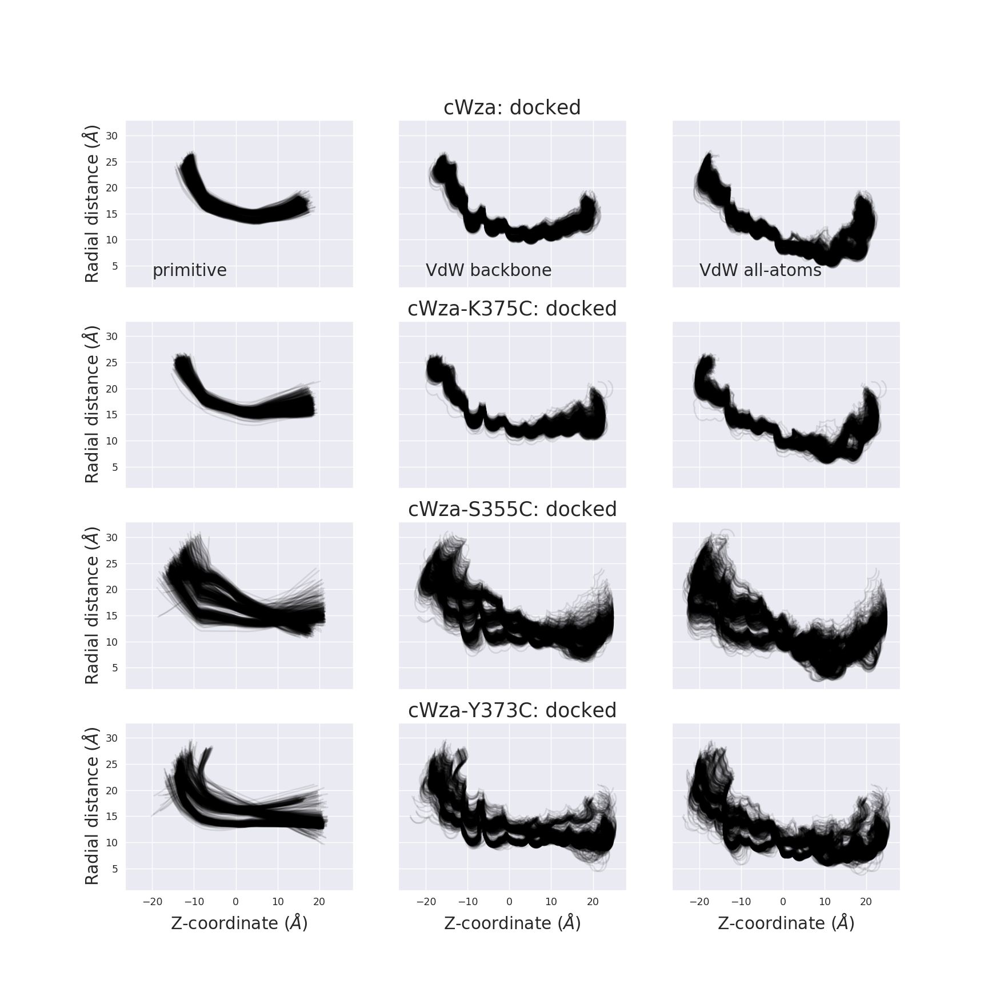

In [22]:
ProfileTypes = {
        'primitive':RadialProfiles.primitive,
        'VdW backbone':RadialProfiles.vdw_bb_lower,
        'VdW all-atoms':RadialProfiles.vdw_aa_lower
}

Labels = {
        'primitive':RadialProfiles.primitive,
        'VdW backbone':RadialProfiles.vdw_bb_lower,
        'VdW all-atoms':RadialProfiles.vdw_aa_lower
}

n_rows = len(mutant_names)
n_cols = len(ProfileTypes.keys())
fig, ax = plt.subplots(n_rows,n_cols,figsize=(14,14),sharex=True,sharey=True)

Colors = {
    'None':{'primitive':'black','VdW backbone':'black','VdW all-atoms':'black'}
}


N_models = {}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    N_models[mutant] = {}
    model_ids = [x[0] for x in session.query(Tags.id).filter_by(mutant = mutant)]
    N_models[mutant][group] = len(model_ids)
    for j in range(N_models[mutant][group]):
        id = model_ids[j]
        ###############################
        c = 0
        for key in ['primitive','VdW backbone','VdW all-atoms']:
            profile = session.query(ProfileTypes[key]).filter_by(id = id).all()[0][0]
            X,Y = profile
            ax[i][c].plot(X,Y,c=Colors[group][key],alpha=0.1)
            c += 1
#         ax[i][].plot(X,Y,c=Colors[group][key],label=group,alpha=0.1)
        
        
for n in range(n_rows):
    ax[n][0].set_ylabel('Radial distance ($\AA$)',fontsize=17)
    ax[n][1].set_title(mutant_names[n]+': docked',fontsize=20)
    
for n in range(n_cols):
#     ax[0][n].legend(loc = 'best')
    ax[0][n].text(-20,3,['primitive','VdW backbone','VdW all-atoms'][n], fontsize=17)
    ax[-1][n].set_xlabel('Z-coordinate ($\AA$)',fontsize=17)
        
plt.show()

### Conformational separation

<IPython.core.display.Javascript object>


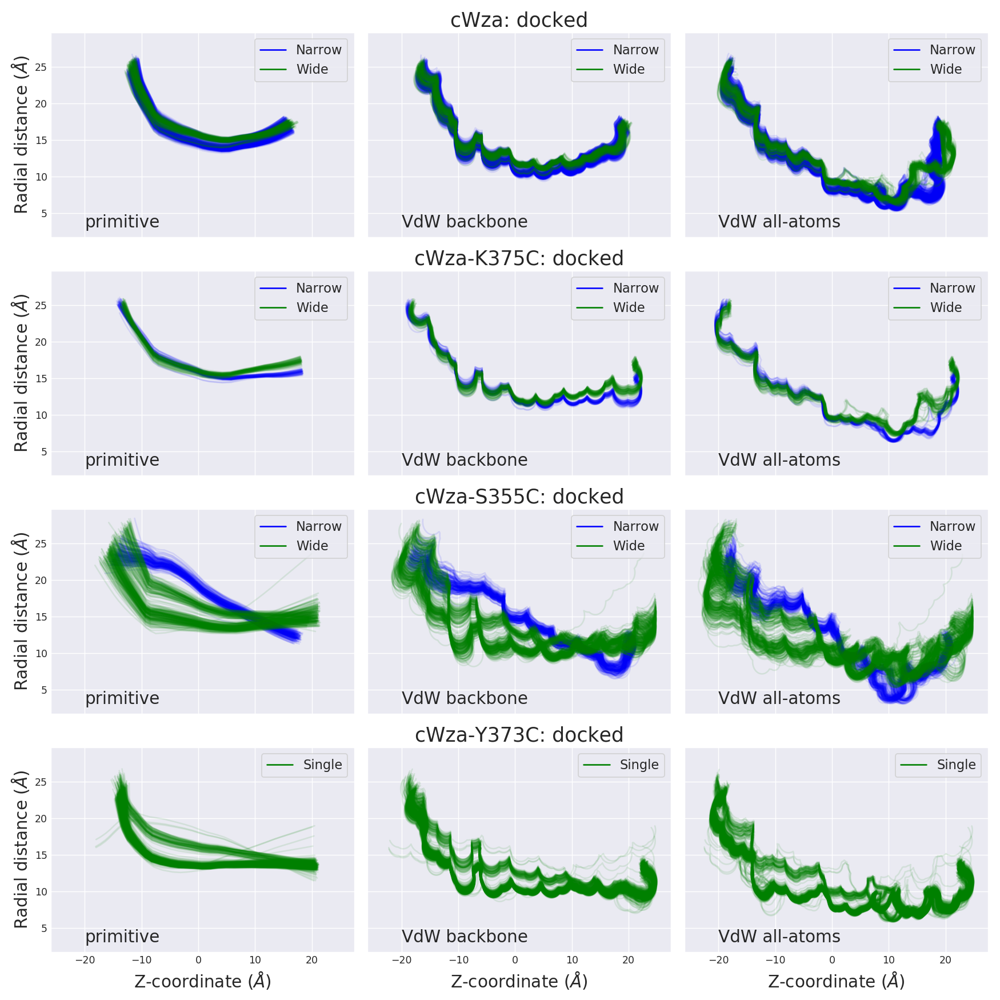

In [126]:
ProfileTypes = {
        'primitive':RadialProfiles.primitive,
        'VdW backbone':RadialProfiles.vdw_bb_lower,
        'VdW all-atoms':RadialProfiles.vdw_aa_lower
}

Labels = {
        'primitive':RadialProfiles.primitive,
        'VdW backbone':RadialProfiles.vdw_bb_lower,
        'VdW all-atoms':RadialProfiles.vdw_aa_lower
}

n_rows = len(mutant_names)
n_cols = len(ProfileTypes.keys())
fig, ax = plt.subplots(n_rows,n_cols,figsize=(14,14),sharex=True,sharey=True)

Colors = {
    'cWza':{'Narrow':'blue', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single']
}

N_models = {}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    N_models[mutant] = {}
    n_maxima = len(maxima_mutants[mutant])
    for n in range(n_maxima):
        conformation = Conformations[mutant][n]
        model_ids = Filtered_IDs[mutant][n]
        N_models[mutant][n] = len(model_ids)
        for j in range(N_models[mutant][n]):
            id = model_ids[j]
            ###############################
            c = 0
            for key in ProfileTypes.keys():
                profile = session.query(ProfileTypes[key]).filter_by(id = id).all()[0][0]
                X,Y = profile
                ax[i][c].plot(X,Y,c=Colors[mutant][conformation],alpha=0.1)
                c += 1
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    for j in range(n_cols):
        for n in range(len(maxima_mutants[mutant])):
            conformation = Conformations[mutant][n]
            ax[i,j].plot([],[],color=Colors[mutant][conformation],label=conformation)
                    
for n in range(n_rows):
    ax[n][0].set_ylabel('Radial distance ($\AA$)',fontsize=17)
    ax[n][1].set_title(mutant_names[n]+': docked',fontsize=20)

for n in range(n_cols):
#     ax[0][n].text(-20,3,list(ProfileTypes.keys())[n], fontsize=17)
    ax[-1][n].set_xlabel('Z-coordinate ($\AA$)',fontsize=17)
    for m in range(n_mutants):
        ax[m,n].text(-20,3,list(ProfileTypes.keys())[n], fontsize=17)
        ax[m,n].tick_params(axis='both',direction='in')
        ax[m,n].legend(loc = 'upper right',fontsize=13)
        

plt.tight_layout()
plt.show()

## Radial profile analysis

### Unclassified: Primitive profiles

<IPython.core.display.Javascript object>


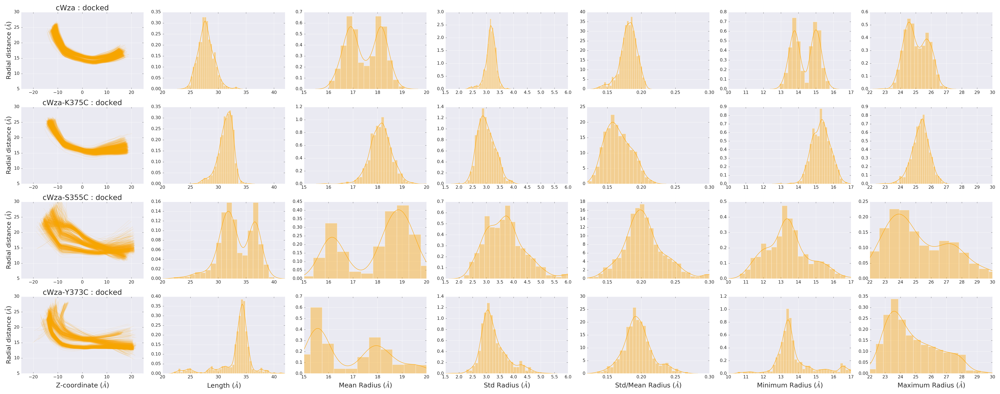

In [104]:
import seaborn as sns

n_rows = len(mutant_names)
metrics = ['length','mean','std','cv','min','max']
n_cols = len(metrics)+1

Colors = {
    'None':{'primitive':'orange','VdW_BB':'orange','VdW_AA':'orange'}
}

xlims = [
    [-25,25],
    [20,42],
    [15,20],
    [1.5,6],
    [0.12,0.3],
    [10,17],
    [22,30]
]

fig, ax = plt.subplots(n_rows,n_cols,figsize=(38,15),dpi=200)

Groups = ['None']

R_metrics = {}
N_models = {}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    N_models[mutant] = {}
    ###############################
    R_metrics[mutant] = {}
    for group in Groups:
        # Create lists for radial metrics
        R_metrics[mutant][group] = {}
        for key in metrics:
            R_metrics[mutant_names[i]][group][key] = []
        ###############################
        model_ids = [x[0] for x in session.query(Tags.id).filter_by(mutant = mutant, group = group)]
        N_models[mutant][group] = len(model_ids)
        for j in range(N_models[mutant][group]):
            id = model_ids[j]
            primitive_profile = session.query(RadialProfiles.primitive).filter_by(id = id).all()[0][0]
            X,Y = primitive_profile
            ax[i,0].plot(X,Y,c=Colors[group]['primitive'],alpha=0.1)
            for key in metrics:
                if key != 'length':
                    S = Y
                else:
                    S = X
                R_metrics[mutant][group][key].append(compute_radial_metrics(S,key))
        for k in range(len(metrics)):
            X = R_metrics[mutant][group][metrics[k]]
            sns.distplot(X,color=Colors[group]['primitive'],ax=ax[i,k+1])
#             ax[i][k+1].hist(X,bins=30,weights=weights4hist(X),color=Colors[group]['primitive'],alpha=0.75)

for n in range(n_rows):
    ax[n,0].set_ylabel("Radial distance ($\AA$)",fontsize=17)
    ax[n,0].set_title(mutant_names[n]+" : docked",fontsize=20)
    ax[n,0].set_ylim(5,30)
    for k in range(n_cols):
        ax[n,k].tick_params(axis='both',direction='in')
        x0,x1 = xlims[k]
        ax[n,k].set_xlim(x0,x1)

xlabels = [
    "Z-coordinate ($\AA$)",
    "Length ($\AA$)",
    "Mean Radius ($\AA$)",
    "Std Radius ($\AA$)",
    "Std/Mean Radius ($\AA$)",
    "Minimum Radius ($\AA$)",
    "Maximum Radius ($\AA$)"
]

for n in range(n_cols):
    ax[-1,n].set_xlabel(xlabels[n],fontsize=18)

fig.tight_layout()
plt.show()

### Conformational separation

<IPython.core.display.Javascript object>


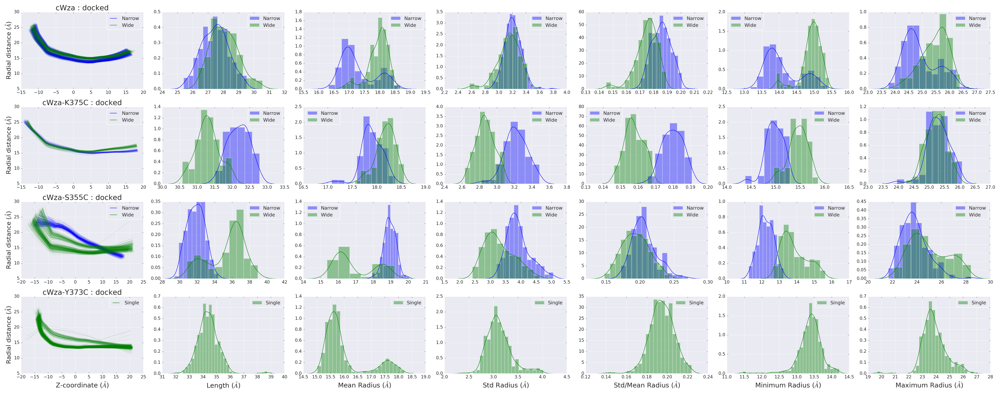

In [109]:
import seaborn as sns

n_rows = len(mutant_names)
metrics = ['length','mean','std','cv','min','max']
n_cols = len(metrics)+1

Colors = {
    'cWza':{'Narrow':'blue', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single']
}

xlims = [
    [-25,25],
    [20,42],
    [15,20],
    [1.5,6],
    [0.12,0.3],
    [10,17],
    [22,30]
]

fig, ax = plt.subplots(n_rows,n_cols,figsize=(38,15),dpi=200)

R_metrics = {}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    R_metrics[mutant] = {}
    n_maxima = len(maxima_mutants[mutant])
    for n in range(n_maxima):
        conformation = Conformations[mutant][n]
        R_metrics[mutant][n] = {}
        # Create lists for radial metrics
        model_ids = Filtered_IDs[mutant]['conformation'+str(n)]
        for key in metrics:
            R_metrics[mutant][n][key] = []
        for j in range(len(model_ids)):
            id = model_ids[j]
            primitive_profile = session.query(RadialProfiles.primitive).filter_by(id = id).all()[0][0]
            X,Y = primitive_profile
            ax[i,0].plot(X,Y,c=Colors[mutant][conformation],alpha=0.1)
            for key in metrics:
                if key != 'length':
                    S = Y
                else:
                    S = X
                R_metrics[mutant][n][key].append(compute_radial_metrics(S,key))
        for k in range(len(metrics)):
            X = R_metrics[mutant][n][metrics[k]]
            sns.distplot(X,color=Colors[mutant][conformation],ax=ax[i,k+1],label=conformation)

for n in range(n_rows):
    ax[n,0].set_ylabel("Radial distance ($\AA$)",fontsize=17)
    ax[n,0].set_title(mutant_names[n]+" : docked",fontsize=20)
    ax[n,0].set_ylim(5,30)
    for k in range(n_cols):
        ax[n,k].tick_params(axis='both',direction='in')
#         x0,x1 = xlims[k]
#         ax[n][k].set_xlim(x0,x1)

xlabels = [
    "Z-coordinate ($\AA$)",
    "Length ($\AA$)",
    "Mean Radius ($\AA$)",
    "Std Radius ($\AA$)",
    "Std/Mean Radius ($\AA$)",
    "Minimum Radius ($\AA$)",
    "Maximum Radius ($\AA$)"
]

for n in range(n_cols):
    ax[-1,n].set_xlabel(xlabels[n],fontsize=18)

    
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    for j in range(n_cols):
        for n in range(len(maxima_mutants[mutant])):
            conformation = Conformations[mutant][n]
            ax[i,0].plot([],[],color=Colors[mutant][conformation],label=conformation)
        ax[i,j].tick_params(axis='both',direction='in')
        ax[i,j].legend(loc='best',fontsize=13)
                
fig.tight_layout()
plt.show()

### Unclassified: VdW profiles

<IPython.core.display.Javascript object>


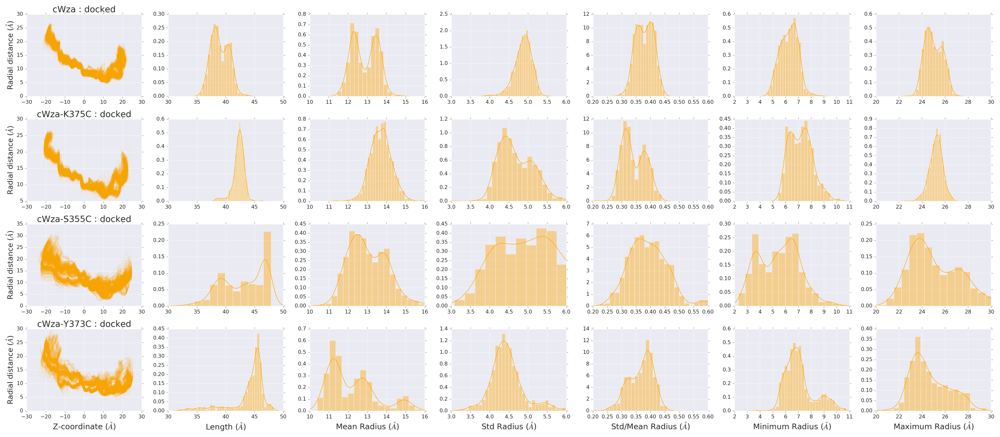

In [105]:
n_rows = len(mutant_names)
metrics = ['length','mean','std','cv','min','max']
n_cols = len(metrics)+1

ProfileTypes = {
            'primitive':RadialProfiles.primitive,
#             'VdW_BB':RadialProfiles.vdw_bb
            'VdW_AA':RadialProfiles.vdw_aa_lower
}

Colors = {
    'None':{'primitive':'orange','VdW_BB':'orange','VdW_AA':'orange'}
}
 
xlims = [
    [-30,30],
    [30,50],
    [10,16],
    [3,6],
    [0.2,0.6],
    [2,11],
    [20,30]
]

fig, ax = plt.subplots(n_rows,n_cols,figsize=(32,14),dpi=200)

Groups = ['None']

R_metrics = {}
N_models = {}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    N_models[mutant] = {}
    ###############################
    R_metrics[mutant] = {}
    for group in Groups:
        # Create lists for radial metrics
        R_metrics[mutant][group] = {}
        for key in metrics:
            R_metrics[mutant_names[i]][group][key] = []
        ###############################
        model_ids = [x[0] for x in session.query(Tags.id).filter_by(mutant = mutant, group = group)]
        N_models[mutant][group] = len(model_ids)
        for j in range(N_models[mutant][group]):
            id = model_ids[j]
            primitive_profile = session.query(RadialProfiles.primitive).filter_by(id = id).all()[0][0]
            vdw_profile = session.query(RadialProfiles.vdw_aa_lower).filter_by(id = id).all()[0][0]
            X,Y = vdw_profile
            ax[i,0].plot(X,Y,c=Colors[group]['VdW_AA'],alpha=0.1)
            for key in metrics:
                if key != 'length':
                    S = Y
                else:
                    S = X
                R_metrics[mutant][group][key].append(compute_radial_metrics(S,key))
        for k in range(len(metrics)):
            X = R_metrics[mutant][group][metrics[k]]
            sns.distplot(X,color=Colors[group]['VdW_AA'],ax=ax[i,k+1])
#             ax[i][k+1].hist(X,bins=30,weights=weights4hist(X),color=Colors[group]['VdW_AA'],alpha=0.75)

for n in range(n_rows):
    ax[n,0].set_ylabel("Radial distance ($\AA$)",fontsize=17)
    ax[n,0].set_title(mutant_names[n]+" : docked" ,fontsize=20)
    for k in range(n_cols):
        x0,x1 = xlims[k]
        ax[n,k].set_xlim(x0,x1)

xlabels = [
    "Z-coordinate ($\AA$)",
    "Length ($\AA$)",
    "Mean Radius ($\AA$)",
    "Std Radius ($\AA$)",
    "Std/Mean Radius ($\AA$)",
    "Minimum Radius ($\AA$)",
    "Maximum Radius ($\AA$)"
]

for n in range(len(xlabels)):
    ax[-1,n].set_xlabel(xlabels[n],fontsize=18)
            
fig.tight_layout()
plt.show()

### Conformational separation

<IPython.core.display.Javascript object>


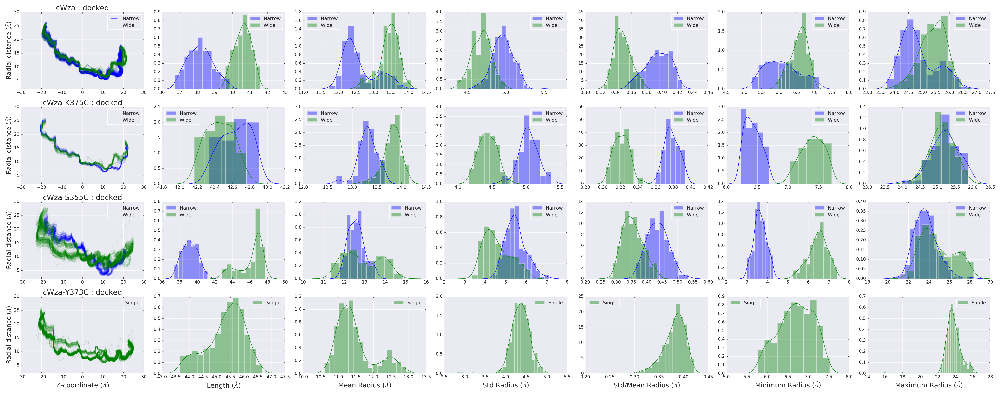

In [111]:
import seaborn as sns

n_rows = len(mutant_names)
metrics = ['length','mean','std','cv','min','max']
n_cols = len(metrics)+1

Colors = {
    'cWza':{'Narrow':'blue', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single']
}

xlims = [
    [-25,25],
    [20,42],
    [15,20],
    [1.5,6],
    [0.12,0.3],
    [10,17],
    [22,30]
]

fig, ax = plt.subplots(n_rows,n_cols,figsize=(38,15),dpi=200)

R_metrics = {}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    R_metrics[mutant] = {}
    n_maxima = len(maxima_mutants[mutant])
    for n in range(n_maxima):
        conformation = Conformations[mutant][n]
        R_metrics[mutant][n] = {}
        # Create lists for radial metrics
        model_ids = Filtered_IDs[mutant]['conformation'+str(n)]
        for key in metrics:
            R_metrics[mutant][n][key] = []
        for j in range(len(model_ids)):
            id = model_ids[j]
            vdw_profile = session.query(RadialProfiles.vdw_aa_lower).filter_by(id = id).all()[0][0]
            X,Y = vdw_profile
            ax[i,0].plot(X,Y,c=Colors[mutant][conformation],alpha=0.1)
            for key in metrics:
                if key != 'length':
                    S = Y
                else:
                    S = X
                R_metrics[mutant][n][key].append(compute_radial_metrics(S,key))
        for k in range(len(metrics)):
            X = R_metrics[mutant][n][metrics[k]]
            sns.distplot(X,color=Colors[mutant][conformation],ax=ax[i,k+1],label=conformation)

for n in range(n_rows):
    ax[n,0].set_ylabel("Radial distance ($\AA$)",fontsize=17)
    ax[n,0].set_title(mutant_names[n]+" : docked",fontsize=20)
    ax[n,0].set_ylim(2,30)
    for k in range(n_cols):
        ax[n,k].tick_params(axis='both',direction='in')
#         x0,x1 = xlims[k]
#         ax[n][k].set_xlim(x0,x1)

xlabels = [
    "Z-coordinate ($\AA$)",
    "Length ($\AA$)",
    "Mean Radius ($\AA$)",
    "Std Radius ($\AA$)",
    "Std/Mean Radius ($\AA$)",
    "Minimum Radius ($\AA$)",
    "Maximum Radius ($\AA$)"
]

for n in range(n_cols):
    ax[-1,n].set_xlabel(xlabels[n],fontsize=18)

    
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    for j in range(n_cols):
        for n in range(len(maxima_mutants[mutant])):
            conformation = Conformations[mutant][n]
            ax[i,0].plot([],[],color=Colors[mutant][conformation],label=conformation)
        ax[i,j].tick_params(axis='both',direction='in')
        ax[i,j].legend(loc='best',fontsize=13)
                
fig.tight_layout()
plt.show()

## Interchain interaction analysis

### Superbasis of interactions

In [248]:
# Extract all base interactions, all types
S_inter = {}
S_inter['hbonds'] = set()
S_inter['kihs'] = set()
dbtag = {
    'hbonds': Interhelix_Interactions.hbonds,
    'kihs': Interhelix_Interactions.kihs
}

for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    model_ids = [x[0] for x in session.query(Tags.id).filter_by(mutant = mutant)]
    for j in range(len(model_ids)):
        id = model_ids[j]
        for interaction_type in ['hbonds','kihs']:
            data = session.query(dbtag[interaction_type]).filter_by(id=id).first()[0]
            S_inter[interaction_type] = S_inter[interaction_type].union(set(data))
            
# Sort base interactions by residue number            
for interaction_type in ['hbonds','kihs']:
    X = S_inter[interaction_type]
    Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in list(X)]]
    S_inter_ordered = []
    for resn in range(1,33):
        for y in set(Y):
            x = json.loads(y)
            if int(x[0]) == resn:
                S_inter_ordered.append(json.dumps(x))
    S_inter[interaction_type] = S_inter_ordered

In [249]:
print("Total number of identified OH-atom pairs: ",len(S_inter['hbonds']))
print("Total number of identified KIHs: ",len(S_inter['kihs']))

Total number of identified OH-atom pairs:  48
Total number of identified KIHs:  77


### Interaction data extraction, stats, and interchain-interaction probability

In [250]:
dbtag = {
    'hbonds': Interhelix_Interactions.hbonds,
    'kihs': Interhelix_Interactions.kihs
}

mutant_interaction_data = {}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    mutant_interaction_data[mutant] = {}
    for interaction_type in ['hbonds','kihs']:
        mutant_interaction_data[mutant][interaction_type] = {}
        model_ids = [x[0] for x in session.query(Tags.id).filter_by(mutant = mutant)]
        for j in range(len(model_ids)):
            id = model_ids[j]
            data = session.query(dbtag[interaction_type]).filter_by(id=id).first()[0]
            mutant_interaction_data[mutant][interaction_type][id] = data

mutant_interaction_stats = {}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    mutant_interaction_stats[mutant] = {}
    for interaction_type in ['hbonds','kihs']:        
        mutant_interaction_stats[mutant][interaction_type] = {}
        data = mutant_interaction_data[mutant][interaction_type]
        for id in list(data.keys()):
            decomposition_vector = []
            for s in S_inter[interaction_type]:
                counter = 0
                for x in data[id]:
                    x_raw = json.loads(x)
                    y = json.dumps(x_raw[:-1]+[interaction_direction(x_raw[-1])])
                    if y == s:
                        counter +=1
                decomposition_vector.append(counter)
            mutant_interaction_stats[mutant][interaction_type][id] = decomposition_vector

N_chains = 8
probability_data_raw = {}
for interaction_type in ['hbonds','kihs']:
    probability_data_raw[interaction_type] = []
    Sx = S_inter[interaction_type]
    for i in range(len(mutant_names)):
        mutant = mutant_names[i]
        data = mutant_interaction_stats[mutant][interaction_type]
        N_models = 0
        X = numpy.zeros(len(Sx))
        for id in list(data.keys()):
            x = data[id]
            X = X + numpy.asarray(x)
            N_models += 1
        probability = X/float(N_chains*N_models)
        probability_data_raw[interaction_type].append(probability)

### Dimensionality reduction 

In [251]:
tolerance = 0.05
S_refined = {}
probability_data_refined = {}

for interaction_type in ['hbonds','kihs']:
    Sx = S_inter[interaction_type]
    S_refined[interaction_type] = []
    data = numpy.array(probability_data_raw[interaction_type]).T
    exclude = []
    for i in range(len(Sx)):
        comparison = data[i] >= tolerance
        if any(comparison):
            exclude.append(i)
    extracted_data = operator.itemgetter(*exclude)(data)
    S_refined[interaction_type] = operator.itemgetter(*exclude)(Sx)
    probability_data_refined[interaction_type] = []
    for k in range(len(mutant_names)):
        X = probability_data_raw[interaction_type][k]
        probability_data_refined[interaction_type].append(operator.itemgetter(*exclude)(X))

In [252]:
S_indices_excluded = {}
for interaction_type in ['hbonds','kihs']:
    S_indices_excluded[interaction_type] = \
        [list(S_inter[interaction_type]).index(s) for s in S_refined[interaction_type]]

<span style="color:red">MAKE REPORT OF TOTAL NUMBER OF INTERACTIONS, RAW AND REFINED. COMPARE NUMBERS</span>

### Conformational separation of interchain interaction probability 

In [253]:
N_chains = 8
probability_data_conformation = {}
for interaction_type in ['hbonds','kihs']:
    probability_data_conformation[interaction_type] = {}
    Sx = S_refined[interaction_type]
    for i in range(len(mutant_names)):
        mutant = mutant_names[i]
        probability_data_conformation[interaction_type][mutant] = {}
        for n0 in list(Filtered_IDs[mutant].keys()):
            model_ids = Filtered_IDs[mutant][n0]
            Y = mutant_interaction_stats[mutant][interaction_type]
            data = [itemgetter(*S_indices_excluded[interaction_type])(Y[id]) for id in  model_ids]
            N_models = 0
            X = numpy.zeros(len(Sx))
            for j in range(len(data)):
                x = data[j]
                X = X + numpy.asarray(x)
                N_models += 1
            probability = X/float(N_chains*N_models)
            probability_data_conformation[interaction_type][mutant][n0] = probability

### Data framing 

**Unclassified** models

In [254]:
import pandas as pd

S = S_refined
Data = {}
Labels = {}
df_inter = {}
df_tags = {
    'hbonds': 'HO-atoms',
    'kihs': 'KIH-atoms'
}

for interaction_type in ['hbonds','kihs']:
    # Frame data per interaction type
    Data[interaction_type] = {}
    X = []
    for i in range(len(mutant_names)):
        mutant = mutant_names[i]
        X.append(numpy.array(probability_data_refined[interaction_type][i]))
    X = numpy.array(X).T
    Data[interaction_type] = [[S[interaction_type][i]]+list(X[i]) for i in range(len(S[interaction_type]))]
    df_inter[interaction_type] = pd.DataFrame(
                                Data[interaction_type],
                                columns=[df_tags[interaction_type]]+mutant_names
                            )
    # Remake labels for base-interaction atoms
    if interaction_type == 'hbonds':
        inter_label = []
        for s in S[interaction_type]:
            ho_atoms = json.loads(s)
            inter_label.append(
                    ho_atoms[0]+'-'+ho_atoms[1]+' ||| '+ ho_atoms[2]+'-'+ho_atoms[3]+', '+str(ho_atoms[-1])
                )
        Labels[interaction_type] = inter_label
    elif interaction_type == 'kihs':
        inter_label = []
        for s in S[interaction_type]:
            kih_atoms = json.loads(s)
            knob = kih_atoms[0]
            hole = "-".join(kih_atoms[1:-1])
            direct = kih_atoms[-1]
            inter_label.append(knob+' >> '+hole+', '+str(direct))
        Labels[interaction_type] = inter_label

Data frames under **conformational separation**

In [255]:
DFs_conformation = {}
for interaction_type in ['hbonds','kihs']:
    S = S_refined[interaction_type]
    DFs_conformation[interaction_type] = {}
    for i in range(len(mutant_names)):
        mutant = mutant_names[i]
        data = probability_data_conformation[interaction_type][mutant]
        data['HO-atoms'] = S
        DFs_conformation[interaction_type][mutant] = pd.DataFrame(data)

### Unclassified: Hydrogen bonds

<IPython.core.display.Javascript object>


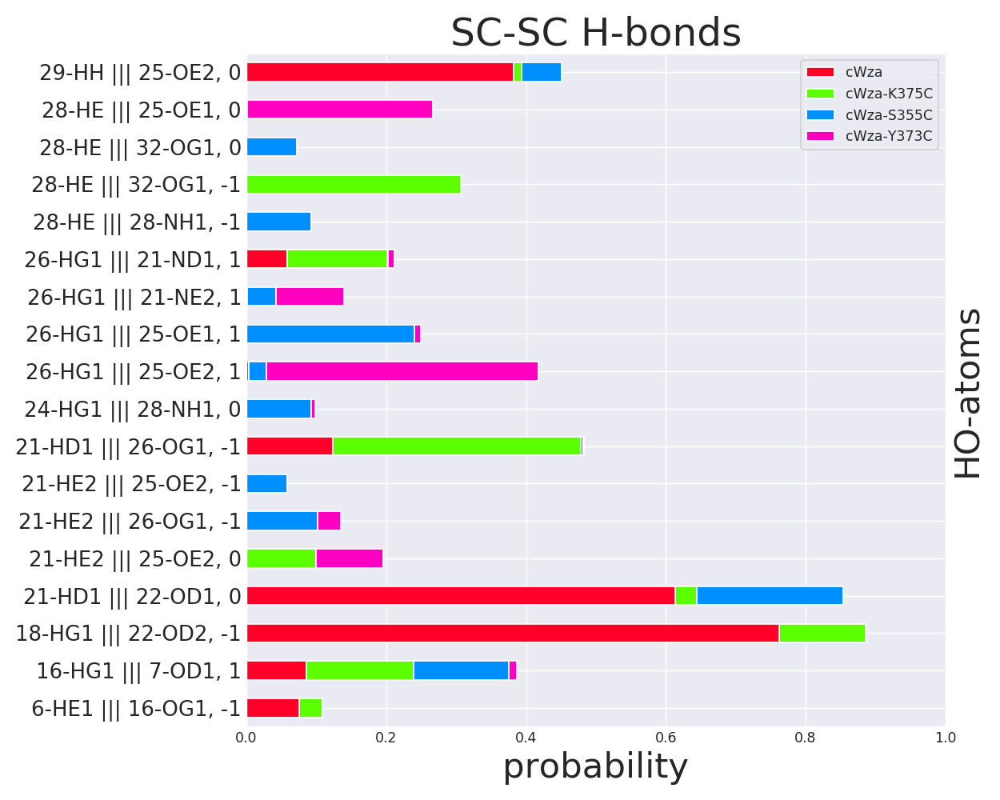

In [256]:
import seaborn as sns
fig, ax = plt.subplots(figsize=(10,8))

df_inter['hbonds'].plot(x="HO-atoms",y=mutant_names,kind="barh",stacked=True,ax=ax,colormap='gist_rainbow')
# # Add a legend and informative axis label
# ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(xlim=(0,1), ylabel="")
ax.set_xlabel("probability", fontsize=25)
ax.set_ylabel("HO-atoms", fontsize=25)
ax.yaxis.set_label_position("right")
ax.tick_params(axis='both',direction='in')
ax.set_yticklabels(Labels['hbonds'], fontsize=15)
ax.set_title("SC-SC H-bonds", fontsize=28)

fig.tight_layout()
plt.show()

### Conformational separation

<IPython.core.display.Javascript object>


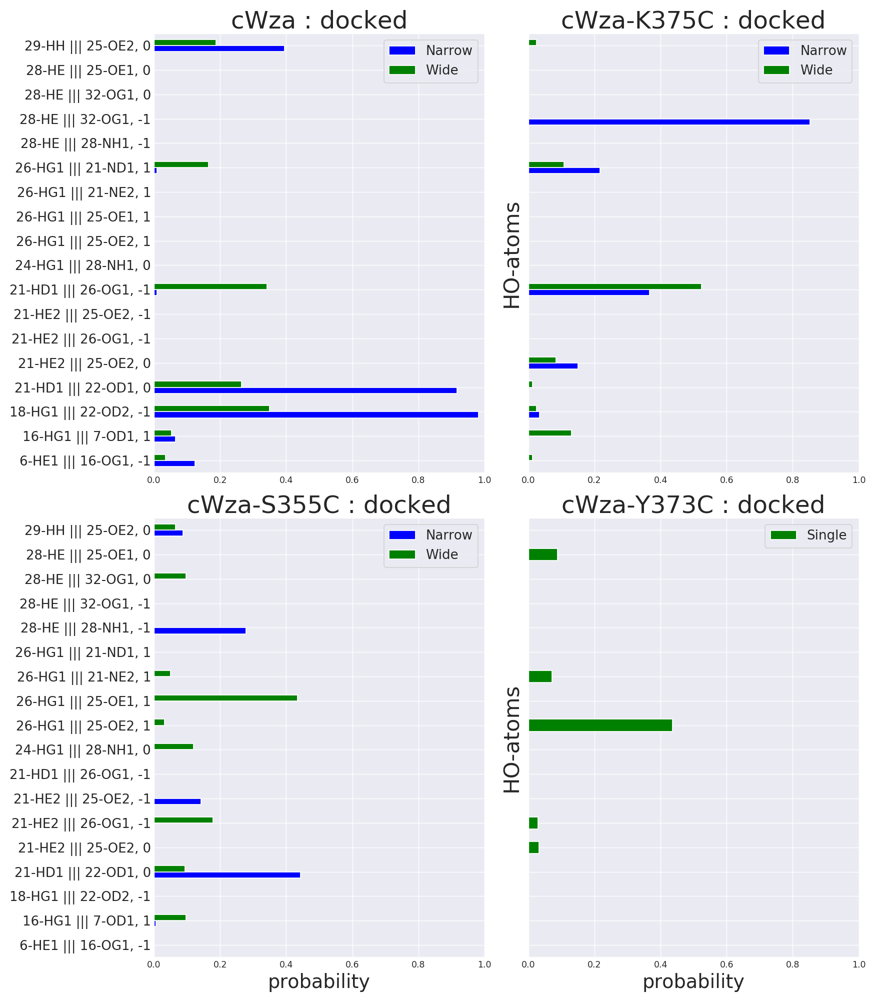

In [260]:
interaction_type = 'hbonds'
fig, ax = plt.subplots(2,2,figsize=(14,16))
sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'blue', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for i in range(n_mutants):
    mutant = mutant_names[i]
    DFs_conformation[interaction_type][mutant].plot(
#                     x=labels_inter[interaction_type],
                    kind="barh",
                    color = Colors[mutant].values(),
                    label = Conformation[mutant],
                    ax = axes[mutant]
                    )        
    axes[mutant].set(xlim=(0,1))
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)

ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel(df_tags[interaction_type], fontsize=25)
ax[1,1].set_ylabel(df_tags[interaction_type], fontsize=25)

ax[0,0].set_yticklabels(Labels[interaction_type], fontsize=15)
ax[1,0].set_yticklabels(Labels[interaction_type], fontsize=15)
ax[0,1].set_yticklabels("")
ax[1,1].set_yticklabels("")

fig.tight_layout()

plt.show()

### Unclassified: Knobs-Into-Holes

<IPython.core.display.Javascript object>


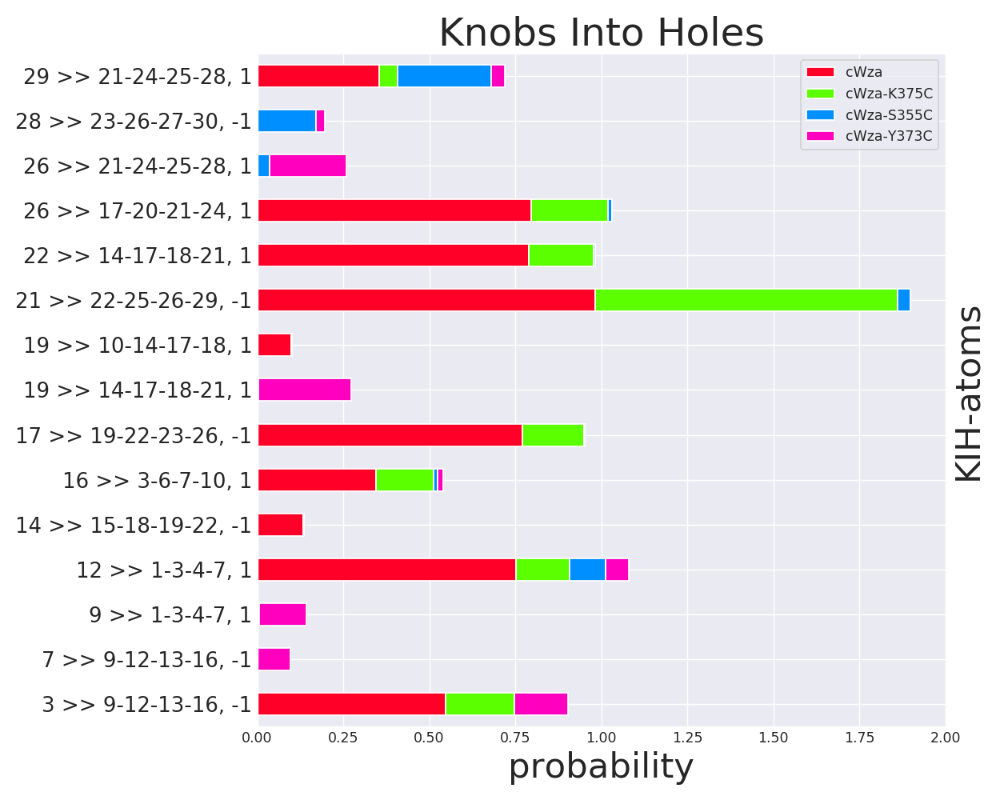

In [258]:
fig, ax = plt.subplots(figsize=(10,8))

df_inter['kihs'].plot(x="KIH-atoms",y=mutant_names,kind="barh",stacked=True,ax=ax,colormap='gist_rainbow')
# # Add a legend and informative axis label
# ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(xlim=(0,2), ylabel="KIH-atoms")
ax.set_xlabel("probability", fontsize=25)
ax.set_ylabel("KIH-atoms", fontsize=25)
ax.yaxis.set_label_position("right")
ax.tick_params(axis='both',direction='in')
ax.set_yticklabels(Labels['kihs'], fontsize=15)
ax.set_title("Knobs Into Holes", fontsize=28)

fig.tight_layout()
plt.show()

### Conformational separation

<IPython.core.display.Javascript object>


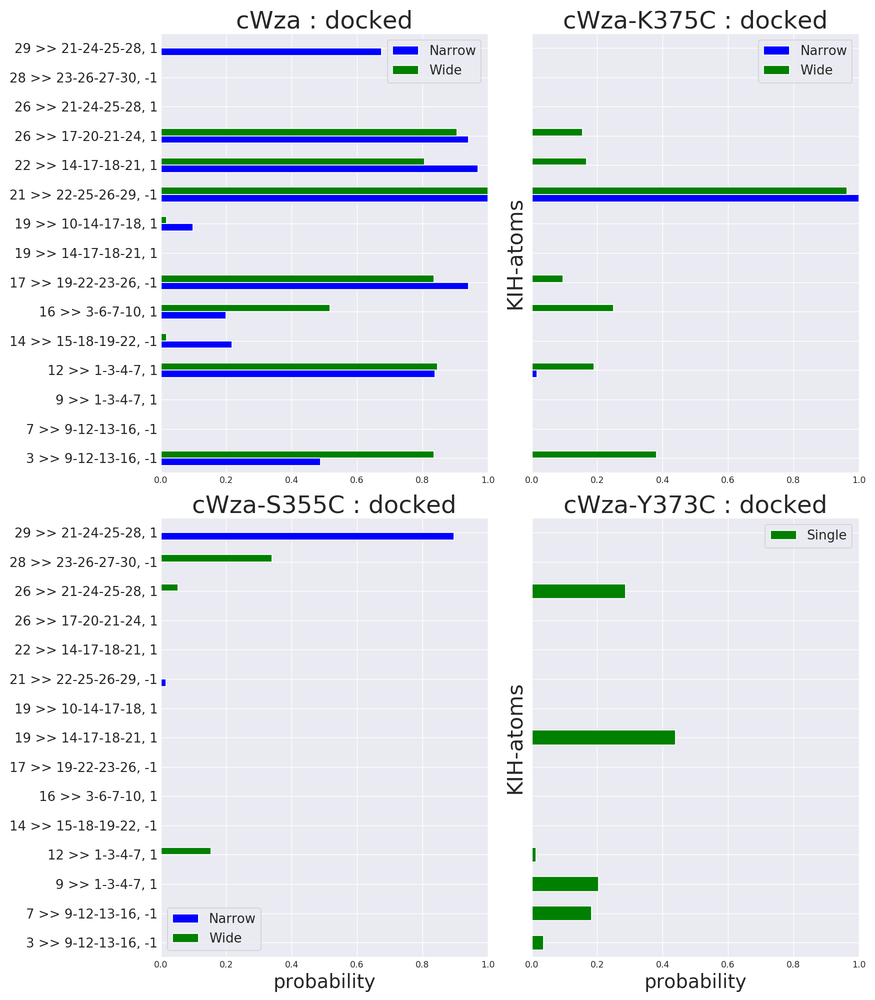

In [261]:
interaction_type = 'kihs'
fig, ax = plt.subplots(2,2,figsize=(14,16))
sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'blue', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for i in range(n_mutants):
    mutant = mutant_names[i]
    DFs_conformation[interaction_type][mutant].plot(
#                     x=labels_inter[interaction_type],
                    kind="barh",
                    color = Colors[mutant].values(),
                    label = Conformation[mutant],
                    ax = axes[mutant]
                    )        
    axes[mutant].set(xlim=(0,1))
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)

ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel(df_tags[interaction_type], fontsize=25)
ax[1,1].set_ylabel(df_tags[interaction_type], fontsize=25)

ax[0,0].set_yticklabels(Labels[interaction_type], fontsize=15)
ax[1,0].set_yticklabels(Labels[interaction_type], fontsize=15)
ax[0,1].set_yticklabels("")
ax[1,1].set_yticklabels("")

fig.tight_layout()

plt.show()

# EMMD

<span style="color:red">IMPORTANT</span>
See Notebook `Docked Models Geometry-Interaction Analysis`, were preparation for EMMD simulations was performed, for which, model ids, output tree structure, and pathway assaignment took place.

In [13]:
dbfile_emmd = path0 + 'mutants_em-conformations_geometry-interactions.db'
engine_emmd = create_engine('sqlite:///'+dbfile_emmd)
Base.metadata.bind = engine_emmd
DBSession = sessionmaker()
DBSession.bind = engine_emmd
session_emmd = DBSession()

Basic shared parameters

In [5]:
mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']
n_mutants = len(mutant_names)
path0 = '/home/ba13026/dbs/'

Colors = {
    'em-conformation0':'blue',
    'em-conformation1':'green'
}

Labels = {
    'em-conformation0':'narrow',
    'em-conformation1':'wide'
}

Conformation = {
    'cWza':{'em-conformation0': 'Narrow', 'em-conformation1': 'Wide'},
    'cWza-K375C':{'em-conformation0': 'Narrow', 'em-conformation1': 'Wide'},
    'cWza-S355C':{'em-conformation0': 'Narrow', 'em-conformation1': 'Wide'},
    'cWza-Y373C':{'em-conformation0': '', 'em-conformation1': 'Single'},
}

ProfileTypes = {
        'primitive':RadialProfiles.primitive,
        'VdW backbone':RadialProfiles.vdw_bb_lower,
        'VdW all-atoms':RadialProfiles.vdw_aa_lower
}

## Rigid body analysis

### Unit radial profiles

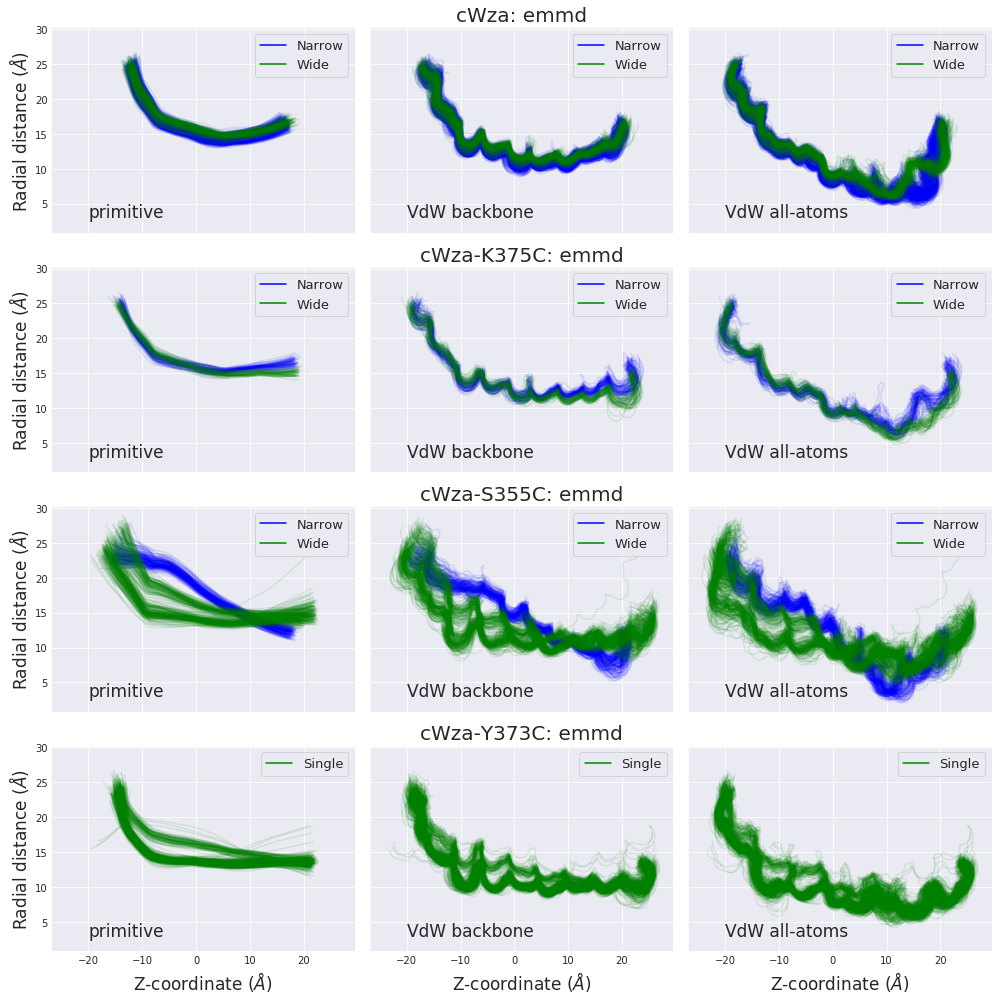

In [8]:
Labels = {
        'primitive':RadialProfiles.primitive,
        'VdW backbone':RadialProfiles.vdw_bb_lower,
        'VdW all-atoms':RadialProfiles.vdw_aa_lower
}

n_rows = len(mutant_names)
n_cols = len(ProfileTypes.keys())
fig, ax = plt.subplots(n_rows,n_cols,figsize=(14,14),sharex=True,sharey=True)

N_models = {}
for i in range(len(mutant_names)):
    ###########################
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    ###########################
    for group in Groups:
        model_ids = [x[0] for x in session_emmd.query(Tags.id).filter_by(mutant=mutant,group=group)]
        for j in range(len(model_ids)):
            id = model_ids[j]
            ###############################
            c = 0           
            for key in ['primitive','VdW backbone','VdW all-atoms']:
                profile = session_emmd.query(ProfileTypes[key]).filter_by(id = id).all()[0][0]
                X,Y = profile
                ax[i,c].plot(X,Y,c=Colors[group],alpha=0.1)
                c += 1

for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    for j in range(n_cols):
        for group in Groups:
            ax[i,j].plot([],[],color=Colors[group],label=Conformation[mutant][group])
                    
for n in range(n_rows):
    ax[n][0].set_ylabel('Radial distance ($\AA$)',fontsize=17)
    ax[n][1].set_title(mutant_names[n]+': emmd',fontsize=20)
    
for n in range(n_cols):
    ax[-1][n].set_xlabel('Z-coordinate ($\AA$)',fontsize=17)
    for m in range(n_mutants):
        ax[m,n].text(-20,3,['primitive','VdW backbone','VdW all-atoms'][n], fontsize=17)
        ax[m,n].tick_params(axis='both',direction='in')
        ax[m,n].legend(loc = 'upper right',fontsize=13)
        
plt.tight_layout()
plt.show()

### Backbone unit orientation

/home/ba13026/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


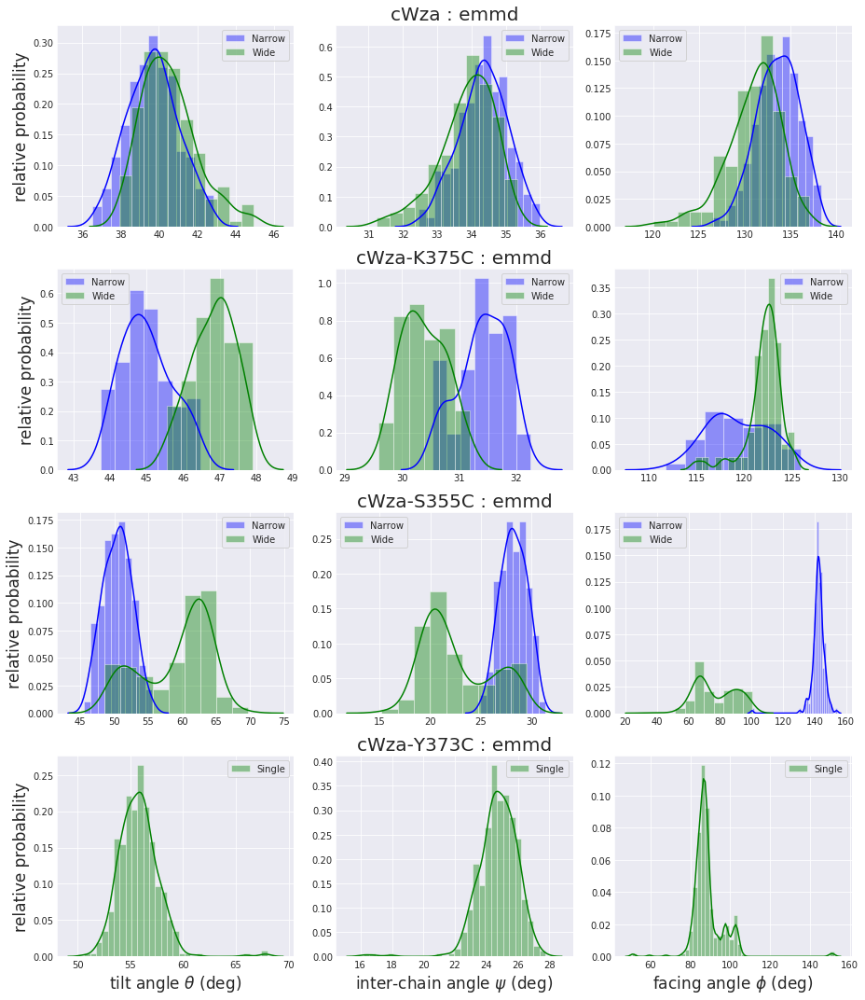

In [9]:
f_hist, ax = plt.subplots(n_mutants,3,figsize=(13,15))

xlabels = [
    "tilt angle $\\theta$ (deg)",
    "inter-chain angle $\\psi$ (deg)",
    "facing angle $\\phi$ (deg)"
]


for i in range(len(mutant_names)):
    ###########################
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    ###########################
    for group in Groups:
        Theta = []; Psi = []; Phi = []
        # Create lists for radial metrics
        model_ids = [x[0] for x in session_emmd.query(Tags.id).filter_by(mutant=mutant, group=group)]
        for j in range(len(model_ids)):
            id = model_ids[j]
            euler_angles = session_emmd.query(RigidBody.euler_angles).filter_by(id = id).all()[0][0]
            theta_per_chain, psi_per_chain_pair, phi_per_chain = euler_angles
            ###########################################
            Theta.append( numpy.mean(theta_per_chain) )
            Psi.append( numpy.mean(psi_per_chain_pair) )
            Phi.append( numpy.mean(phi_per_chain) )

        sns.distplot(Theta,color=Colors[group],label=Conformation[mutant][group],ax=ax[i,0])
        sns.distplot(Psi,color=Colors[group],label=Conformation[mutant][group],ax=ax[i,1])
        sns.distplot(Phi,color=Colors[group],label=Conformation[mutant][group],ax=ax[i,2])
        ax[i,0].set_ylabel('relative probability',fontsize=17)
        ax[i,1].set_title(mutant+' : emmd',fontsize=20)
        
f_hist.subplots_adjust(hspace=0.3)
   
for i in range(3):
    ax[-1,i].set_xlabel(xlabels[i],fontsize=17)
    for k in range(len(mutant_names)):
        ax[k,i].tick_params(axis='both',direction='in')
        ax[k,i].legend(loc='best')
    
f_hist.tight_layout()
plt.show()

### Radial profile analysis

#### Primitive profiles

https://stackoverflow.com/questions/9622163/save-plot-to-image-file-instead-of-displaying-it-using-matplotlib 

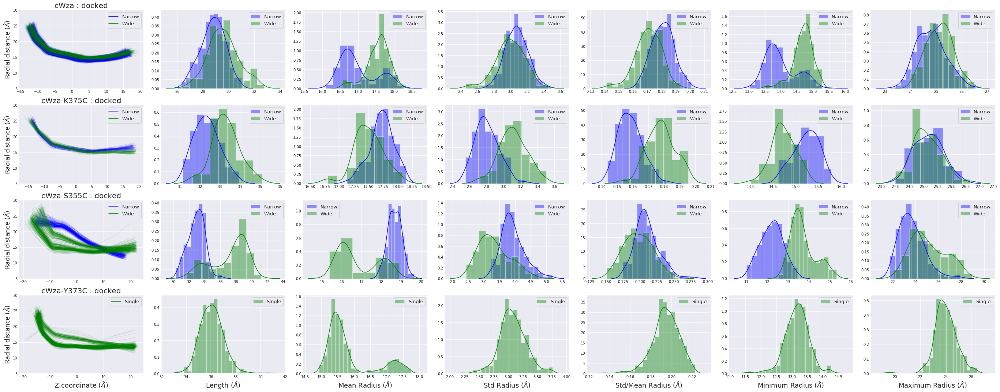

In [10]:
import seaborn as sns

n_rows = len(mutant_names)
metrics = ['length','mean','std','cv','min','max']
n_cols = len(metrics)+1

fig, ax = plt.subplots(n_rows,n_cols,figsize=(38,15))

R_metrics = {}
for i in range(len(mutant_names)):
    ###################################
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    ###################################s
    R_metrics[mutant] = {}
    for group in Groups:
        R_metrics[mutant][group] = {}
        model_ids = [x[0] for x in session_emmd.query(Tags.id).filter_by(mutant=mutant, group=group)]
        # Create lists for radial metrics
        for key in metrics:
            R_metrics[mutant][group][key] = []
        for j in range(len(model_ids)):
            id = model_ids[j]
            primitive_profile = session_emmd.query(RadialProfiles.primitive).filter_by(id = id).all()[0][0]
            X,Y = primitive_profile
            ax[i,0].plot(X,Y,c=Colors[group],alpha=0.1)
            for key in metrics:
                if key != 'length':
                    S = Y
                else:
                    S = X
                R_metrics[mutant][group][key].append(compute_radial_metrics(S,key))
        for k in range(len(metrics)):
            X = R_metrics[mutant][group][metrics[k]]
            sns.distplot(X,color=Colors[group],ax=ax[i][k+1],label = Conformation[mutant][group])

for n in range(n_rows):
    ax[n][0].set_ylabel("Radial distance ($\AA$)",fontsize=17)
    ax[n][0].set_title(mutant_names[n]+" : docked",fontsize=20)
    ax[n,0].set_ylim(5,30)
    for k in range(n_cols):
        ax[n,k].tick_params(axis='both',direction='in')

xlabels = [
    "Z-coordinate ($\AA$)",
    "Length ($\AA$)",
    "Mean Radius ($\AA$)",
    "Std Radius ($\AA$)",
    "Std/Mean Radius ($\AA$)",
    "Minimum Radius ($\AA$)",
    "Maximum Radius ($\AA$)"
]

for n in range(n_cols):
    ax[-1][n].set_xlabel(xlabels[n],fontsize=18)

    
for i in range(len(mutant_names)):
    ###################################
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    ###################################
    for j in range(n_cols):
        for group in Groups:
            ax[i,0].plot([],[],color=Colors[group],label=Conformation[mutant][group])
            ax[i,j].tick_params(axis='both',direction='in')
            ax[i,j].legend(loc='best',fontsize=13)

fig.tight_layout()
plt.show()

#### VdW profiles

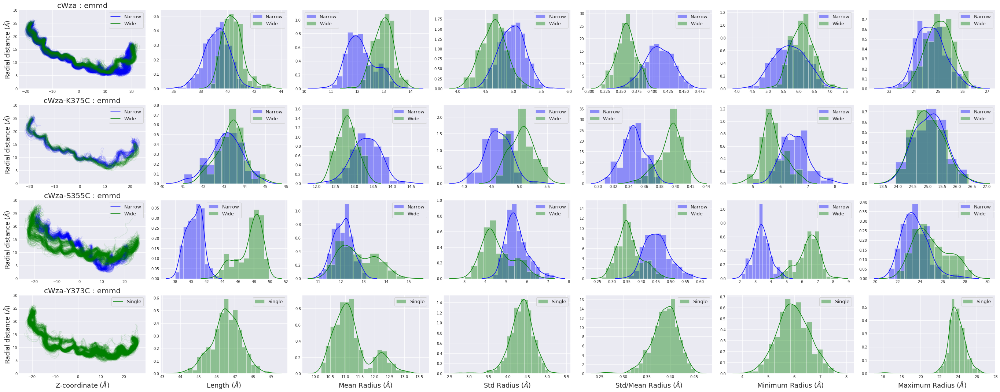

In [14]:
import seaborn as sns

n_rows = len(mutant_names)
metrics = ['length','mean','std','cv','min','max']
n_cols = len(metrics)+1

fig, ax = plt.subplots(n_rows,n_cols,figsize=(38,15))

R_metrics = {}
for i in range(len(mutant_names)):
    ###################################
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    ###################################
    R_metrics[mutant] = {}
    for group in Groups:
        R_metrics[mutant][group] = {}
        model_ids = [x[0] for x in session_emmd.query(Tags.id).filter_by(mutant=mutant, group=group)]
        # Create lists for radial metrics
        for key in metrics:
            R_metrics[mutant][group][key] = []
        for j in range(len(model_ids)):
            id = model_ids[j]
            primitive_profile = session_emmd.query(RadialProfiles.vdw_aa_lower).filter_by(id = id).all()[0][0]
            X,Y = primitive_profile
            ax[i,0].plot(X,Y,c=Colors[group],alpha=0.1)
            for key in metrics:
                if key != 'length':
                    S = Y
                else:
                    S = X
                R_metrics[mutant][group][key].append(compute_radial_metrics(S,key))
        for k in range(len(metrics)):
            X = R_metrics[mutant][group][metrics[k]]
            sns.distplot(X,color=Colors[group],ax=ax[i][k+1],label = Conformation[mutant][group])

for n in range(n_rows):
    ax[n][0].set_ylabel("Radial distance ($\AA$)",fontsize=17)
    ax[n][0].set_title(mutant_names[n]+" : emmd",fontsize=20)
    ax[n,0].set_ylim(0,30)
    for k in range(n_cols):
        ax[n,k].tick_params(axis='both',direction='in')
#         x0,x1 = xlims[k]
#         ax[n][k].set_xlim(x0,x1)

xlabels = [
    "Z-coordinate ($\AA$)",
    "Length ($\AA$)",
    "Mean Radius ($\AA$)",
    "Std Radius ($\AA$)",
    "Std/Mean Radius ($\AA$)",
    "Minimum Radius ($\AA$)",
    "Maximum Radius ($\AA$)"
]

for n in range(n_cols):
    ax[-1][n].set_xlabel(xlabels[n],fontsize=18)

    
for i in range(len(mutant_names)):
    ###################################
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    ###################################
    for j in range(n_cols):
        for group in Groups:
            ax[i,0].plot([],[],color=Colors[group],label=Conformation[mutant][group])
            ax[i,j].tick_params(axis='both',direction='in')
            ax[i,j].legend(loc='best',fontsize=13)

fig.tight_layout()
plt.show()

## Interchain interaction analysis

In [15]:
def interaction_direction(chain_combination):
    chainc_ccwise = ['AB','BC','CD','DE','EF','FG','GH','HA']
    chainc_cwise  = ['AH','HG','GF','FE','ED','DC','CB','BA']
    chainc_intrachn = ['AA','BB','CC','DD','EE','FF','GG','HH']
    if chain_combination in chainc_cwise:
        return 1
    elif chain_combination in chainc_ccwise:
        return -1
    elif chain_combination in chainc_intrachn:
        return 0
    
dbtag = {
    'hbonds': Interhelix_Interactions.hbonds,
    'kihs': Interhelix_Interactions.kihs
    }

# Get Interactions Superbase, per interaction type
for mysession in [session_emmd]:
    S_inter = {}
    S_inter['hbonds'] = set()
    S_inter['kihs'] = set()
    for interaction_type in ['hbonds','kihs']:
        for i in range(len(mutant_names)):
            mutant = mutant_names[i]
            model_ids = [x[0] for x in mysession.query(Tags.id).filter_by(mutant=mutant)]
            for id in model_ids:
                data = mysession.query(dbtag[interaction_type]).filter_by(id=id).first()[0]
                S_inter[interaction_type] = S_inter[interaction_type].union(set(data))

    for interaction_type in ['hbonds','kihs']:
        X = S_inter[interaction_type]
        Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in list(X)]]
        S_inter_ordered = []
        for resn in range(1,33):
            for y in set(Y):
                x = json.loads(y)
                if int(x[0]) == resn:
                    S_inter_ordered.append(json.dumps(x))
        S_inter[interaction_type] = S_inter_ordered

Define refined Superbases

In [16]:
##########################################################
# Get all interactions for all models, distinguish by mutant identity
##########################################################
mutant_interaction_data = {}

dbtag = {
    'hbonds': Interhelix_Interactions.hbonds,
    'kihs': Interhelix_Interactions.kihs
}
for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    mutant_interaction_data[mutant] = {}
    for interaction_type in ['hbonds','kihs']:
        mutant_interaction_data[mutant][interaction_type] = []
        model_ids = [x[0] for x in session_emmd.query(Tags.id).filter_by(mutant=mutant)]
        for id in model_ids:
            data = session_emmd.query(dbtag[interaction_type]).filter_by(id=id).first()[0]
            mutant_interaction_data[mutant][interaction_type].append(data)
##########################################################
# Get all interaction decomposition stats for all models, distinguish by mutant identity
##########################################################
mutant_interaction_stats = {}

for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    mutant_interaction_stats[mutant] = {}
    for interaction_type in ['hbonds','kihs']:        
        mutant_interaction_stats[mutant][interaction_type] = []        
        data = mutant_interaction_data[mutant][interaction_type]
        for item in data:
            decomposition_vector = []
            for s in S_inter[interaction_type]:
                counter = 0
                for x in item:
                    x_raw = json.loads(x)
                    y = json.dumps(x_raw[:-1]+[interaction_direction(x_raw[-1])])
                    if y == s:
                        counter +=1
                decomposition_vector.append(counter)
            mutant_interaction_stats[mutant][interaction_type].append(decomposition_vector)
##########################################################
# Work out all interaction probabilities for all models, distinguish by mutant identity
##########################################################
N_chains = 8
probability_data_raw = {}

for interaction_type in ['hbonds','kihs']:
    probability_data_raw[interaction_type] = []
#     labels[interaction_type] = []
    Sx = S_inter[interaction_type]
    for i in range(len(mutant_names)):
        mutant = mutant_names[i]
        data = mutant_interaction_stats[mutant][interaction_type]
        N_models = 0
        X = numpy.zeros(len(Sx))
        for x in data:
            X = X + numpy.asarray(x)
            N_models += 1
        probability = X/float(N_chains*N_models)
        probability_data_raw[interaction_type].append(probability)
##########################################################
# Perform dimensionality reduction of interaction probabilities, regardless of mutant identity
##########################################################
S_refined = {}
probability_data_refined = {}

for interaction_type in ['hbonds','kihs']:
    Sx = S_inter[interaction_type]
    S_refined[interaction_type] = []
    data = numpy.array(probability_data_raw[interaction_type]).T
    tolerance = 0.05
    exclude = []
    for i in range(len(Sx)):
        comparison = data[i] >= tolerance
        if any(comparison):
            exclude.append(i)
    extracted_data = operator.itemgetter(*exclude)(data)
    S_refined[interaction_type] = operator.itemgetter(*exclude)(Sx)
    probability_data_refined[interaction_type] = []
    for k in range(len(mutant_names)-1):
        X = probability_data_raw[interaction_type][k]
        probability_data_refined[interaction_type].append(operator.itemgetter(*exclude)(X))
##########################################################
# Data framing 
import pandas as pd
##########################################################
Data_refined = {}
S = S_refined
for interaction_type in ['hbonds','kihs']:
    Data_refined[interaction_type] = {}
    X = []
    for i in range(len(mutant_names)-1):
        mutant = mutant_names[i]
        X.append(numpy.array(probability_data_refined[interaction_type][i]))
    X = numpy.array(X).T
    Data_refined[interaction_type] = [[S[interaction_type][i]]+list(X[i]) for i in range(len(S[interaction_type]))]

interaction_type = 'hbonds'
df_hbonds_refined = pd.DataFrame(Data_refined[interaction_type],columns=['HO-atoms']+mutant_names[:-1])
interaction_type = 'kihs'
df_kihs_refined = pd.DataFrame(Data_refined[interaction_type],columns=['KIH-atoms']+mutant_names[:-1])

Labels_refined = {}

inter_label = []
for s in S_refined['hbonds']:
    ho_atoms = json.loads(s)
    inter_label.append(
            ho_atoms[0]+'-'+ho_atoms[1]+' ||| '+ ho_atoms[2]+'-'+ho_atoms[3]+', '+str(ho_atoms[-1])
        )

Labels_refined['hbonds'] = inter_label

inter_label = []
for s in S_refined['kihs']:
    kih_atoms = json.loads(s)
    knob = kih_atoms[0]
    hole = "-".join(kih_atoms[1:-1])
    direct = kih_atoms[-1]
    inter_label.append(knob+' >> '+hole+', '+str(direct))

Labels_refined['kihs'] = inter_label

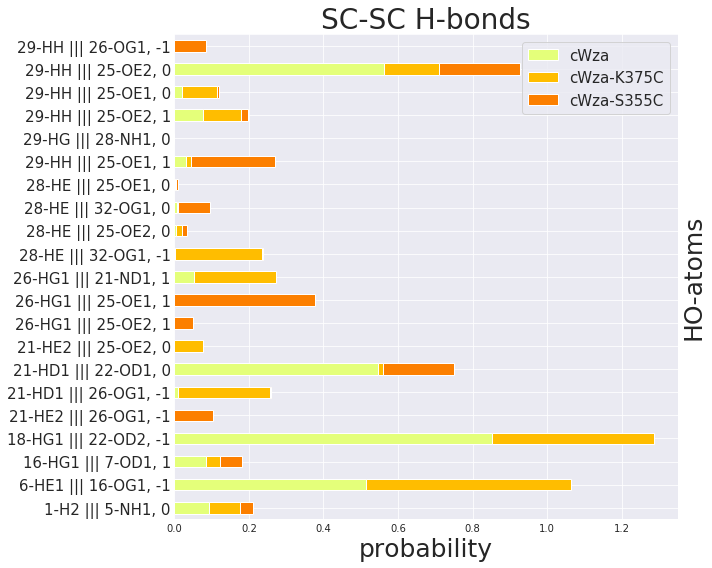

In [17]:
fig, ax = plt.subplots(figsize=(10,8))

df_hbonds_refined.plot(x="HO-atoms",y=mutant_names[:-1],kind="barh",stacked=True,ax=ax,colormap='Wistia')
# # Add a legend and informative axis label
# ax.legend(ncol=2, loc="lower right", frameon=True)
# ax.set(xlim=(0,1), ylabel="")
ax.set_xlabel("probability", fontsize=25)
ax.set_ylabel("HO-atoms", fontsize=25)
ax.yaxis.set_label_position("right")
ax.tick_params(axis='both',direction='in')
ax.set_yticklabels(Labels_refined['hbonds'], fontsize=15)
ax.set_title("SC-SC H-bonds", fontsize=28)

fig.tight_layout()
plt.legend(loc='best',fontsize=15)
plt.show()

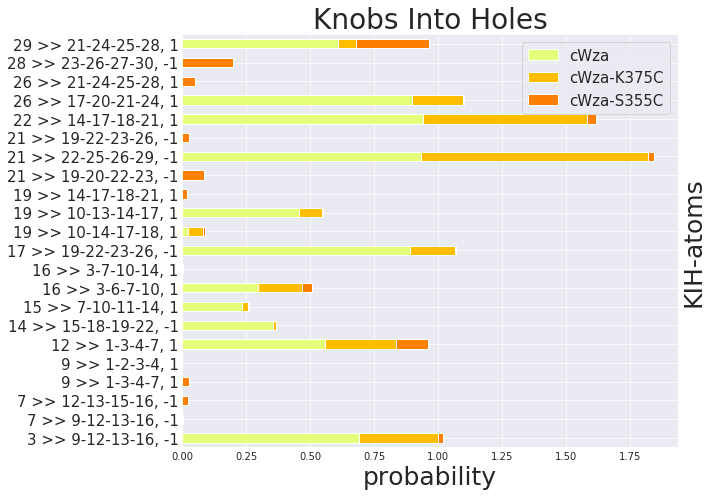

In [18]:
fig, ax = plt.subplots(figsize=(10,7))

df_kihs_refined.plot(x="KIH-atoms",y=mutant_names[:-1],kind="barh",stacked=True,ax=ax,colormap='Wistia')
# # Add a legend and informative axis label
# ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set( ylabel="KIH-atoms")
ax.set_xlabel("probability", fontsize=25)
ax.set_ylabel("KIH-atoms", fontsize=25)
ax.yaxis.set_label_position("right")
ax.tick_params(axis='both',direction='in')
ax.set_yticklabels(Labels_refined['kihs'], fontsize=15)
ax.set_title("Knobs Into Holes", fontsize=28)

fig.tight_layout()
plt.legend(loc='best',fontsize=15)
plt.show()

Data without refined Superbase

In [19]:
mutant_interaction_data_conformation = {}
for i in range(len(mutant_names)):
    ##################################
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    ##################################
    mutant_interaction_data_conformation[mutant] = {}
    for interaction_type in ['hbonds','kihs']:
        mutant_interaction_data_conformation[mutant][interaction_type] = {}
        for group in Groups:
            mutant_interaction_data_conformation[mutant][interaction_type][group] = []
            model_ids = [x[0] for x in session_emmd.query(Tags.id).filter_by(mutant=mutant, group=group)]
            for id in model_ids:
                data = session_emmd.query(dbtag[interaction_type]).filter_by(id=id).first()[0]
                mutant_interaction_data_conformation[mutant][interaction_type][group].append(data)

In [20]:
mutant_interaction_stats_conformation = {}
for i in range(len(mutant_names)):
    ##################################
    mutant = mutant_names[i]
    if mutant != 'cWza-Y373C':
        Groups = ['em-conformation0','em-conformation1']
    else:
        Groups = ['em-conformation1']
    ##################################
    mutant_interaction_stats_conformation[mutant] = {}
    for interaction_type in ['hbonds','kihs']:        
        mutant_interaction_stats_conformation[mutant][interaction_type] = {}
        for group in Groups:
            mutant_interaction_stats_conformation[mutant][interaction_type][group] = []
            data = mutant_interaction_data_conformation[mutant][interaction_type][group]
            for item in data:
                decomposition_vector = []
                for s in S_inter[interaction_type]:
                    counter = 0
                    for x in item:
                        x_raw = json.loads(x)
                        y = json.dumps(x_raw[:-1]+[interaction_direction(x_raw[-1])])
                        if y == s:
                            counter +=1
                    decomposition_vector.append(counter)
                mutant_interaction_stats_conformation[mutant][interaction_type][group].append(decomposition_vector)

In [21]:
N_chains = 8
probability_data_raw_conformation = {}
# labels = {}
for interaction_type in ['hbonds','kihs']:
    probability_data_raw_conformation[interaction_type] = {}
#     labels[interaction_type] = []
    Sx = S_inter[interaction_type]
    for i in range(len(mutant_names)):
    ##################################
        mutant = mutant_names[i]
        if mutant != 'cWza-Y373C':
            Groups = ['em-conformation0','em-conformation1']
        else:
            Groups = ['em-conformation1']
        ##################################    
        probability_data_raw_conformation[interaction_type][mutant] = {}
        for group in Groups:
            probability_data_raw_conformation[interaction_type][mutant][group] = []
            data = mutant_interaction_stats_conformation[mutant][interaction_type][group]
            N_models = 0
            X = numpy.zeros(len(Sx))
            for x in data:
                X = X + numpy.asarray(x)
                N_models += 1
            probability = X/float(N_chains*N_models)
            probability_data_raw_conformation[interaction_type][mutant][group] = probability

In [22]:
exclude_indices = {}
for interaction_type in ['hbonds', 'kihs']:
    exclude_indices[interaction_type] = [S_inter[interaction_type].index(s) for s in S_refined[interaction_type]]

Up to here all good!

In [23]:
from operator import itemgetter
Data = {}
S = S_refined
for interaction_type in ['hbonds','kihs']:
    Data[interaction_type] = {}
    for i in range(len(mutant_names)):
        #############################################
        mutant = mutant_names[i]
        if mutant != 'cWza-Y373C':
            Groups = ['em-conformation0','em-conformation1']
        else:
            Groups = ['em-conformation1']
        Data[interaction_type][mutant] = {}
        #############################################
        X = []
        for group in Groups:
            data = itemgetter(*exclude_indices[interaction_type])(probability_data_raw_conformation[interaction_type][mutant][group])
            X.append(numpy.array(data))
        X = numpy.array(X).T
        Data[interaction_type][mutant] = X

In [24]:
Labels_refined = {}

inter_label = []
for s in S_refined['hbonds']:
    ho_atoms = json.loads(s)
    inter_label.append(
            ho_atoms[0]+'-'+ho_atoms[1]+' ||| '+ ho_atoms[2]+'-'+ho_atoms[3]+', '+str(ho_atoms[-1])
        )

Labels_refined['hbonds'] = inter_label

inter_label = []
for s in S_refined['kihs']:
    kih_atoms = json.loads(s)
    knob = kih_atoms[0]
    hole = "-".join(kih_atoms[1:-1])
    direct = kih_atoms[-1]
    inter_label.append(knob+' >> '+hole+', '+str(direct))

Labels_refined['kihs'] = inter_label

Vusalize data

### Hydrogen bonds

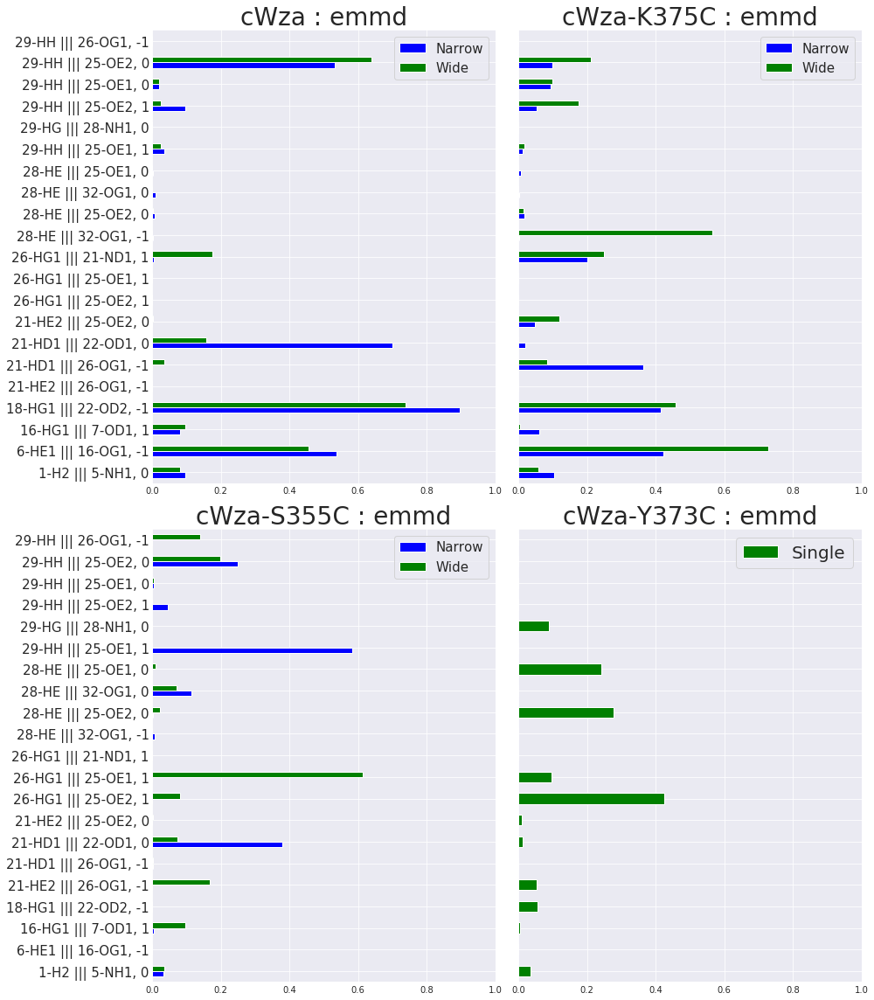

In [27]:
fig, ax = plt.subplots(2,2,figsize=(14,16))

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'blue', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'blue', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['','Single'],
}

interaction_type = 'hbonds'

for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    df = pd.DataFrame(Data[interaction_type][mutant])
    df.plot(kind="barh",ax=axes[mutant],color=Colors[mutant].values())
    
    axes[mutant].set(xlim=(0,1))
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : emmd", fontsize=28)
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    
ax[0,0].set_yticklabels(Labels_refined[interaction_type], fontsize=15)
ax[1,0].set_yticklabels(Labels_refined[interaction_type], fontsize=15)
ax[0,1].set_yticklabels("")
ax[1,1].set_yticklabels("")

ax[1,1].legend(['Single'],loc='best',fontsize=20)

fig.tight_layout()

plt.show()

### Knobs-Into-Holes

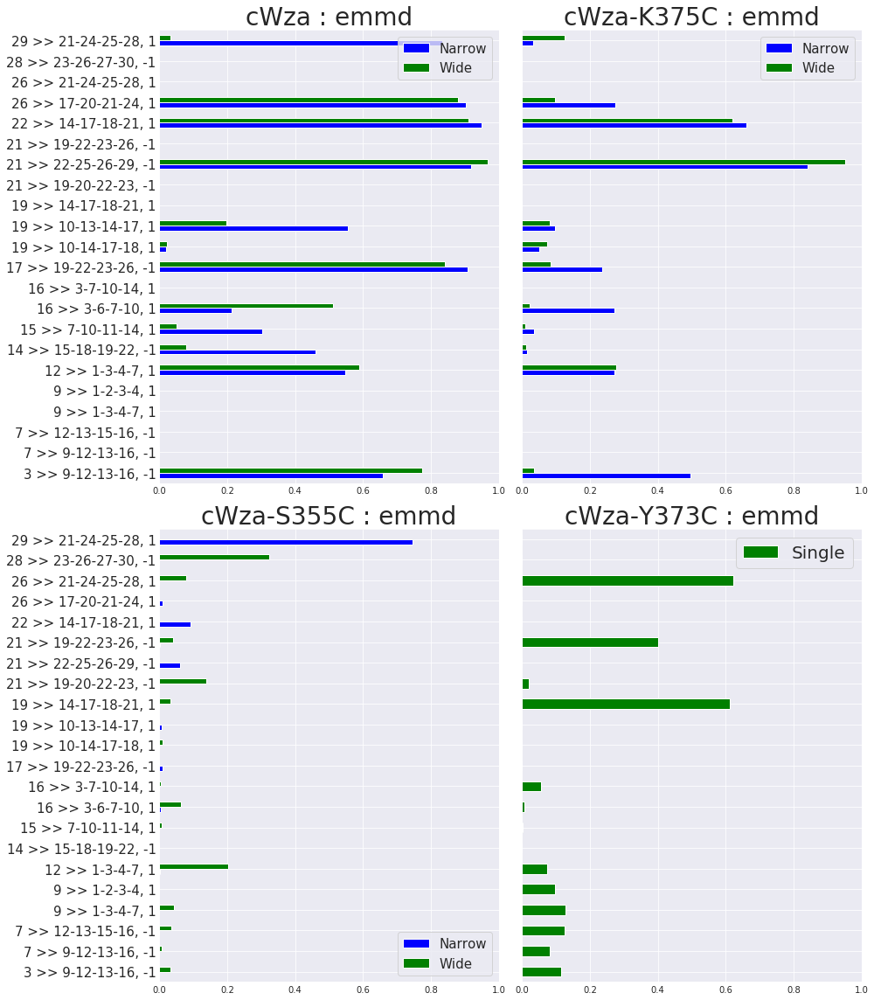

In [28]:
fig, ax = plt.subplots(2,2,figsize=(14,16))

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['','Single'],
}

interaction_type = 'kihs'

for i in range(len(mutant_names)):
    mutant = mutant_names[i]
    df = pd.DataFrame(Data[interaction_type][mutant])
    df.plot(kind="barh",ax=axes[mutant],color=Colors[mutant].values())
    
    axes[mutant].set(xlim=(0,1))
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : emmd", fontsize=28)
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    
ax[0,0].set_yticklabels(Labels_refined[interaction_type], fontsize=15)
ax[1,0].set_yticklabels(Labels_refined[interaction_type], fontsize=15)
ax[0,1].set_yticklabels("")
ax[1,1].set_yticklabels("")

ax[1,1].legend(['Single'],loc='best',fontsize=20)

fig.tight_layout()

plt.show()

# Integrated approach

## VERSION 1

In [48]:
%%writefile /home/ba13026/mpmodeling/analysis/geometry_interactions.py
import os
import sys
import numpy
import json
import subprocess
import isambard_dev
import operator
import pandas as pd
from operator import itemgetter
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker

modules_path = "/home/ba13026/mpmodeling/analysis/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

import setup_geometry_interactions_db
import importlib
importlib.reload(setup_geometry_interactions_db)
from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base
from insert2db_geometry_interactions import interaction_direction

class Models:
    def __init__(self, db_path = ''):
        self.db_path = db_path
        self.session = self.start_session()
        self.ids = []
    
    def start_session(self):
        engine = create_engine('sqlite:///'+self.db_path)
        Base.metadata.bind = engine
        DBSession = sessionmaker()
        DBSession.bind = engine
        return DBSession()        
    
# class Geometry:
#     def __init__(self):
#         self.euler_angles = ''
#         self.radial_profiles = ''

# class Interactions(object):
#     def __init__(self):
#         self.hbonds_superbase = get_refined_superbase('hbonds')
#         self.kihs_superbase = get_refined_superbase('kihs')
#         self.hbonds = ''
#         self.kihs = ''
        

class Analyse_Interactions(object):
    def __init__(self, models):
        self.models = models
        self.dbtag = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
        }
        self.session = models.session
        self.models_ids = models.ids
        self.interaction_probability = self.Interaction_Probability
        self.superbase = self.get_superbase
        self.tools = Tools()

    def get_superbase(self, inter_type):
        models_ids = self.models_ids
        N_residues = 32
        S_inter = set()    
        for j in range(len(models_ids)):
            id = models_ids[j]
            data = self.session.query(self.dbtag[inter_type]).filter_by(id=id).first()[0]
            S_inter = S_inter.union(set(data))
        # Sort base by residue number    
        X = list(S_inter)
        Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in X]]
        S_inter_sorted = []
        for resn in range(1,N_residues+1):
            for y in set(Y):
                x = json.loads(y)
                if int(x[0]) == resn:
                    S_inter_sorted.append(json.dumps(x))
        return S_inter_sorted

    def get_interaction_data(self, inter_type, models_ids):
        mutant_interaction_data = {}
        for j in range(len(models_ids)):
            id = models_ids[j]
            data = self.session.query(self.dbtag[inter_type]).filter_by(id=id).first()[0]
            mutant_interaction_data[id] = data
        return mutant_interaction_data

    def get_interaction_stats(self, S_inter, mutant_interaction_data):
        S = S_inter
        X = mutant_interaction_data
        mutant_interaction_stats = {}
        for id in list(X.keys()):
            decomposition_vector = []
            for s in S:
                counter = 0
                for x in X[id]:
                    x_raw = json.loads(x)
                    y = json.dumps(x_raw[:-1]+[interaction_direction(x_raw[-1])])
                    if y == s:
                        counter +=1
                decomposition_vector.append(counter)
            mutant_interaction_stats[id] = decomposition_vector
        return mutant_interaction_stats

    def get_interaction_probability(self, S_inter, mutant_interaction_stats, N_chains = 8):
        probability_data_raw = {}        
        Sx = S_inter        
        data = mutant_interaction_stats
        N_models = len(list(mutant_interaction_stats.keys()))
        X = numpy.zeros(len(Sx))
        for id in list(data.keys()):
            x = data[id]
            X = X + numpy.asarray(x)
        probability_inter = X/float(N_chains*N_models)
        return probability_inter
    
    def Interaction_Probability(self, inter_type):
        superbase = self.get_superbase(inter_type)
        atoms = self.get_interaction_data(inter_type, self.models_ids)
        stats =  self.get_interaction_stats(superbase, atoms)
        probability = self.get_interaction_probability(superbase, stats)
        return probability
    
class Tools:
    def __init__(self):
        pass

    def relabel_interaction_json(self, atoms_json, inter_type):
        try: 
            if inter_type == 'hbonds':
                ho_atoms = json.loads(atoms_json)
                label = ho_atoms[0]+'-'+ho_atoms[1]+' ||| '+ ho_atoms[2]+'-'+ho_atoms[3]+', '+str(ho_atoms[-1])
            elif inter_type == 'kihs':
                kih_atoms = json.loads(atoms_json)
                knob = kih_atoms[0]
                hole = "-".join(kih_atoms[1:-1])
                direct = kih_atoms[-1]
                label = knob+' >> '+hole+', '+str(direct)
            return label
        except:
            print("Provide a valid interaction type")

    def labels_df(self, S_inter, inter_type):
        return [relabel_interaction_json(s, inter_type) for s in S_inter]

Writing /home/ba13026/mpmodeling/analysis/geometry_interactions.py


## VERSION 2

In [1]:
# %%writefile /home/ba13026/mpmodeling/analysis/geometry_interactions.py
import os
import sys
import numpy
import json
import subprocess
import isambard_dev
import operator
import pandas as pd
from operator import itemgetter
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker

modules_path = "/home/ba13026/mpmodeling/analysis/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

import setup_geometry_interactions_db
from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base
from insert2db_geometry_interactions import interaction_direction

def sort_superbase(S_inter, N_residues=32):
    Y = list(S_inter)
#     Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in X]]
    S_inter_sorted = []
    for resn in range(1,N_residues+1):
        for y in Y:
            x = json.loads(y)
            if int(x[0]) == resn:
                S_inter_sorted.append(json.dumps(x))
    return S_inter_sorted

class Models:
    def __init__(self, db_path):
        self.db_path = db_path
        self.session = self.start_session()
        self.ids = []
    
    def start_session(self):
        engine = create_engine('sqlite:///'+self.db_path)
        Base.metadata.bind = engine
        DBSession = sessionmaker()
        DBSession.bind = engine
        return DBSession()        
    
# class Geometry:
#     def __init__(self):
#         self.euler_angles = ''
#         self.radial_profiles = ''

# class Interactions(object):
#     def __init__(self):
#         self.hbonds_superbase = get_refined_superbase('hbonds')
#         self.kihs_superbase = get_refined_superbase('kihs')
#         self.hbonds = ''
#         self.kihs = ''
        

class Analyse_Interactions(object):
    def __init__(self, models):
        self.dbtag = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
        }
        self.session = models.session
        self.models_ids = models.ids
        self.interaction_probability = self.Interaction_Probability
        self.superbase = self.get_superbase
        self.tools = Tools()


    def get_superbase(self, inter_type):
        N_residues = 32
        S_inter = set()    
        for j in range(len(self.models_ids)):
            id = self.models_ids[j]
            data = self.session.query(self.dbtag[inter_type]).filter_by(id=id).first()[0]
            S_inter = S_inter.union(set(data))
        # Sort base by residue number    
        X = list(S_inter)
        Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in X]]
        S_inter_sorted = []
        for resn in range(1,N_residues+1):
            for y in set(Y):
                x = json.loads(y)
                if int(x[0]) == resn:
                    S_inter_sorted.append(json.dumps(x))
        return S_inter_sorted
    
    def get_interaction_data(self, inter_type):
        mutant_interaction_data = {}
        for j in range(len(self.models_ids)):
            id = self.models_ids[j]
            try:
                data = self.session.query(self.dbtag[inter_type]).filter_by(id=id).first()[0]
                mutant_interaction_data[id] = data
            except:
                print("No Interaction data for id: ", id)
        return mutant_interaction_data

    def get_interaction_stats(self, S_inter, mutant_interaction_data):
        S = S_inter
        X = mutant_interaction_data
        mutant_interaction_stats = {}
        for id in list(X.keys()):
            decomposition_vector = []
            for s in S:
                counter = 0
                for x in X[id]:
                    x_raw = json.loads(x)
                    y = json.dumps(x_raw[:-1]+[interaction_direction(x_raw[-1])])
                    if y == s:
                        counter +=1
                decomposition_vector.append(counter)
            mutant_interaction_stats[id] = decomposition_vector
        return mutant_interaction_stats

    def get_interaction_probability(self, S_inter, mutant_interaction_stats, N_chains = 8):
        probability_data_raw = {}        
        Sx = S_inter        
        data = mutant_interaction_stats
        N_models = len(list(mutant_interaction_stats.keys()))
        X = numpy.zeros(len(Sx))
        for id in list(data.keys()):
            x = data[id]
            X = X + numpy.asarray(x)
        probability_inter = X/float(N_chains*N_models)
        return probability_inter
    
    def Interaction_Probability(self, superbase, inter_type):
#         superbase = self.get_superbase(inter_type)
        atoms = self.get_interaction_data(inter_type)
        stats =  self.get_interaction_stats(superbase, atoms)
        probability = self.get_interaction_probability(superbase, stats)
        return probability
    
class Tools:
    def __init__(self):
        pass

    def relabel_interaction_json(self, atoms_json, inter_type):
        try: 
            if inter_type == 'hbonds':
                ho_atoms = json.loads(atoms_json)
                label = ho_atoms[0]+'-'+ho_atoms[1]+' ||| '+ ho_atoms[2]+'-'+ho_atoms[3]+', '+str(ho_atoms[-1])
            elif inter_type == 'kihs':
                kih_atoms = json.loads(atoms_json)
                knob = kih_atoms[0]
                hole = "-".join(kih_atoms[1:-1])
                direct = kih_atoms[-1]
                label = knob+' >> '+hole+', '+str(direct)
            return label
        except:
            print("Provide a valid interaction type")

    def labels_df(self, S_inter, inter_type):
        return [self.relabel_interaction_json(s, inter_type) for s in S_inter]

## VERSION 3

In [9]:
%%writefile /home/ba13026/mpmodeling/analysis/geometry_interactions.py
import os
import sys
import numpy
import json
import subprocess
import isambard_dev
import operator
import pandas as pd
from operator import itemgetter
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker

modules_path = "/home/ba13026/mpmodeling/analysis/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

import setup_geometry_interactions_db
from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base
from insert2db_geometry_interactions import interaction_direction

def sort_superbase(S_inter, N_residues=32):
    Y = list(S_inter)
#     Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in X]]
    S_inter_sorted = []
    for resn in range(1,N_residues+1):
        for y in Y:
            x = json.loads(y)
            if int(x[0]) == resn:
                S_inter_sorted.append(json.dumps(x))
    return S_inter_sorted

def start_session(db_path):
    engine = create_engine('sqlite:///'+db_path)
    Base.metadata.bind = engine
    DBSession = sessionmaker()
    DBSession.bind = engine
    session = DBSession()
    return session

class Models:
    def __init__(self, session):
        self.session = session
        self.ids = []

class Analyse_Interactions:
    def __init__(self, models):
        self.dbtag = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
        }
        self.session = models.session
        self.models_ids = models.ids
        self.interaction_probability = self.Interaction_Probability
        self.superbase = self.get_superbase
        self.tools = Tools()


    def get_superbase(self, inter_type):
        N_residues = 32
        S_inter = set()    
        for j in range(len(self.models_ids)):
            id = self.models_ids[j]
            data = self.session.query(self.dbtag[inter_type]).filter_by(id=id).first()[0]
            S_inter = S_inter.union(set(data))
        # Sort base by residue number    
        X = list(S_inter)
        Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in X]]
        S_inter_sorted = []
        for resn in range(1,N_residues+1):
            for y in set(Y):
                x = json.loads(y)
                if int(x[0]) == resn:
                    S_inter_sorted.append(json.dumps(x))
        return S_inter_sorted
    
    def get_interaction_data(self, inter_type):
        mutant_interaction_data = {}
        for j in range(len(self.models_ids)):
            id = self.models_ids[j]
            try:
                data = self.session.query(self.dbtag[inter_type]).filter_by(id=id).first()[0]
                mutant_interaction_data[id] = data
            except:
                print("No Interaction data for id: ", id)
        return mutant_interaction_data

    def get_interaction_stats(self, S_inter, mutant_interaction_data):
        S = S_inter
        X = mutant_interaction_data
        mutant_interaction_stats = {}
        for id in list(X.keys()):
            decomposition_vector = []
            for s in S:
                counter = 0
                for x in X[id]:
                    x_raw = json.loads(x)
                    y = json.dumps(x_raw[:-1]+[interaction_direction(x_raw[-1])])
                    if y == s:
                        counter +=1
                decomposition_vector.append(counter)
            mutant_interaction_stats[id] = decomposition_vector
        return mutant_interaction_stats

    def get_interaction_probability(self, S_inter, mutant_interaction_stats, N_chains = 8):
        probability_data_raw = {}        
        Sx = S_inter        
        data = mutant_interaction_stats
        N_models = len(list(mutant_interaction_stats.keys()))
        X = numpy.zeros(len(Sx))
        for id in list(data.keys()):
            x = data[id]
            X = X + numpy.asarray(x)
        probability_inter = X/float(N_chains*N_models)
        return probability_inter
    
    def Interaction_Probability(self, superbase, inter_type):
#         superbase = self.get_superbase(inter_type)
        atoms = self.get_interaction_data(inter_type)
        stats =  self.get_interaction_stats(superbase, atoms)
        probability = self.get_interaction_probability(superbase, stats)
        return probability
    
class Tools:
    def __init__(self):
        pass

    def relabel_interaction_json(self, atoms_json, inter_type):
        try: 
            if inter_type == 'hbonds':
                ho_atoms = json.loads(atoms_json)
                label = ho_atoms[0]+'-'+ho_atoms[1]+' ||| '+ ho_atoms[2]+'-'+ho_atoms[3]+', '+str(ho_atoms[-1])
            elif inter_type == 'kihs':
                kih_atoms = json.loads(atoms_json)
                knob = kih_atoms[0]
                hole = "-".join(kih_atoms[1:-1])
                direct = kih_atoms[-1]
                label = knob+' >> '+hole+', '+str(direct)
            return label
        except:
            print("Provide a valid interaction type")

    def labels_df(self, S_inter, inter_type):
        return [self.relabel_interaction_json(s, inter_type) for s in S_inter]

## VERSION 4: Parallel

In [9]:
%%writefile /home/ba13026/mpmodeling/analysis/geometry_interactions_parallel.py
import os
import sys
import numpy
import json
import subprocess
import isambard_dev
import operator
import pandas as pd
from operator import itemgetter
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker

modules_path = "/home/ba13026/mpmodeling/analysis/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

import setup_geometry_interactions_db
from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base
from insert2db_geometry_interactions import interaction_direction

def sort_superbase(S_inter, N_residues=32):
    Y = list(S_inter)
#     Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in X]]
    S_inter_sorted = []
    for resn in range(1,N_residues+1):
        for y in Y:
            x = json.loads(y)
            if int(x[0]) == resn:
                S_inter_sorted.append(json.dumps(x))
    return S_inter_sorted

def start_session(db_path):
    engine = create_engine('sqlite:///'+db_path)
    Base.metadata.bind = engine
    DBSession = sessionmaker()
    DBSession.bind = engine
    session = DBSession()
    return session

class Models:
    def __init__(self, session):
        self.session = session
        self.ids = []

class Analyse_Interactions:
    def __init__(self, models):
        self.dbtag = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
        }
        self.session = models.session
        self.models_ids = models.ids
        self.interaction_probability = self.Interaction_Probability
        self.superbase = self.get_superbase
        self.tools = Tools()


    def get_superbase(self, inter_type):
        N_residues = 32
        S_inter = set()    
        for j in range(len(self.models_ids)):
            id = self.models_ids[j]
            data = self.session.query(self.dbtag[inter_type]).filter_by(id=id).first()[0]
            S_inter = S_inter.union(set(data))
        # Sort base by residue number    
        X = list(S_inter)
        Y = [json.dumps(x[:-1]+[interaction_direction(x[-1])]) for x in [json.loads(x) for x in X]]
        S_inter_sorted = []
        for resn in range(1,N_residues+1):
            for y in set(Y):
                x = json.loads(y)
                if int(x[0]) == resn:
                    S_inter_sorted.append(json.dumps(x))
        return S_inter_sorted
    
    def get_interaction_data(self, inter_type):
        mutant_interaction_data = {}
        for j in range(len(self.models_ids)):
            id = self.models_ids[j]
            try:
                data = self.session.query(self.dbtag[inter_type]).filter_by(id=id).first()[0]
                mutant_interaction_data[id] = data
            except:
                print("No Interaction data for id: ", id)
        return mutant_interaction_data

    def get_interaction_stats(self, S_inter, mutant_interaction_data):
        S = S_inter
        X = mutant_interaction_data
        mutant_interaction_stats = {}
        for id in list(X.keys()):
            decomposition_vector = []
            for s in S:
                counter = 0
                for x in X[id]:
                    x_raw = json.loads(x)
                    y = json.dumps(x_raw[:-1]+[interaction_direction(x_raw[-1])])
                    if y == s:
                        counter +=1
                decomposition_vector.append(counter)
            mutant_interaction_stats[id] = decomposition_vector
        return mutant_interaction_stats

    def get_interaction_probability(self, S_inter, mutant_interaction_stats, N_chains = 8):
        probability_data_raw = {}        
        Sx = S_inter        
        data = mutant_interaction_stats
        N_models = len(list(mutant_interaction_stats.keys()))
        X = numpy.zeros(len(Sx))
        for id in list(data.keys()):
            x = data[id]
            X = X + numpy.asarray(x)
        probability_inter = X/float(N_chains*N_models)
        return probability_inter
    
    def Interaction_Probability(self, superbase, inter_type):
#         superbase = self.get_superbase(inter_type)
        atoms = self.get_interaction_data(inter_type)
        stats =  self.get_interaction_stats(superbase, atoms)
        probability = self.get_interaction_probability(superbase, stats)
        return probability
    
class Tools:
    def __init__(self):
        pass

    def relabel_interaction_json(self, atoms_json, inter_type):
        try: 
            if inter_type == 'hbonds':
                ho_atoms = json.loads(atoms_json)
                label = ho_atoms[0]+'-'+ho_atoms[1]+' ||| '+ ho_atoms[2]+'-'+ho_atoms[3]+', '+str(ho_atoms[-1])
            elif inter_type == 'kihs':
                kih_atoms = json.loads(atoms_json)
                knob = kih_atoms[0]
                hole = "-".join(kih_atoms[1:-1])
                direct = kih_atoms[-1]
                label = knob+' >> '+hole+', '+str(direct)
            return label
        except:
            print("Provide a valid interaction type")

    def labels_df(self, S_inter, inter_type):
        return [self.relabel_interaction_json(s, inter_type) for s in S_inter]

Parallel list filling

Serial example: 11-12 s

In [5]:
data = []
N=100000000
for n in range(N):
    data.append(n)

In [6]:
del data

In [7]:
data = [n for i in range(N)]

In [8]:
del data

In [42]:
data = []
N = 100000000
f = lambda x: data.append(x)
data = [f(n) for n in range(N)]

In [43]:
del data

In [44]:
data = []
f = data.append
x = [f(n) for n in range(N)]

In [22]:
import random
lowerlist = ['abcdefghijklmnopqrstuvwxyz'[:random.randint(0,25)] for x in range(1000)]
upperlist = []

def to_upper_1():
    for word in lowerlist:
        upperlist.append(str.upper(word))
        
to_upper_1()

In [21]:
upper = str.upper
append = upperlist.append

def to_upper_2():
    for word in lowerlist:
        append(upper(word))
        
to_upper_2()

Parallel implementation

In [3]:
N=100000000
param_list = range(N)

In [4]:
def func(n):
    return n

In [ ]:
import concurrent.futures     
n_threads = 4

data = []

with concurrent.futures.ThreadPoolExecutor(max_workers = n_threads) as executor:
    out = executor.map(func, param_list)
    data.append(out)

## Docked models

Works well with version 2

### H-bonds

In [33]:
path0 = "/home/ba13026/dbs/"
db_path = path0+'mutants_docked_geometry-interactions.db'

In [34]:
inter_type = 'hbonds'

MyTags = [
    json.dumps(['cWza','conformation0']),
    json.dumps(['cWza','conformation1']),
    json.dumps(['cWza-K375C','conformation0']),
    json.dumps(['cWza-K375C','conformation1']),
    json.dumps(['cWza-S355C','conformation0']),
    json.dumps(['cWza-S355C','conformation1']),
    json.dumps(['cWza-Y373C','conformation0'])
]

Superbases = {}
Analyses = {}

for tags in MyTags:
    models = Models(db_path = db_path)
    mutant, group = json.loads(tags)
    models_ids = list(Filtered_IDs[mutant][group])
    models.ids = models_ids
    analysis = Analyse_Interactions(models)
    Analyses[tags] = analysis
    sbase = analysis.superbase(inter_type)
    Superbases[tags] = sbase

Unified superbase

In [35]:
unified_sbase = set()
for sb in list(Superbases.values()):
    unified_sbase = unified_sbase.union(set(sb))

sbase = list(unified_sbase)
sbase = sort_superbase(list(sbase), N_residues=32)

In [36]:
Probabilities = {}
for tags in MyTags:
    analysis = Analyses[tags]
    prob = analysis.interaction_probability(sbase,inter_type)
    Probabilities[tags] = prob
##################################################
tools = Tools()
Labels = tools.labels_df(sbase,inter_type)
##################################################
df = pd.DataFrame(numpy.array(list(Probabilities.values())).T)
tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]

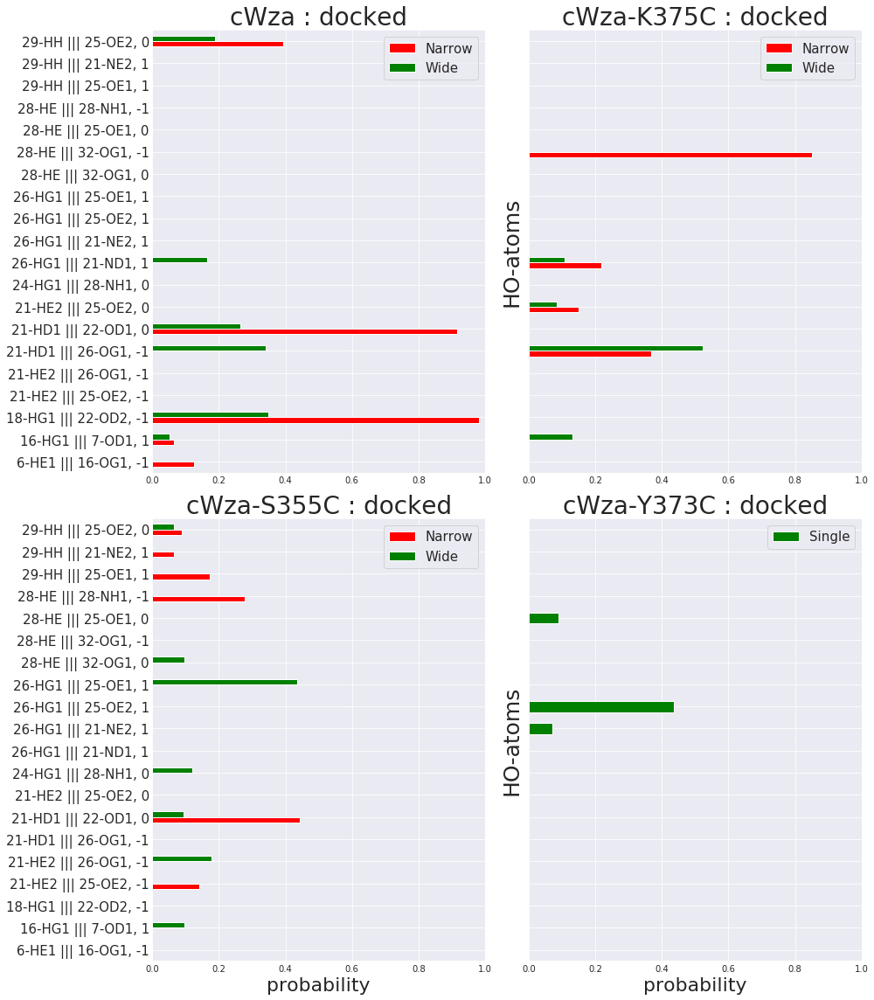

In [37]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

DFColumns = {
    'cWza':[0,1],
    'cWza-K375C':[2,3],
    'cWza-S355C':[4,5],
    'cWza-Y373C':[6]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('HO-atoms', fontsize=25)
ax[1,1].set_ylabel('HO-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

### KIHs

In [419]:
inter_type = 'kihs'

MyTags = [
    json.dumps(['cWza','conformation0']),
    json.dumps(['cWza','conformation1']),
    json.dumps(['cWza-K375C','conformation0']),
    json.dumps(['cWza-K375C','conformation1']),
    json.dumps(['cWza-S355C','conformation0']),
    json.dumps(['cWza-S355C','conformation1']),
    json.dumps(['cWza-Y373C','conformation0'])
]

Superbases = {}
Analyses = {}

for tags in MyTags:
    models = Models(db_path = db_path)
    mutant, group = json.loads(tags)
    models_ids = list(Filtered_IDs[mutant][group])
    models.ids = models_ids
    analysis = Analyse_Interactions(models)
    Analyses[tags] = analysis
    sbase = analysis.superbase(inter_type)
    Superbases[tags] = sbase

Unified superbase

In [420]:
unified_sbase = set()
for sb in list(Superbases.values()):
    unified_sbase = unified_sbase.union(set(sb))

sbase = list(unified_sbase)
sbase = sort_superbase(list(sbase), N_residues=32)

In [421]:
Probabilities = {}
for tags in MyTags:
    analysis = Analyses[tags]
    prob = analysis.interaction_probability(sbase,inter_type)
    Probabilities[tags] = prob
##################################################
tools = Tools()
Labels = tools.labels_df(sbase,inter_type)
##################################################
df = pd.DataFrame(numpy.array(list(Probabilities.values())).T)
tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]

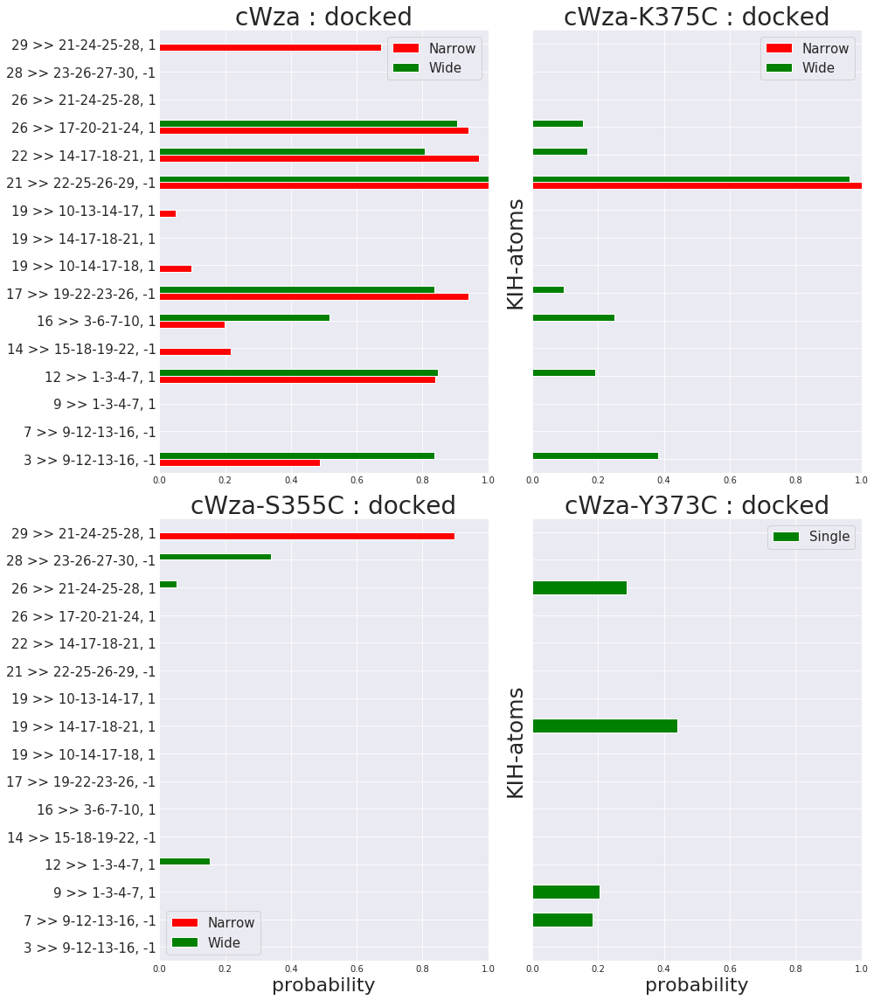

In [422]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

DFColumns = {
    'cWza':[0,1],
    'cWza-K375C':[2,3],
    'cWza-S355C':[4,5],
    'cWza-Y373C':[6]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('KIH-atoms', fontsize=25)
ax[1,1].set_ylabel('KIH-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

## EMMD

In [45]:
path0 = "/home/ba13026/dbs/"
db_path = path0+'mutants_em-conformations_geometry-interactions.db'

### H-bonds

In [46]:
inter_type = 'hbonds'

MyTags = [
    json.dumps(['cWza','em-conformation0']),
    json.dumps(['cWza','em-conformation1']),
    json.dumps(['cWza-K375C','em-conformation0']),
    json.dumps(['cWza-K375C','em-conformation1']),
    json.dumps(['cWza-S355C','em-conformation0']),
    json.dumps(['cWza-S355C','em-conformation1']),
    json.dumps(['cWza-Y373C','em-conformation1'])
]

Superbases = {}
Analyses = {}

for tags in MyTags:
    models = Models(db_path = db_path)
    mutant, group = json.loads(tags)
    models_ids = [x[0] for x in models.session.query(Tags.id).filter_by(mutant=mutant,group=group).all()]
    models.ids = models_ids
    analysis = Analyse_Interactions(models)
    Analyses[tags] = analysis
    sbase = analysis.superbase(inter_type)
    Superbases[tags] = sbase

Unified superbase

In [49]:
unified_sbase = set()
for sb in list(Superbases.values()):
    unified_sbase = unified_sbase.union(set(sb))
    
sbase = list(unified_sbase)
sbase = sort_superbase(list(sbase), N_residues=32)

In [50]:
# Probabilities are determined relative to the superbase
Probabilities = {}
for tags in MyTags:
    analysis = Analyses[tags]
    prob = analysis.interaction_probability(sbase,inter_type)
    Probabilities[tags] = prob
##################################################
tools = Tools()
Labels = tools.labels_df(sbase,inter_type)
##################################################
df = pd.DataFrame(numpy.array(list(Probabilities.values())).T)
tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]

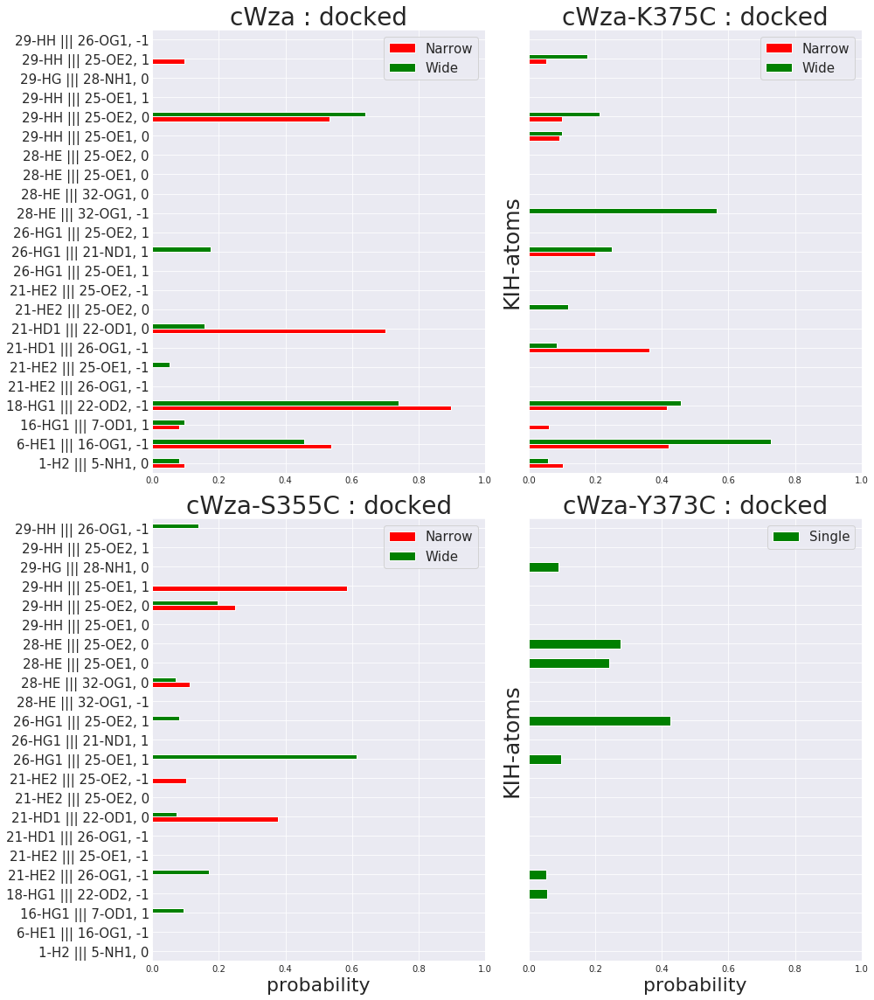

In [51]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

DFColumns = {
    'cWza':[0,1],
    'cWza-K375C':[2,3],
    'cWza-S355C':[4,5],
    'cWza-Y373C':[6]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('KIH-atoms', fontsize=25)
ax[1,1].set_ylabel('KIH-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

### KIHs

In [428]:
inter_type = 'kihs'

MyTags = [
    json.dumps(['cWza','em-conformation0']),
    json.dumps(['cWza','em-conformation1']),
    json.dumps(['cWza-K375C','em-conformation0']),
    json.dumps(['cWza-K375C','em-conformation1']),
    json.dumps(['cWza-S355C','em-conformation0']),
    json.dumps(['cWza-S355C','em-conformation1']),
    json.dumps(['cWza-Y373C','em-conformation1'])
]

Superbases = {}
Analyses = {}

for tags in MyTags:
    models = Models(db_path = db_path)
    mutant, group = json.loads(tags)
    models_ids = [x[0] for x in models.session.query(Tags.id).filter_by(mutant=mutant,group=group).all()]
    models.ids = models_ids
    analysis = Analyse_Interactions(models)
    Analyses[tags] = analysis
    sbase = analysis.superbase(inter_type)
    Superbases[tags] = sbase

Unified superbase

In [429]:
unified_sbase = set()
for sb in list(Superbases.values()):
    unified_sbase = unified_sbase.union(set(sb))
    
sbase = list(unified_sbase)
sbase = sort_superbase(list(sbase), N_residues=32)

In [430]:
# Probabilities are determined relative to the superbase
Probabilities = {}
for tags in MyTags:
    analysis = Analyses[tags]
    prob = analysis.interaction_probability(sbase,inter_type)
    Probabilities[tags] = prob
##################################################
tools = Tools()
Labels = tools.labels_df(sbase,inter_type)
##################################################
df = pd.DataFrame(numpy.array(list(Probabilities.values())).T)
tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]

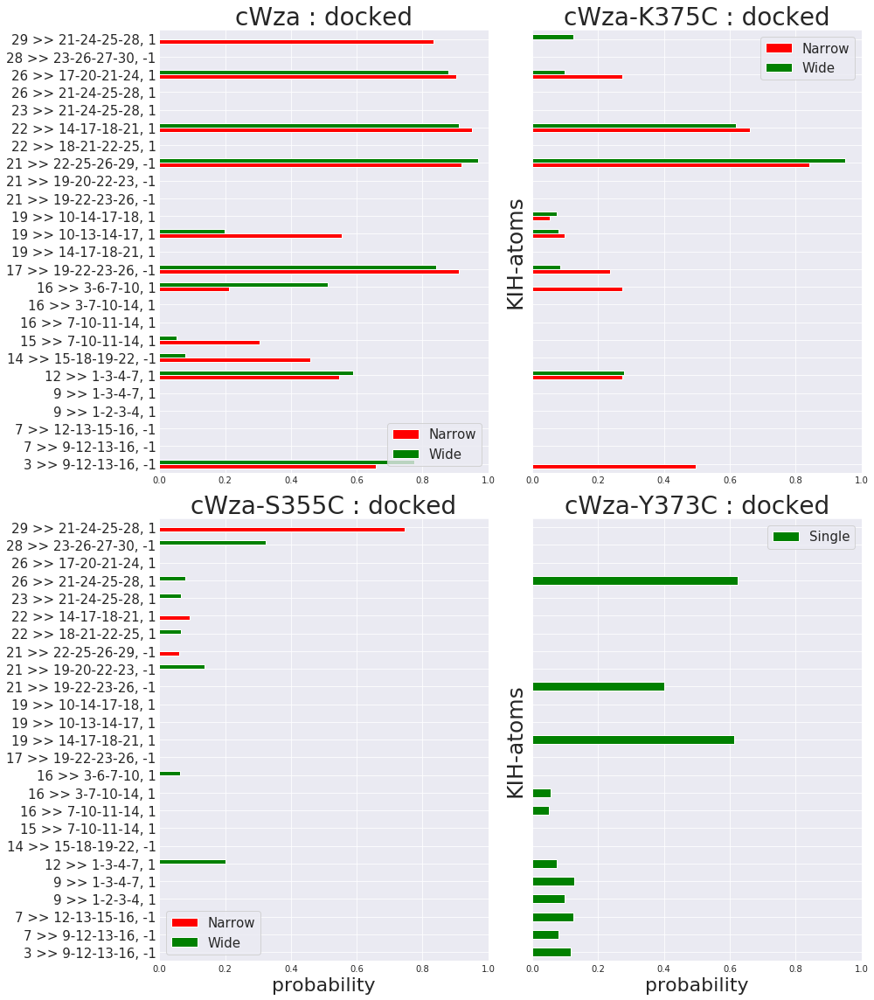

In [431]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

DFColumns = {
    'cWza':[0,1],
    'cWza-K375C':[2,3],
    'cWza-S355C':[4,5],
    'cWza-Y373C':[6]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('KIH-atoms', fontsize=25)
ax[1,1].set_ylabel('KIH-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

# Docked + EMMD

In [2]:
import os
import sys
import numpy
import pandas as pd
import json
import subprocess
import isambard_dev
import operator
from operator import itemgetter
import matplotlib.pyplot as plt
import seaborn as sns

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker

modules_paths = [
    "/home/ba13026/mpmodeling/analysis",
    "/home/ba13026/mpmodeling/protocols"
]

for path in modules_paths:
    if path not in sys.path:
        sys.path.append(path)

In [3]:
from cluster_transfer import BG
        
import setup_geometry_interactions_db
from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base

from insert2db_geometry_interactions import interaction_direction

import geometry_interactions
from geometry_interactions import Models, Analyse_Interactions, start_session, sort_superbase

In [5]:
path0 = BG.workdir
with open(path0+'filtered_ids_new.json','r') as fp:
    Filtered_IDs = json.load(fp)

In [6]:
class MyDB:
    def __init__(self):
        self.db_path = ''
        self.name = ''
        self.tags = []
        self.id_extractor = ''

In [7]:
docked = MyDB()
path0 = BG.workdir
db_path = path0+'mutants_docked_geometry-interactions.db'
docked.db_path = db_path 
docked.name = 'docked'
docked.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation0'])
            ]

def extractor_docked(session, tags):
    mutant, group = json.loads(tags)
    return list(Filtered_IDs[mutant][group])

docked.id_extractor = extractor_docked

In [8]:
emmd = MyDB()
path0 = BG.workdir
db_path = path0+'mutants_em-conformations_geometry-interactions.db'
emmd.db_path = db_path
# emmd.db_path = path0+'mutants_em-conformations_geometry-interactions.db'
emmd.name = 'emmd'
emmd.tags = [
            json.dumps(['cWza','em-conformation0']),
            json.dumps(['cWza','em-conformation1']),
            json.dumps(['cWza-K375C','em-conformation0']),
            json.dumps(['cWza-K375C','em-conformation1']),
            json.dumps(['cWza-S355C','em-conformation0']),
            json.dumps(['cWza-S355C','em-conformation1']),
            json.dumps(['cWza-Y373C','em-conformation1'])
            ]

def extractor_emmd(mysession, tags):
    mutant, group = json.loads(tags)
    return [x[0] for x in mysession.query(Tags.id).filter_by(mutant=mutant,group=group).all()]

emmd.id_extractor = extractor_emmd

LOOP STUFF

In [9]:
inter_type = 'kihs'
Superbases = {}
Interaction_data = {}
Analyses = {}

for stage in [docked, emmd]:
    stage_session = start_session(stage.db_path)
    models = Models(stage_session)
    MyTags = stage.tags 
    Interaction_data[stage.name] = {}
    Superbases[stage.name] = {}
    Analyses[stage.name] = {}
    for tags in MyTags:
        mutant, group = json.loads(tags)
        models.ids = stage.id_extractor(models.session, tags)
        analysis = Analyse_Interactions(models)
        Analyses[stage.name][tags] = analysis
        Interaction_data[stage.name][tags] = analysis.get_interaction_data(inter_type)
        sbase = analysis.get_superbase(inter_type)
        Superbases[stage.name][tags] = sbase

**Unified Superbase of interactions**

In [10]:
def NestedDictValues(d):
    for v in d.values():
        if isinstance(v, dict):
            yield from NestedDictValues(v)
        else:
            yield v

In [11]:
unified_sbase = set()
for sb in list(NestedDictValues(Superbases)):
    unified_sbase = unified_sbase.union(set(sb))
    
sbase = list(unified_sbase)
sbase0 = sort_superbase(list(sbase), N_residues=32)

**Determine all interaction probabilities**

In [14]:
# Probabilities are determined relative to the superbase
Probs = {}
for stage in [docked, emmd]:
    MyTags = stage.tags
    Probs[stage.name] = {}
    for tags in MyTags:
        analysis = Analyses[stage.name][tags]
        atoms = Interaction_data[stage.name][tags]
        stats = analysis.get_interaction_stats(sbase0, atoms)
        prob = analysis.get_interaction_probability(sbase0, stats)
        Probs[stage.name][tags] = prob

tools = geometry_interactions.Tools()
Labels = tools.labels_df(sbase0,inter_type)

In [86]:
SortedData = []
for stage in [docked, emmd]:
    MyTags = stage.tags
    for tag in MyTags:
        SortedData.append(Probs[stage.name][tag])
SortedData = numpy.array(SortedData).T

import pandas as pd
df = pd.DataFrame( SortedData )
tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]

In [68]:
stage = docked

**Plot data**

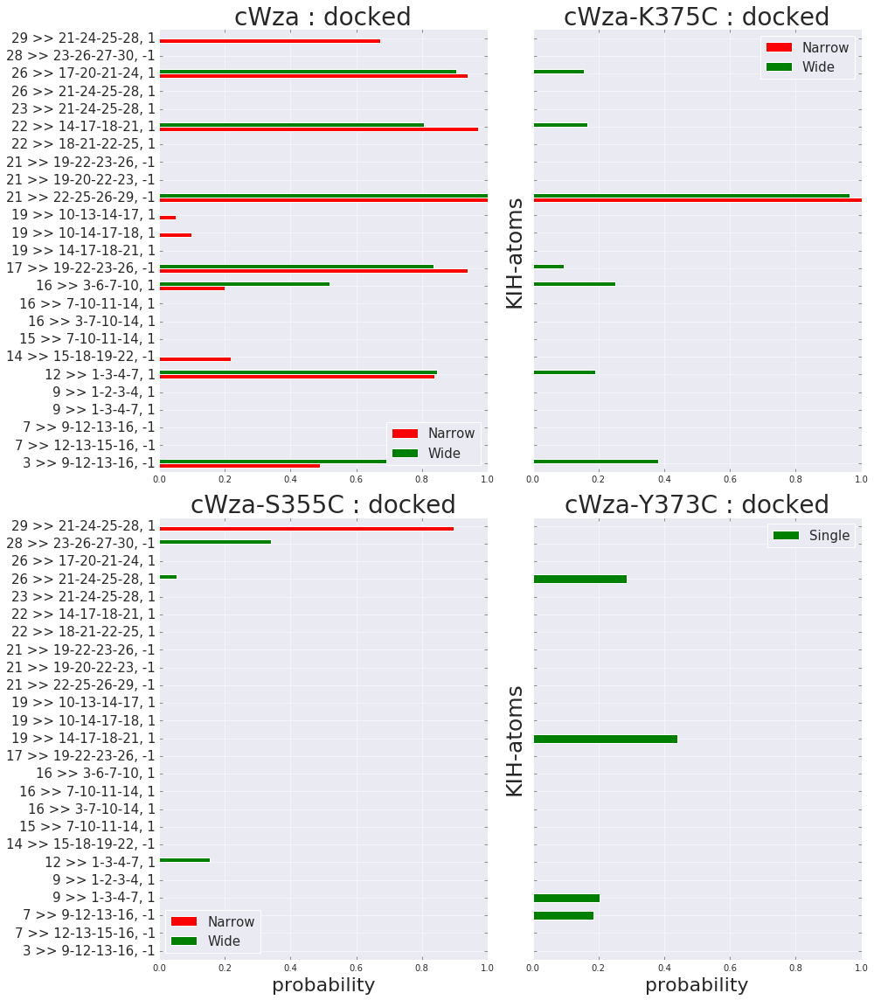

In [89]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}
dc = 0
DFColumns = {
    'cWza':[0+dc,1+dc],
    'cWza-K375C':[2+dc,3+dc],
    'cWza-S355C':[4+dc,5+dc],
    'cWza-Y373C':[6+dc]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('KIH-atoms', fontsize=25)
ax[1,1].set_ylabel('KIH-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

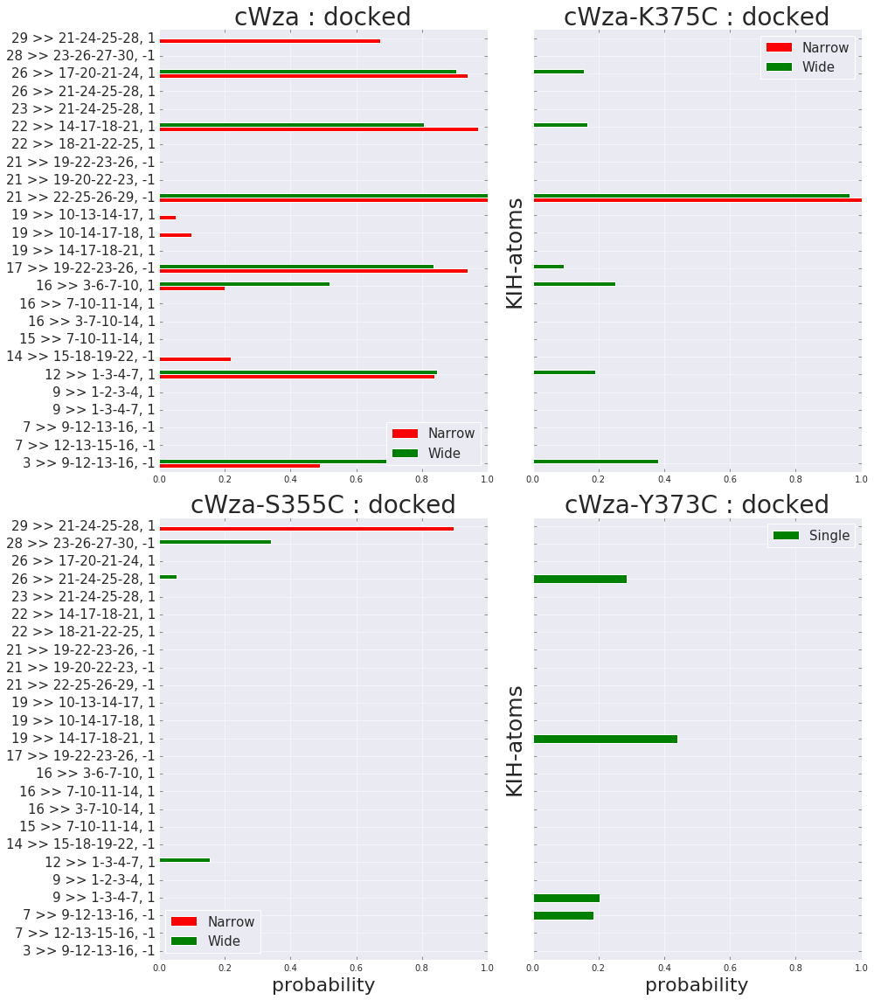

In [70]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}
dc = 0
DFColumns = {
    'cWza':[stage.tags[0+dc],stage.tags[1+dc]],
    'cWza-K375C':[stage.tags[2+dc],stage.tags[3+dc]],
    'cWza-S355C':[stage.tags[4+dc],stage.tags[5+dc]],
    'cWza-Y373C':stage.tags[6+dc]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('KIH-atoms', fontsize=25)
ax[1,1].set_ylabel('KIH-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

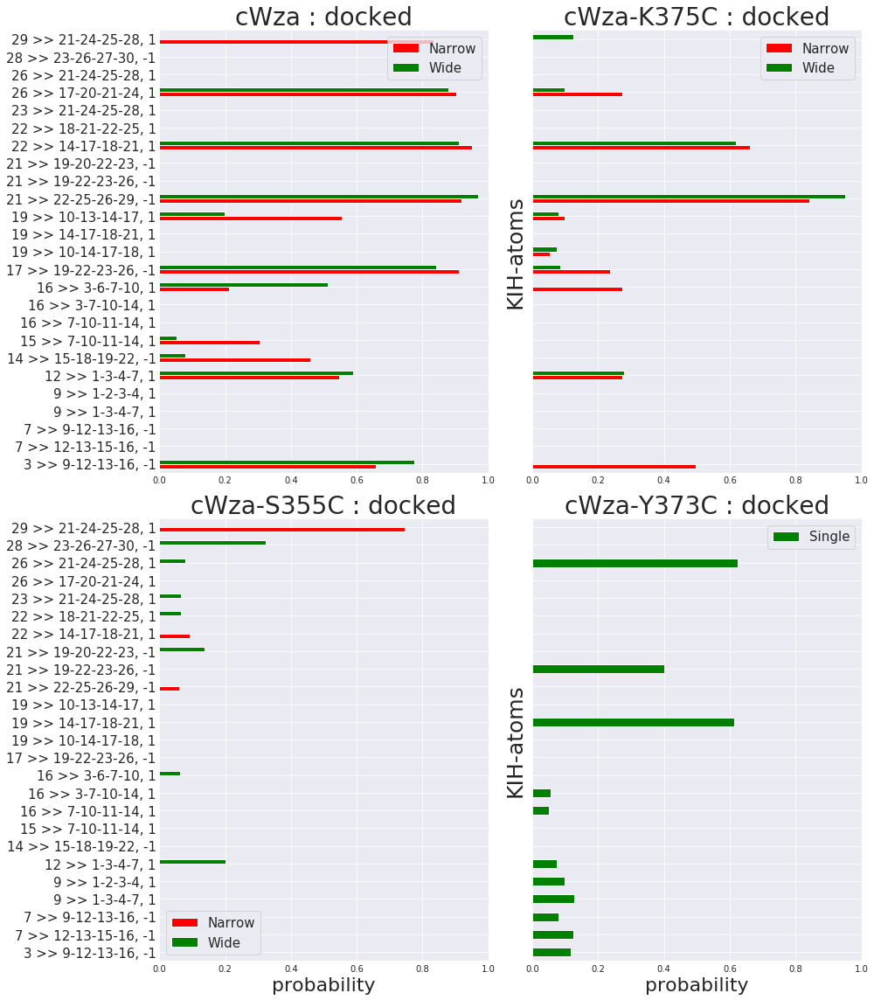

In [12]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}
dc = 7
DFColumns = {
    'cWza':[0+dc,1+dc],
    'cWza-K375C':[2+dc,3+dc],
    'cWza-S355C':[4+dc,5+dc],
    'cWza-Y373C':[6+dc]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('KIH-atoms', fontsize=25)
ax[1,1].set_ylabel('KIH-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

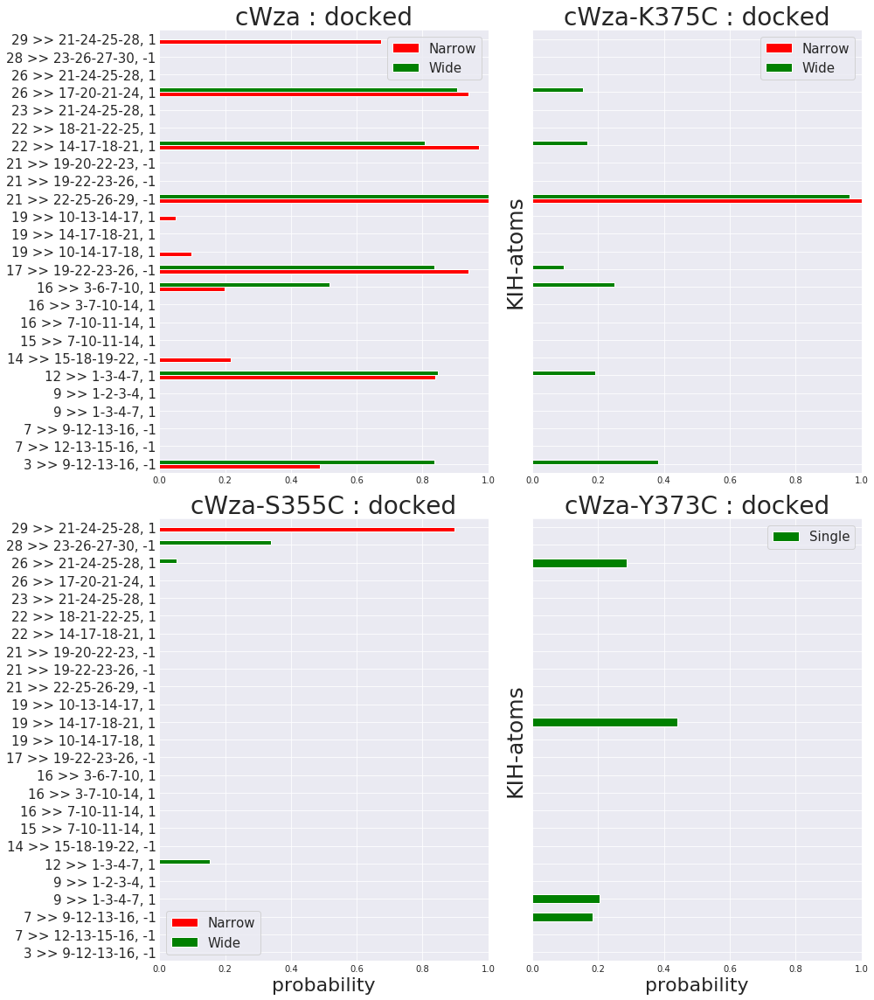

In [14]:
visualise_data0(df, Labels, docked, 0, inter_type)

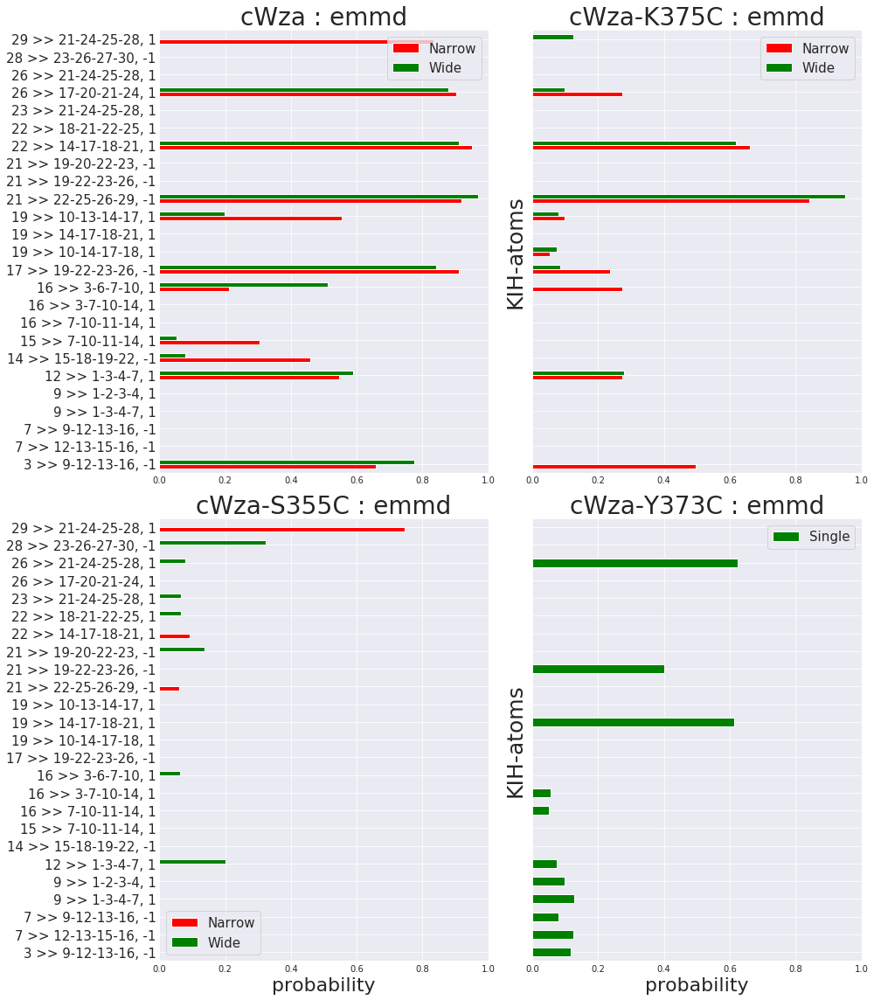

In [15]:
visualise_data0(df, Labels, emmd, 7, inter_type)

COMPARISON

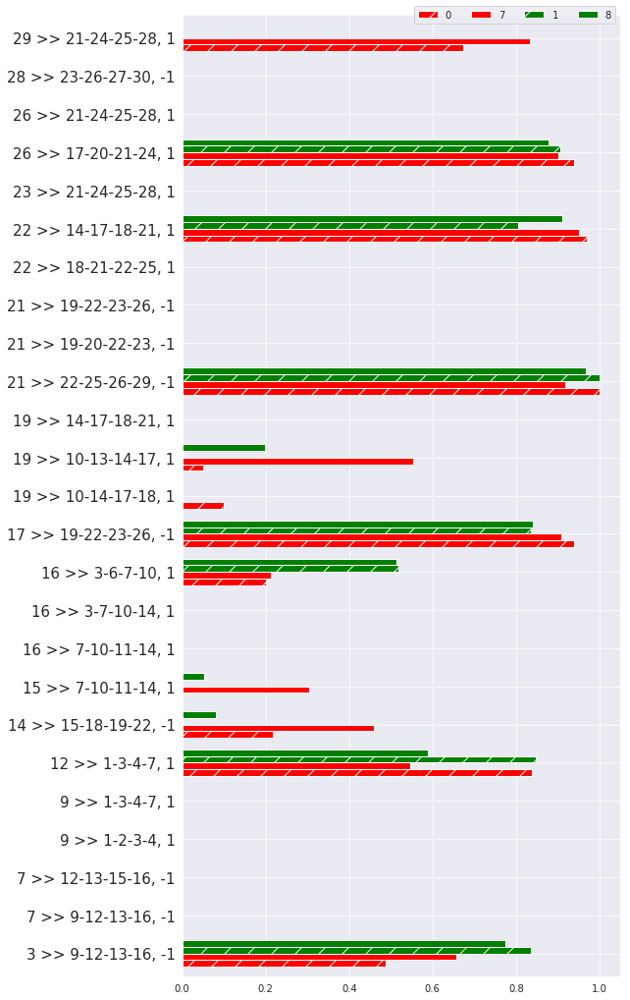

In [13]:
fig,ax = plt.subplots(1,1,figsize=(8,18))
mutant = 'cWza'
df.plot(kind='barh', y=[0,7,1,8],color=['red','red','green','green'],width=0.7,ax=ax)
ax.set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)

bars = ax.patches
hatches = ''.join(h*len(df) for h in '/ / ')

for bar, hatch in zip(bars, hatches):
    bar.set_hatch(hatch)

ax.legend(loc='center right', bbox_to_anchor=(1, 1), ncol=4)

# axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
# axes[mutant].set_xlim(0,1)
# axes[mutant].tick_params(axis='both',direction='in')
# axes[mutant].set_title(mutant+" : docked", fontsize=28)
plt.show()

# PRMD

In [1]:
import os
import sys
import numpy
import json
import subprocess
import isambard_dev
import operator
import pandas as pd
from operator import itemgetter
import matplotlib.pyplot as plt
import seaborn as sns

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker

modules_path = "/home/ba13026/mpmodeling/analysis/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

import setup_geometry_interactions_db

from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base

from insert2db_geometry_interactions import interaction_direction
import geometry_interactions
from geometry_interactions import Models, Analyse_Interactions, start_session, sort_superbase

In [2]:
path0 = '/home/ba13026/dbs/'
db_path = path0 + 'mutants_prmd-conformations_geometry-interactions.db'

In [3]:
dbfile = db_path
engine = create_engine('sqlite:///'+dbfile)
Base.metadata.bind = engine
DBSession = sessionmaker()
DBSession.bind = engine
session = DBSession()

In [4]:
class MyDB:
    def __init__(self):
        self.db_path = ''
        self.name = ''
        self.tags = []
        self.id_extractor = ''

In [22]:
prmd = MyDB()
path0 = "/home/ba13026/dbs/"
db_path = path0+'mutants_prmd-conformations_geometry-interactions.db'
prmd.db_path = db_path
prmd.name = 'prmd'
prmd.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation1'])
            ]

# def extractor_prmd(session, db_tag):
#     mutant, group, pdb_name = json.loads(db_tag)
#     frame_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
#     return frame_id

# prmd.id_extractor = extractor_prmd

In [6]:
def get_ModelsIDs(session):
    inter_tags = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
    }
    with open(path0+'mutants_prmd_conformations_pdb_paths.json','r') as fp:
        DBTags = json.load(fp)
    
    FrameRange = range(40,51) 
    ModelsIDs_per_tag = {}
    
    for tag in prmd.tags:
        ModelsIDs_per_tag[tag] = []
        for info in DBTags:
            mutant, group, pdb_name = info[0]
            conformation, stage_name, frame_no = group.split(':')
            db_tag = json.dumps([mutant, conformation])
            db_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
            if (db_tag == tag) and (int(frame_no) in FrameRange):
                ModelsIDs_per_tag[tag].append(db_id)
    # Find IDs with no interaction data
    IDs_to_remove = []
    for i in range(len(prmd.tags)):
        for id in list(ModelsIDs_per_tag[prmd.tags[i]]):
            for inter_type in inter_tags.keys():
                try:
                    data = session.query(inter_tags[inter_type]).filter_by(id=id).first()[0]
                except:
                    IDs_to_remove.append([prmd.tags[i], id])
    # Remove IDs with no interaction data
    for x in IDs_to_remove:
        tag, id = x
        try:
            ModelsIDs_per_tag[tag].remove(id)
        except:
            pass
    return ModelsIDs_per_tag

def extractor_prmd(session, db_tag):
    ModelsIDs_per_tag = get_ModelsIDs(session)
    return ModelsIDs_per_tag[db_tag]    

prmd.id_extractor = extractor_prmd

In [7]:
ModelsIDs_per_tag = get_ModelsIDs(session)

In [6]:
# Define models' tags
with open(path0+'mutants_prmd_conformations_pdb_paths.json','r') as fp:
    DBTags = json.load(fp)

FrameRange = range(40,51) 

ModelsIDs_per_tag = {}

for tag in prmd.tags:
    ModelsIDs_per_tag[tag] = []
    for info in DBTags:
        mutant, group, pdb_name = info[0]
        conformation, stage_name, frame_no = group.split(':')
        db_tag = json.dumps([mutant, conformation])
        db_id = prmd.id_extractor(session, json.dumps(info[0]))
        if (db_tag == tag) and (int(frame_no) in FrameRange):
            ModelsIDs_per_tag[tag].append(db_id)

In [7]:
IDs_to_remove = []
for i in range(len(prmd.tags)):
    for id in list(ModelsIDs_per_tag[prmd.tags[i]]):
        try:
            data = session.query(Interhelix_Interactions.hbonds).filter_by(id=id).first()[0]
        except:
            IDs_to_remove.append([prmd.tags[i], id])

In [8]:
for x in IDs_to_remove:
    tag, id = x
    ModelsIDs_per_tag[tag].remove(id)

In [10]:
inter_type = 'kihs'
Superbases = {}
Interaction_data = {}
Analyses = {}

for stage in [prmd]:
    stage_session = start_session(stage.db_path)
    models = Models(stage_session)
    MyTags = stage.tags 
    Interaction_data[stage.name] = {}
    Superbases[stage.name] = {}
    Analyses[stage.name] = {}
    for i in range(len(MyTags)):
        tags = MyTags[i]
        mutant, group = json.loads(tags)
        models.ids = ModelsIDs_per_tag[tags]
        analysis = Analyse_Interactions(models)
        Analyses[stage.name][tags] = analysis
        Interaction_data[stage.name][tags] = analysis.get_interaction_data(inter_type)
        sbase = analysis.get_superbase(inter_type)
        Superbases[stage.name][tags] = sbase

In [11]:
def NestedDictValues(d):
    for v in d.values():
        if isinstance(v, dict):
            yield from NestedDictValues(v)
        else:
            yield v

In [12]:
unified_sbase = set()
for sb in list(NestedDictValues(Superbases)):
    unified_sbase = unified_sbase.union(set(sb))

sbase = list(unified_sbase)
sbase0 = sort_superbase(list(sbase), N_residues=32)

**Determine all interaction probabilities**

In [14]:
# Probabilities are determined relative to the superbase
Probs = {}
for stage in [prmd]:
    MyTags = stage.tags
    Probs[stage.name] = {}
    for tags in MyTags:
        analysis = Analyses[stage.name][tags]
        atoms = Interaction_data[stage.name][tags]
        stats = analysis.get_interaction_stats(sbase0, atoms)
        prob = analysis.get_interaction_probability(sbase0, stats)
        Probs[stage.name][tags] = prob

tools = geometry_interactions.Tools()
Labels = tools.labels_df(sbase0,inter_type)

In [15]:
import pandas as pd
df = pd.DataFrame(numpy.array(list( Probs['prmd'].values() )).T)
tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]

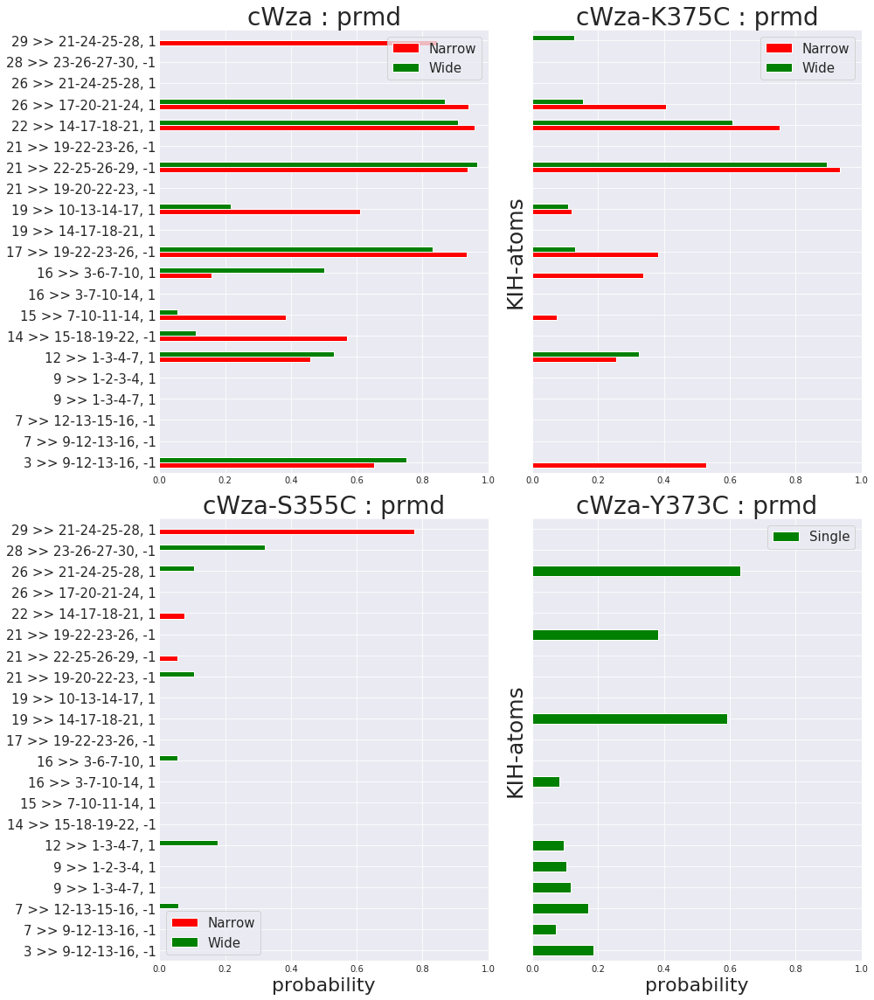

In [17]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}
dc = 0
DFColumns = {
    'cWza':[0+dc,1+dc],
    'cWza-K375C':[2+dc,3+dc],
    'cWza-S355C':[4+dc,5+dc],
    'cWza-Y373C':[6+dc]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : prmd", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('KIH-atoms', fontsize=25)
ax[1,1].set_ylabel('KIH-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

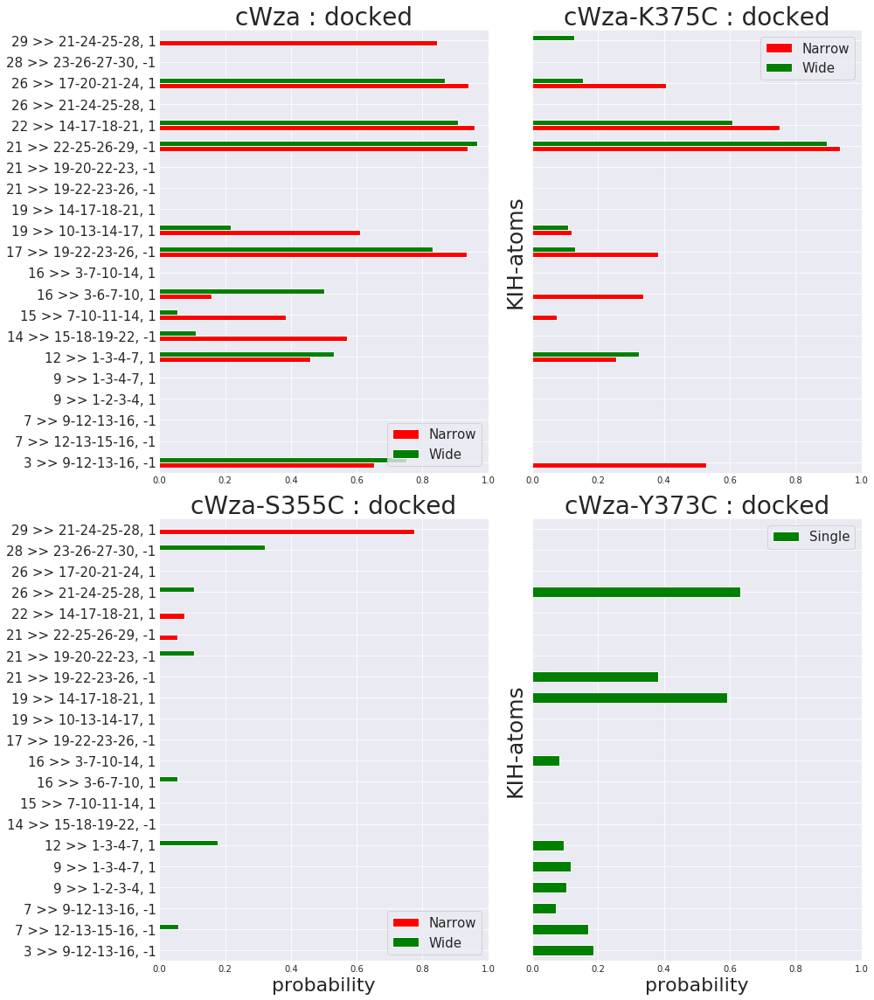

In [14]:
fig,ax = plt.subplots(2,2,figsize=(14,16))

mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}
dc = 0
DFColumns = {
    'cWza':[0+dc,1+dc],
    'cWza-K375C':[2+dc,3+dc],
    'cWza-S355C':[4+dc,5+dc],
    'cWza-Y373C':[6+dc]    
}

Colors = {
    'cWza':['red','green'],
    'cWza-K375C':['red','green'],
    'cWza-S355C':['red','green'],
    'cWza-Y373C':['green']
}

Conformation = {
    'cWza':['Narrow', 'Wide'],
    'cWza-K375C':['Narrow', 'Wide'],
    'cWza-S355C':['Narrow', 'Wide'],
    'cWza-Y373C':['Single'],
}


for mutant in mutant_names:
    df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
    axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
    axes[mutant].set_xlim(0,1)
    axes[mutant].tick_params(axis='both',direction='in')
    axes[mutant].set_title(mutant+" : docked", fontsize=28)

    
ax[1,0].set_xlabel("probability", fontsize=22)
ax[1,1].set_xlabel("probability", fontsize=22)

ax[0,0].set_ylabel("")
ax[1,0].set_ylabel("")
ax[0,1].set_ylabel('KIH-atoms', fontsize=25)
ax[1,1].set_ylabel('KIH-atoms', fontsize=25)
    
axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
axes['cWza-K375C'].set_yticklabels("")
axes['cWza-Y373C'].set_yticklabels("")

fig.tight_layout()

plt.show()

# Docked+EMMD+PRMD

In [114]:
import os
import sys
import numpy
import pandas as pd
import json
import subprocess
import isambard_dev
import operator
from operator import itemgetter
import matplotlib.pyplot as plt
import seaborn as sns

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker

modules_path = "/home/ba13026/mpmodeling/analysis/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

import setup_geometry_interactions_db

from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base

from insert2db_geometry_interactions import interaction_direction
import geometry_interactions
from geometry_interactions import Models, Analyse_Interactions, start_session, sort_superbase

In [115]:
path0 = '/projects/s21/ba13026/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/'

In [116]:
class MyDB:
    def __init__(self):
        self.db_path = ''
        self.name = ''
        self.tags = []
        self.id_extractor = ''

In [117]:
def visualise_data0(df, Labels, stage, dc, inter_type):
    Inter_Labels = {
    'hbonds': 'HO-atoms',
    'kihs': 'KIH-atoms'
        }

    fig,ax = plt.subplots(2,2,figsize=(14,16))

    mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']

    axes = {
        'cWza':ax[0,0],
        'cWza-K375C':ax[0,1],
        'cWza-S355C':ax[1,0],
        'cWza-Y373C':ax[1,1]
    }

    DFColumns = {
        'cWza':[0+dc,1+dc],
        'cWza-K375C':[2+dc,3+dc],
        'cWza-S355C':[4+dc,5+dc],
        'cWza-Y373C':[6+dc]    
    }

    Colors = {
        'cWza':['blue','green'],
        'cWza-K375C':['blue','green'],
        'cWza-S355C':['blue','green'],
        'cWza-Y373C':['blue']
    }

    Conformation = {
        'cWza':['Narrow', 'Wide'],
        'cWza-K375C':['Narrow', 'Wide'],
        'cWza-S355C':['Narrow', 'Wide'],
        'cWza-Y373C':['Single'],
    }


    for mutant in mutant_names:
        df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
        axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
        axes[mutant].set_xlim(0,1)
        axes[mutant].tick_params(axis='both',direction='in')
        axes[mutant].set_title(mutant+" : "+stage.name, fontsize=28)


    ax[1,0].set_xlabel("probability", fontsize=22)
    ax[1,1].set_xlabel("probability", fontsize=22)

    ax[0,0].set_ylabel("")
    ax[1,0].set_ylabel("")
    ax[0,1].set_ylabel(Inter_Labels[inter_type], fontsize=25)
    ax[1,1].set_ylabel(Inter_Labels[inter_type], fontsize=25)

    axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
    axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
    axes['cWza-K375C'].set_yticklabels("")
    axes['cWza-Y373C'].set_yticklabels("")

    fig.tight_layout()

    plt.show()

**Define MyDB objects per MD stage**

In [118]:
docked = MyDB()
db_path = path0+'mutants_docked_geometry-interactions.db'
docked.db_path = db_path 
docked.name = 'docked'
docked.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation0'])
            ]

##########################################################
# STUFF FOR DATABASE ID EXTRACTION
##########################################################
with open(path0+'filtered_ids_new.json','r') as fp:
    Filtered_IDs = json.load(fp)

def extractor_docked(session, tags):
    mutant, group = json.loads(tags)
    return list(Filtered_IDs[mutant][group])

##########################################################
docked.id_extractor = extractor_docked

In [119]:
emmd = MyDB()
db_path = path0+'mutants_em-conformations_geometry-interactions.db'
emmd.db_path = db_path
emmd.name = 'emmd'
emmd.tags = [
            json.dumps(['cWza','em-conformation0']),
            json.dumps(['cWza','em-conformation1']),
            json.dumps(['cWza-K375C','em-conformation0']),
            json.dumps(['cWza-K375C','em-conformation1']),
            json.dumps(['cWza-S355C','em-conformation0']),
            json.dumps(['cWza-S355C','em-conformation1']),
            json.dumps(['cWza-Y373C','em-conformation1'])
            ]

##########################################################
# STUFF FOR DATABASE ID EXTRACTION
##########################################################
def extractor_emmd(mysession, tags):
    mutant, group = json.loads(tags)
    return [x[0] for x in mysession.query(Tags.id).filter_by(mutant=mutant,group=group).all()]

##########################################################
emmd.id_extractor = extractor_emmd

In [120]:
prmd = MyDB()
db_path = path0+'mutants_prmd-conformations_geometry-interactions.db'
prmd.db_path = db_path
prmd.name = 'prmd'
prmd.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation1'])
            ]

##########################################################
# STUFF FOR DATABASE ID EXTRACTION
##########################################################
def get_ModelsIDs_prmd(session):
    inter_tags = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
    }
    with open(path0+'mutants_prmd_conformations_pdb_paths.json','r') as fp:
        DBTags = json.load(fp)
    
    FrameRange = range(40,51) 
    ModelsIDs_per_tag = {}
    
    for tag in prmd.tags:
        ModelsIDs_per_tag[tag] = []
        for info in DBTags:
            mutant, group, pdb_name = info[0]
            conformation, stage_name, frame_no = group.split(':')
            db_tag = json.dumps([mutant, conformation])
            db_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
            if (db_tag == tag) and (int(frame_no) in FrameRange):
                ModelsIDs_per_tag[tag].append(db_id)
    # Find IDs with no interaction data
    IDs_to_remove = []
    for i in range(len(prmd.tags)):
        for id in list(ModelsIDs_per_tag[prmd.tags[i]]):
            for inter_type in inter_tags.keys():
                try:
                    data = session.query(inter_tags[inter_type]).filter_by(id=id).first()[0]
                except:
                    IDs_to_remove.append([prmd.tags[i], id])
    # Remove IDs with no interaction data
    for x in IDs_to_remove:
        tag, id = x
        try:
            ModelsIDs_per_tag[tag].remove(id)
        except:
            pass
    return ModelsIDs_per_tag

def extractor_prmd(session, db_tag):
    ModelsIDs_per_tag = get_ModelsIDs_prmd(session)
    return ModelsIDs_per_tag[db_tag]    

##########################################################
prmd.id_extractor = extractor_prmd

In [94]:
urmd = MyDB()
db_path = path0+'mutants_urmd-conformations_geometry-interactions.db'
urmd.db_path = db_path
urmd.name = 'urmd'
urmd.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation1'])
            ]

##########################################################
# STUFF FOR DATABASE ID EXTRACTION
##########################################################
def get_ModelsIDs_urmd(session):
    inter_tags = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
    }
    with open(path0+'mutants_urmd_conformations_pdb_paths.json','r') as fp:
        DBTags = json.load(fp)
    
    FrameRange = range(90,101) 
    ModelsIDs_per_tag = {}
    
    for tag in urmd.tags:
        ModelsIDs_per_tag[tag] = []
        for info in DBTags:
            mutant, group, pdb_name = info[0]
            conformation, stage_name, frame_no = group.split(':')
            db_tag = json.dumps([mutant, conformation])
            db_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
            if (db_tag == tag) and (int(frame_no) in FrameRange):
                ModelsIDs_per_tag[tag].append(db_id)
    # Find IDs with no interaction data
    IDs_to_remove = []
    for i in range(len(urmd.tags)):
        for id in list(ModelsIDs_per_tag[urmd.tags[i]]):
            for inter_type in inter_tags.keys():
                try:
                    data = session.query(inter_tags[inter_type]).filter_by(id=id).first()[0]
                except:
                    IDs_to_remove.append([urmd.tags[i], id])
    # Remove IDs with no interaction data
    for x in IDs_to_remove:
        tag, id = x
        try:
            ModelsIDs_per_tag[tag].remove(id)
        except:
            pass
    return ModelsIDs_per_tag

def extractor_urmd(session, db_tag):
    ModelsIDs_per_tag = get_ModelsIDs_urmd(session)
    return ModelsIDs_per_tag[db_tag]    

##########################################################
urmd.id_extractor = extractor_urmd

**Loop over all MD stages**

In [121]:
inter_type = 'kihs'

In [122]:
Superbases = {}
Interaction_data = {}
Analyses = {}

for stage in [docked, emmd, prmd]:
    stage_session = start_session(stage.db_path)
    models = Models(stage_session)
    MyTags = stage.tags 
    Interaction_data[stage.name] = {}
    Superbases[stage.name] = {}
    Analyses[stage.name] = {}
    for tags in MyTags:
        mutant, group = json.loads(tags)
        models.ids = stage.id_extractor(models.session, tags)
        analysis = Analyse_Interactions(models)
        Analyses[stage.name][tags] = analysis
        Interaction_data[stage.name][tags] = analysis.get_interaction_data(inter_type)
        sbase = analysis.get_superbase(inter_type)
        Superbases[stage.name][tags] = sbase

**Save dicts for later use**

In [97]:
with open(path0+'H-bonds_Interaction_data_docked_emmd_prmd_urmd.json','w') as fp:
    json.dump(Interaction_data, fp, sort_keys=True, indent=4)

In [98]:
with open(path0+'H-bonds_Superbases_docked_emmd_prmd_urmd.json','w') as fp:
    json.dump(Superbases, fp, sort_keys=True, indent=4)

**Unified Superbase of interactions**

In [39]:
def NestedDictValues(d):
    for v in d.values():
        if isinstance(v, dict):
            yield from NestedDictValues(v)
        else:
            yield v

In [40]:
unified_sbase = set()
for sb in list(NestedDictValues(Superbases)):
    unified_sbase = unified_sbase.union(set(sb))
    
sbase = list(unified_sbase)
sbase0 = sort_superbase(list(sbase), N_residues=32)

**Determine all interaction probabilities**

In [41]:
# Probabilities are determined relative to the superbase
Probs = {}
for stage in [docked, emmd, prmd]:
    MyTags = stage.tags
    Probs[stage.name] = {}
    for tags in MyTags:
        analysis = Analyses[stage.name][tags]
        atoms = Interaction_data[stage.name][tags]
        stats = analysis.get_interaction_stats(sbase0, atoms)
        prob = analysis.get_interaction_probability(sbase0, stats)
        Probs[stage.name][tags] = prob

tools = geometry_interactions.Tools()
Labels = tools.labels_df(sbase0,inter_type)

In [72]:
MyTags  = [
    json.dumps(['cWza', 'conformation0']),
    json.dumps(['cWza', 'conformation1']),
    json.dumps(['cWza-K375C', 'conformation0']),
    json.dumps(['cWza-K375C', 'conformation1']),
    json.dumps(['cWza-S355C', 'conformation0']),
    json.dumps(['cWza-S355C', 'conformation1']),
    json.dumps(['cWza-Y373C', 'conformation1'])
]

In [81]:
list(Probs[xxmd].keys())

['["cWza", "conformation0"]',
 '["cWza-S355C", "conformation1"]',
 '["cWza-K375C", "conformation1"]',
 '["cWza-S355C", "conformation0"]',
 '["cWza-Y373C", "conformation0"]',
 '["cWza-K375C", "conformation0"]',
 '["cWza", "conformation1"]']

In [79]:
import pandas as pd

XX = []
for xxmd in ['docked','emmd','prmd']:
    for tags in prmd.tags:
        XX = XX + list(Probs[xxmd][tags])

df = pd.DataFrame(numpy.array(XX).T)

tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]

KeyError: '["cWza-Y373C", "conformation1"]'

In [78]:
list(Probs[xxmd]['["cWza", "conformation0"]'])

[0.0,
 0.0,
 0.0,
 0.48853211009174313,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.83801605504587151,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.21788990825688073,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.19954128440366972,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.94036697247706424,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.098910550458715593,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.050458715596330278,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0

In [43]:
df.to_json(path0+'df_KIHs_docked_emmd_prmd.json')

**Plot data**

<IPython.core.display.Javascript object>


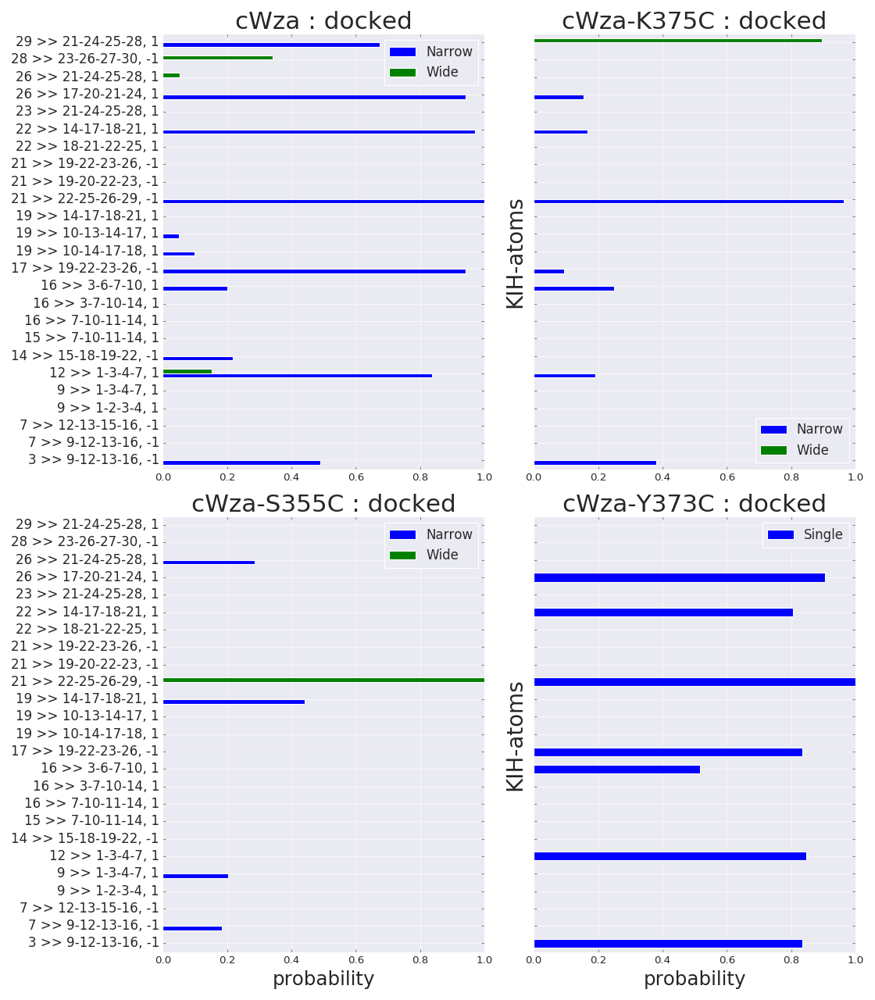

In [44]:
stage = docked
dc = 0
visualise_data0(df, Labels, stage, dc, inter_type)

<IPython.core.display.Javascript object>


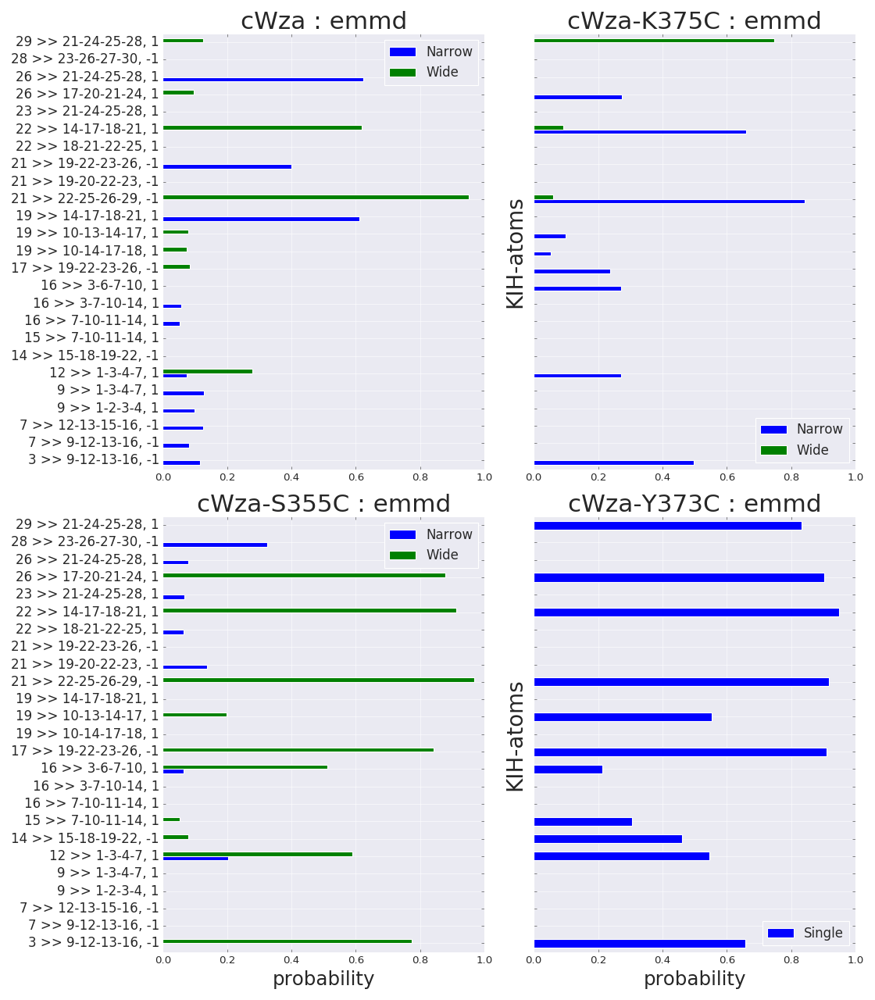

In [45]:
stage = emmd
dc = 7
visualise_data0(df, Labels, stage, dc, inter_type)

<IPython.core.display.Javascript object>


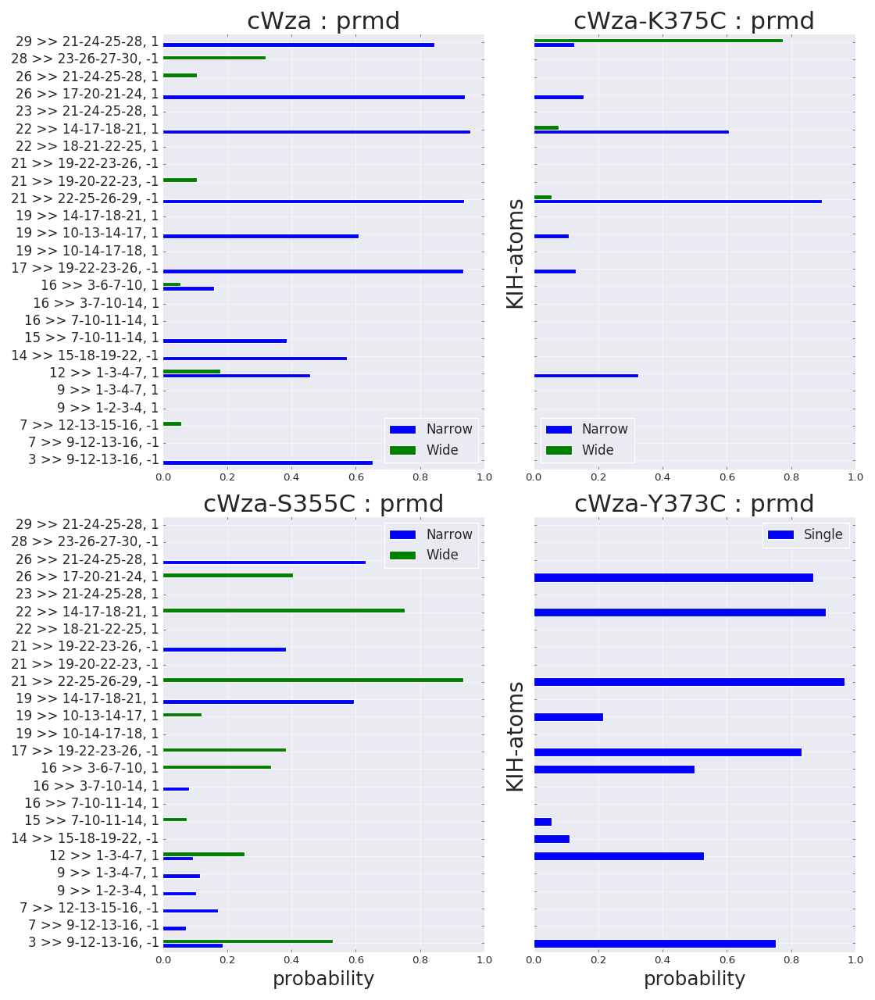

In [46]:
stage = prmd
dc = 14
visualise_data0(df, Labels, stage, dc, inter_type)

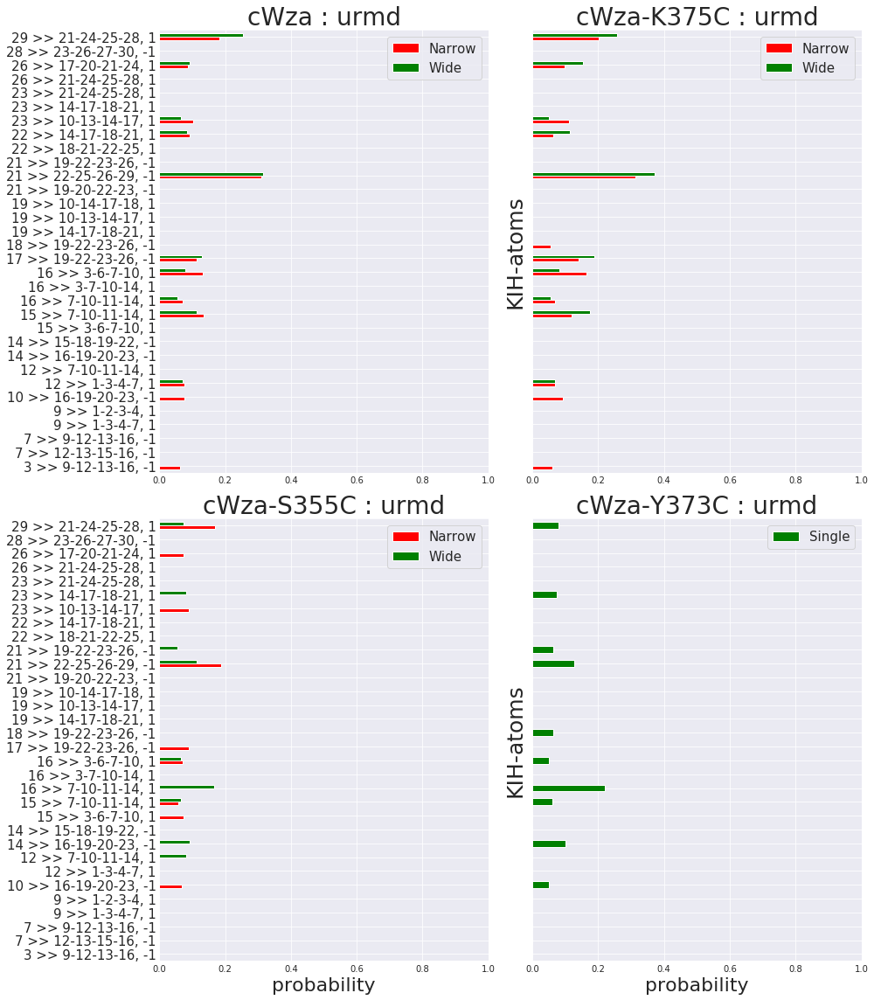

In [121]:
stage = urmd
dc = 21
visualise_data0(df, Labels, stage, dc, inter_type)

**H-bonds**

In [122]:
inter_type = 'hbonds'

In [123]:
Superbases = {}
Interaction_data = {}
Analyses = {}

for stage in [docked, emmd, prmd, urmd]:
    stage_session = start_session(stage.db_path)
    models = Models(stage_session)
    MyTags = stage.tags 
    Interaction_data[stage.name] = {}
    Superbases[stage.name] = {}
    Analyses[stage.name] = {}
    for tags in MyTags:
        mutant, group = json.loads(tags)
        models.ids = stage.id_extractor(models.session, tags)
        analysis = Analyse_Interactions(models)
        Analyses[stage.name][tags] = analysis
        Interaction_data[stage.name][tags] = analysis.get_interaction_data(inter_type)
        sbase = analysis.get_superbase(inter_type)
        Superbases[stage.name][tags] = sbase

**Save dicts for later use**

In [124]:
with open(path0+'H-bonds_Interaction_data_docked_emmd_prmd_urmd.json','w') as fp:
    json.dump(Interaction_data, fp, sort_keys=True, indent=4)

In [125]:
with open(path0+'H-bonds_Superbases_docked_emmd_prmd_urmd.json','w') as fp:
    json.dump(Superbases, fp, sort_keys=True, indent=4)

**Unified Superbase of interactions**

In [126]:
def NestedDictValues(d):
    for v in d.values():
        if isinstance(v, dict):
            yield from NestedDictValues(v)
        else:
            yield v

In [127]:
unified_sbase = set()
for sb in list(NestedDictValues(Superbases)):
    unified_sbase = unified_sbase.union(set(sb))
    
sbase = list(unified_sbase)
sbase0 = sort_superbase(list(sbase), N_residues=32)

**Determine all interaction probabilities**

In [128]:
# Probabilities are determined relative to the superbase
Probs = {}
for stage in [docked, emmd, prmd, urmd]:
    MyTags = stage.tags
    Probs[stage.name] = {}
    for tags in MyTags:
        analysis = Analyses[stage.name][tags]
        atoms = Interaction_data[stage.name][tags]
        stats = analysis.get_interaction_stats(sbase0, atoms)
        prob = analysis.get_interaction_probability(sbase0, stats)
        Probs[stage.name][tags] = prob

tools = geometry_interactions.Tools()
Labels = tools.labels_df(sbase0,inter_type)

In [135]:
import pandas as pd
df = pd.DataFrame(numpy.array(
                            list(Probs['docked'].values())+
                            list(Probs['emmd'].values()) + 
                            list(Probs['prmd'].values()) + 
                            list(Probs['urmd'].values())
                            ).T)
tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]

In [136]:
df.to_json(path0+'df_H-bonds_docked_emmd_prmd_urmd.json')

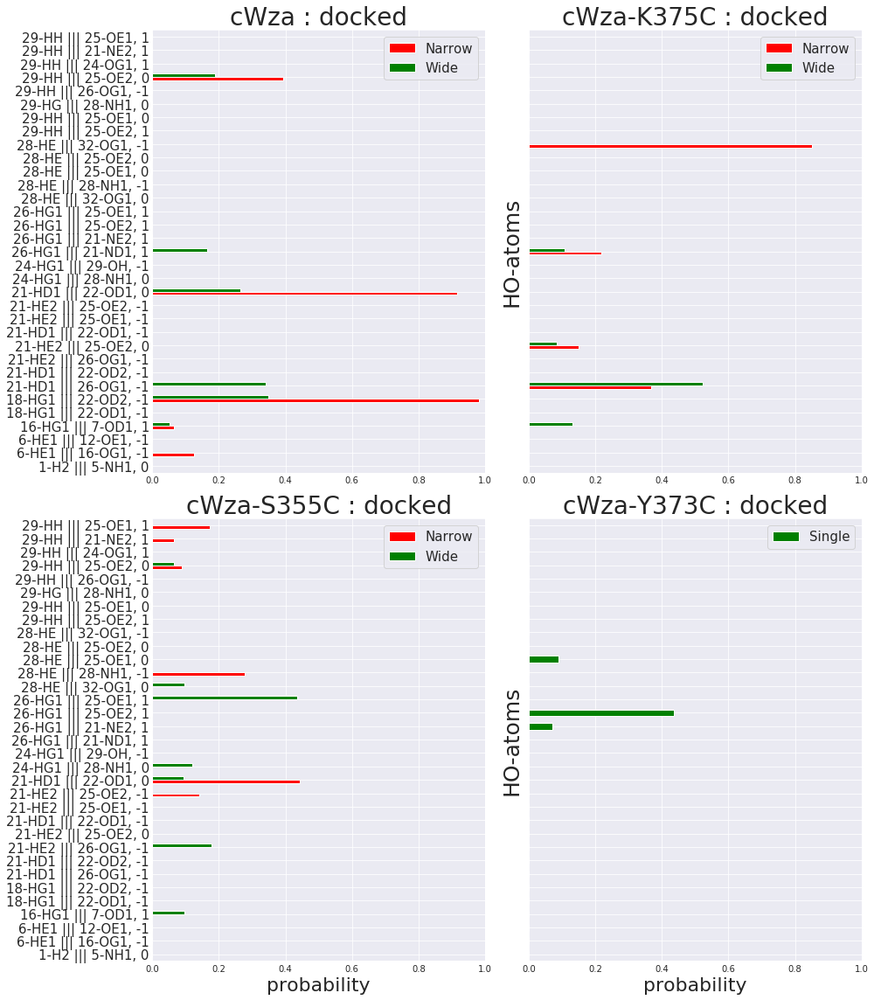

In [137]:
stage = docked
dc = 0
visualise_data0(df, Labels, stage, dc, inter_type)

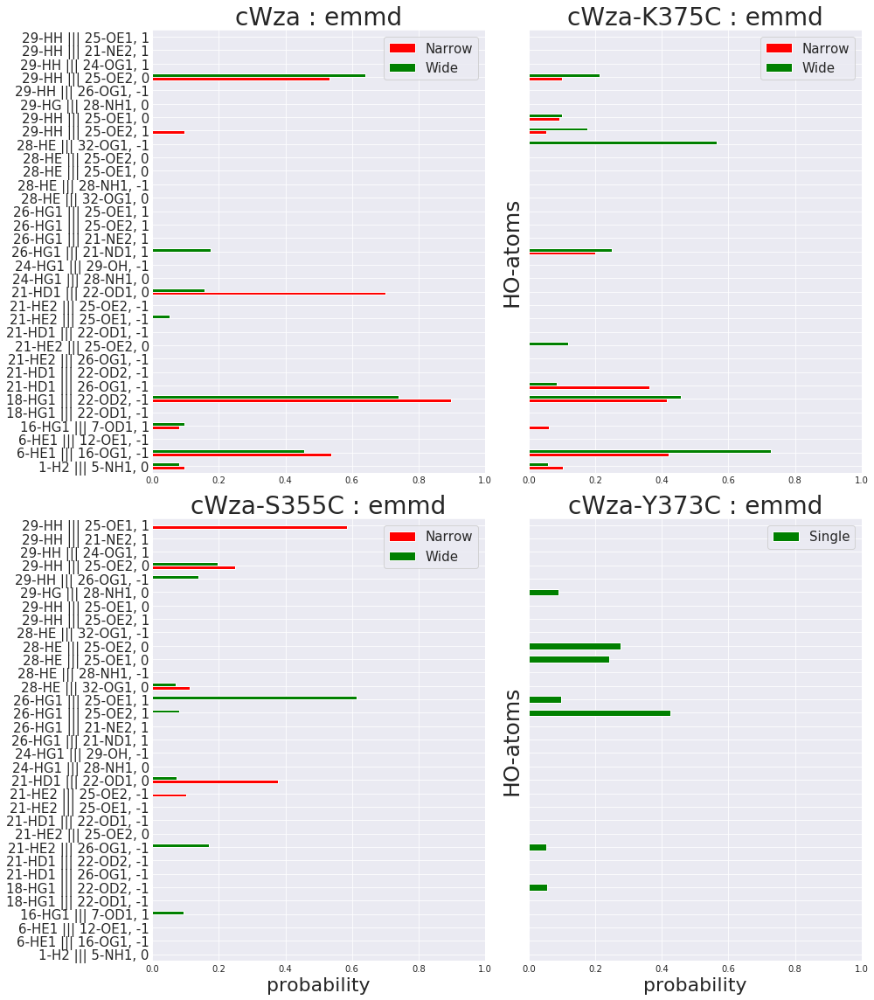

In [138]:
stage = emmd
dc = 7
visualise_data0(df, Labels, stage, dc, inter_type)

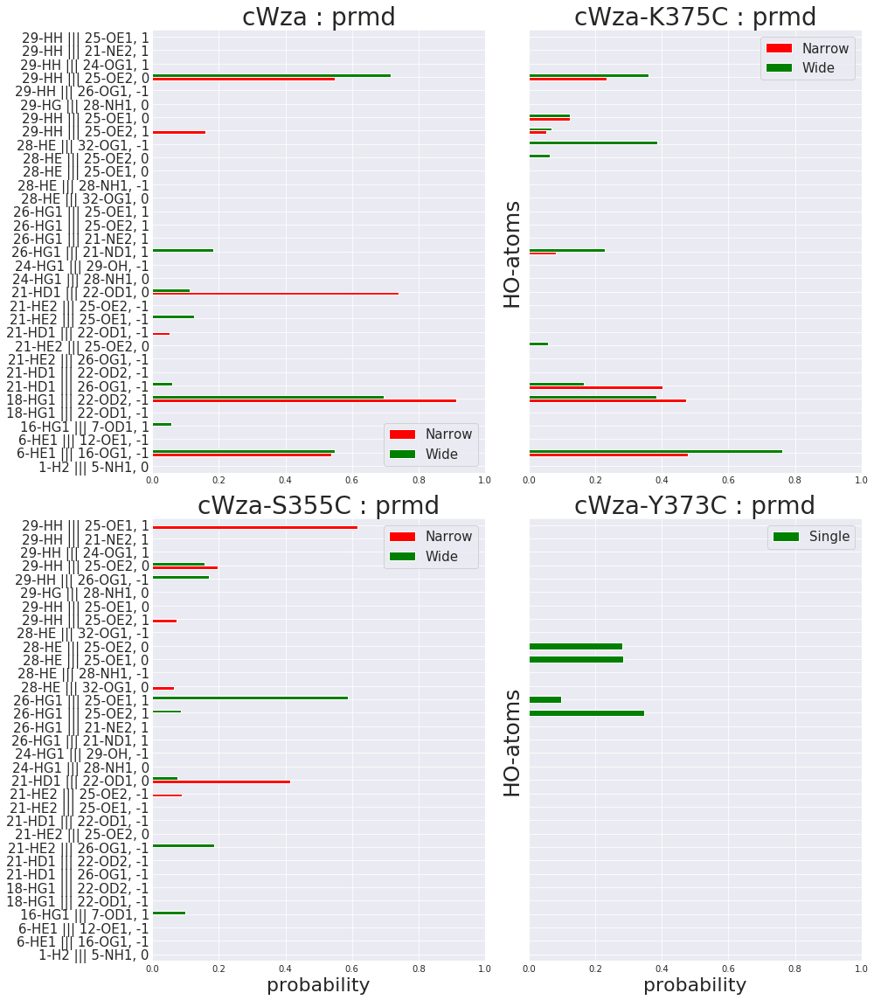

In [139]:
stage = prmd
dc = 14
visualise_data0(df, Labels, stage, dc, inter_type)

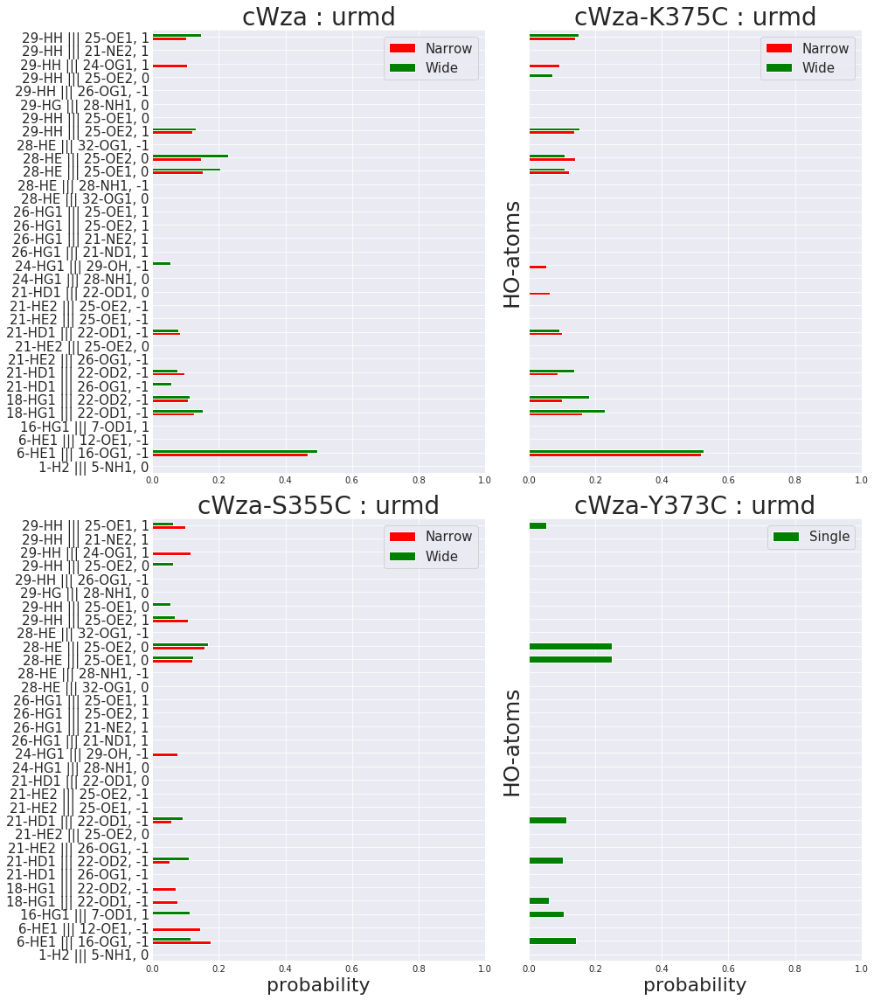

In [248]:
stage = urmd
dc = 21
visualise_data0(df, Labels, stage, dc, inter_type)

# URMD

## Interaction analysis per trajectory interval

FIRST, Get all model tags 

In [147]:
import json
bg_path = '/projects/s21/ba13026/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/'
path0 = '/home/ba13026/dbs/'
param_list = [x.strip() for x in open(path0+'bg+bc4_finished_md_100ns.txt').readlines()]

In [64]:
name = 'md_100ns'
N_frames = 101
FrameRange = range(0,N_frames)
PDB_Paths = []

for x in param_list:
    model_dir = bg_path+x
    frames_dir = model_dir+'/complex/mdf/'+name    
    for n in FrameRange:
        # Get PDB tags
        mutant, group_raw, pdb_name =  x.split("/")
        group = group_raw+':'+'urmd'+':'+str(n)
        tags = [mutant, group, pdb_name]
        # Get PDB path
        pdb_path = frames_dir+'/'+'Protein_'+str(n)+'.pdb'
        PDB_Paths.append([tags, pdb_path])

filename = path0+'mutants_urmd_conformations_pdb_paths.json'
data = PDB_Paths
with open(filename,'w') as fp:
    json.dump(data, fp, sort_keys=True, indent=4)

fp.close()

Analyse geometry/interactions for consecutive trajectory intervals for `md_100ns` simulations.

In [147]:
import json
bg_path = '/projects/s21/ba13026/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/'
path0 = '/home/ba13026/dbs/'
param_list = [x.strip() for x in open(path0+'bg+bc4_finished_md_100ns.txt').readlines()]

In [195]:
chunk_length = 10
for n in list(range(0,90,chunk_length)):
    FrameRange = range(n, n+chunk_length+1)
    PDB_Paths = []
    for x in param_list:
        model_dir = bg_path+x
        frames_dir = model_dir+'/complex/mdf/'+name
        for i in FrameRange:
            # Get PDB tags
            mutant, group_raw, pdb_name =  x.split("/")
            group = group_raw+':'+'urmd'+':'+str(i)
            tags = [mutant, group, pdb_name]
            # Get PDB path
            pdb_path = frames_dir+'/'+'Protein_'+str(i)+'.pdb'
            PDB_Paths.append([tags, pdb_path])
    # Save data into JSON file
    filename = path0+'mutants_urmd_'+str(n)+'-'+str(n+chunk_length)+'ns-conformations_pdb_paths.json'
    data = PDB_Paths
    with open(filename,'w') as fp:
        json.dump(data, fp, sort_keys=True, indent=4)
    fp.close()

Make `slurm scripts`

In [209]:
def make_slurm_script(n):
    script = (
    "#!/bin/bash -login\n"
    "#SBATCH -p cpu\n"
    "#SBATCH -A S2.1\n"
    "#SBATCH -o output_db_insert_urmd_"+str(n)+"-"+str(n+10)+"ns.log\n"
    "#SBATCH -e error_db_insert_urmd_"+str(n)+"-"+str(n+10)+"ns.log\n"
    "#SBATCH -N 1\n"
    "#SBATCH --exclusive\n"
    "#SBATCH --ntasks-per-node=1\n"
    "#SBATCH -t 0:30:00\n"
    "\n"
        "python ~/mpmodeling/analysis/insert2db_geometry_interactions.py "
        "mutants_urmd_"+str(n)+"-"+str(n+10)+"ns-conformations_geometry-interactions.db "
        "mutants_urmd_"+str(n)+"-"+str(n+10)+"ns-conformations_pdb_paths.json 16\n"
    )
    return script

In [220]:
target_path = "/home/ba13026/research/bg/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/md_100ns_dbs/"

In [222]:
chunk_length = 10
for n in list(range(10,90,chunk_length)):
    filename = 'db_insert_urmd_'+str(n)+'-'+str(n+10)+'ns.slurm'
    with open(target_path+filename,'w') as fp:
        fp.write(make_slurm_script(n))
    fp.close()

Then, submit files using `sbatch` as usual.

## Script for running

In [122]:
%%writefile /home/ba13026/mpmodeling/analysis/interaction_analysis_all_dbs.py
import os
import sys
import numpy
import pandas as pd
import json
import subprocess
import isambard_dev
import operator
import matplotlib.pyplot as plt
plt.switch_backend('agg')
from operator import itemgetter
import seaborn as sns

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker
##########################################################
modules_paths = [
    "/home/ba13026/mpmodeling/analysis",
    "/home/ba13026/mpmodeling/protocols"
]

for path in modules_paths:
    if path not in sys.path:
        sys.path.append(path)
##########################################################
from cluster_transfer import BG
        
import setup_geometry_interactions_db
from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base

from insert2db_geometry_interactions import interaction_direction

import geometry_interactions
from geometry_interactions import Models, Analyse_Interactions, start_session, sort_superbase
##########################################################
inter_type = sys.argv[1] # Define either 'kihs' or 'hbonds'
start_frame_no = int(sys.argv[2])
WD = BG.workdir+'md_100ns_dbs/'
##########################################################
class MyDB:
    def __init__(self):
        self.db_path = ''
        self.name = ''
        self.tags = []
        self.id_extractor = ''
##########################################################
# DOCKED MODELS
docked = MyDB()
db_path = WD+'mutants_docked_geometry-interactions.db'
docked.db_path = db_path 
docked.name = 'docked'
docked.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation0'])
            ]

# STUFF FOR DATABASE ID EXTRACTION
with open(WD+'filtered_ids_new.json','r') as fp:
    Filtered_IDs = json.load(fp)

def extractor_docked(session, tags):
    mutant, group = json.loads(tags)
    return list(Filtered_IDs[mutant][group])

docked.id_extractor = extractor_docked
##########################################################
# EMMD MODELS
emmd = MyDB()
db_path = WD+'mutants_em-conformations_geometry-interactions.db'
emmd.db_path = db_path
emmd.name = 'emmd'
emmd.tags = [
            json.dumps(['cWza','em-conformation0']),
            json.dumps(['cWza','em-conformation1']),
            json.dumps(['cWza-K375C','em-conformation0']),
            json.dumps(['cWza-K375C','em-conformation1']),
            json.dumps(['cWza-S355C','em-conformation0']),
            json.dumps(['cWza-S355C','em-conformation1']),
            json.dumps(['cWza-Y373C','em-conformation1'])
            ]

def extractor_emmd(mysession, tags):
    mutant, group = json.loads(tags)
    return [x[0] for x in mysession.query(Tags.id).filter_by(mutant=mutant,group=group).all()]

emmd.id_extractor = extractor_emmd
##########################################################
# PRMD MODELS
prmd = MyDB()
db_path = WD+'mutants_prmd-conformations_geometry-interactions.db'
prmd.db_path = db_path
prmd.name = 'prmd'
prmd.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation1'])
            ]

def get_ModelsIDs_prmd(session):
    inter_tags = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
    }
    with open(WD+'mutants_prmd_conformations_pdb_paths.json','r') as fp:
        DBTags = json.load(fp)
    
    FrameRange = range(40,51) 
    ModelsIDs_per_tag = {}
    
    for tag in prmd.tags:
        ModelsIDs_per_tag[tag] = []
        for info in DBTags:
            mutant, group, pdb_name = info[0]
            conformation, stage_name, frame_no = group.split(':')
            db_tag = json.dumps([mutant, conformation])
            if (db_tag == tag) and (int(frame_no) in FrameRange):
                try:
                    db_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
                    ModelsIDs_per_tag[tag].append(db_id)
                except:
                    print("No ID for model: ", mutant, group, pdb_name)
    # Find IDs with no interaction data
    IDs_to_remove = []
    for i in range(len(prmd.tags)):
        for id in list(ModelsIDs_per_tag[prmd.tags[i]]):
            for inter_type in inter_tags.keys():
                try:
                    data = session.query(inter_tags[inter_type]).filter_by(id=id).first()[0]
                except:
                    IDs_to_remove.append([prmd.tags[i], id])
    # Remove IDs with no interaction data
    for x in IDs_to_remove:
        tag, id = x
        try:
            ModelsIDs_per_tag[tag].remove(id)
        except:
            pass
    return ModelsIDs_per_tag

def extractor_prmd(session, db_tag):
    ModelsIDs_per_tag = get_ModelsIDs_prmd(session)
    return ModelsIDs_per_tag[db_tag]    

prmd.id_extractor = extractor_prmd
##########################################################
# URMD MODELS
urmd = MyDB()
n = start_frame_no
db_path = WD+'mutants_urmd_'+str(n)+'-'+str(n+10)+'ns-conformations_geometry-interactions.db'
urmd.db_path = db_path
urmd.name = 'urmd_'+str(n)+'-'+str(n+10)+'ns'
urmd.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation1'])
            ]

##########################################################
# STUFF FOR DATABASE ID EXTRACTION
##########################################################
def get_ModelsIDs_urmd(session):
    inter_tags = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
    }
    n = start_frame_no
    with open(WD+'mutants_urmd_'+str(n)+'-'+str(n+10)+'ns-conformations_pdb_paths.json','r') as fp:
        DBTags = json.load(fp)
    
    FrameRange = range(start_frame_no,start_frame_no+11) 
    ModelsIDs_per_tag = {}
    
    for tag in urmd.tags:
        ModelsIDs_per_tag[tag] = []
        for info in DBTags:
            mutant, group, pdb_name = info[0]
            conformation, stage_name, frame_no = group.split(':')
            db_tag = json.dumps([mutant, conformation])
            if (db_tag == tag) and (int(frame_no) in FrameRange):
                try:
                    db_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
                    ModelsIDs_per_tag[tag].append(db_id)
                except:
                    print("No ID available for model: ", mutant, group, pdb_name)

    # Find IDs with no interaction data
    IDs_to_remove = []
    for i in range(len(urmd.tags)):
        for id in list(ModelsIDs_per_tag[urmd.tags[i]]):
            for inter_type in inter_tags.keys():
                try:
                    data = session.query(inter_tags[inter_type]).filter_by(id=id).first()[0]
                except:
                    IDs_to_remove.append([urmd.tags[i], id])
    # Remove IDs with no interaction data
    for x in IDs_to_remove:
        tag, id = x
        try:
            ModelsIDs_per_tag[tag].remove(id)
        except:
            pass
    return ModelsIDs_per_tag

def extractor_urmd(session, db_tag):
    ModelsIDs_per_tag = get_ModelsIDs_urmd(session)
    return ModelsIDs_per_tag[db_tag]    

urmd.id_extractor = extractor_urmd
##########################################################
def visualise_data0(df, Labels, stage, dc, inter_type):
    Inter_Labels = {
    'hbonds': 'HO-atoms',
    'kihs': 'KIH-atoms'
        }

    fig,ax = plt.subplots(2,2,figsize=(14,16))

    mutant_names = ['cWza','cWza-K375C','cWza-S355C','cWza-Y373C']

    axes = {
        'cWza':ax[0,0],
        'cWza-K375C':ax[0,1],
        'cWza-S355C':ax[1,0],
        'cWza-Y373C':ax[1,1]
    }

    DFColumns = {
        'cWza':[0+dc,1+dc],
        'cWza-K375C':[2+dc,3+dc],
        'cWza-S355C':[4+dc,5+dc],
        'cWza-Y373C':[6+dc]    
    }

    Colors = {
        'cWza':['red','green'],
        'cWza-K375C':['red','green'],
        'cWza-S355C':['red','green'],
        'cWza-Y373C':['green']
    }

    Conformation = {
        'cWza':['Narrow', 'Wide'],
        'cWza-K375C':['Narrow', 'Wide'],
        'cWza-S355C':['Narrow', 'Wide'],
        'cWza-Y373C':['Single'],
    }


    for mutant in mutant_names:
        df.plot(kind='barh', y=DFColumns[mutant],color=Colors[mutant],ax=axes[mutant])
        axes[mutant].legend(Conformation[mutant],loc='best',fontsize=15)
        axes[mutant].set_xlim(0,1)
        axes[mutant].tick_params(axis='both',direction='in')
        axes[mutant].set_title(mutant+" : "+stage.name, fontsize=28)


    ax[1,0].set_xlabel("probability", fontsize=22)
    ax[1,1].set_xlabel("probability", fontsize=22)

    ax[0,0].set_ylabel("")
    ax[1,0].set_ylabel("")
    ax[0,1].set_ylabel(Inter_Labels[inter_type], fontsize=25)
    ax[1,1].set_ylabel(Inter_Labels[inter_type], fontsize=25)

    axes['cWza'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
    axes['cWza-S355C'].set_yticklabels(itemgetter(*list(df.index))(Labels), fontsize=15)
    axes['cWza-K375C'].set_yticklabels("")
    axes['cWza-Y373C'].set_yticklabels("")

    fig.tight_layout()

    plt.show()
    filename = WD+inter_type+'_'+stage.name+'_'+urmd.name+'.png'
    plt.savefig(filename)
##########################################################
# PERFORM CALCULATION
STAGES = [docked, emmd, prmd, urmd]
##########################################################
Superbases = {}
Interaction_data = {}
Analyses = {}

for stage in STAGES:
    stage_session = start_session(stage.db_path)
    models = Models(stage_session)
    MyTags = stage.tags 
    Interaction_data[stage.name] = {}
    Superbases[stage.name] = {}
    Analyses[stage.name] = {}
    for tags in MyTags:
        mutant, group = json.loads(tags)
        models.ids = stage.id_extractor(models.session, tags)
        analysis = Analyse_Interactions(models)
        Analyses[stage.name][tags] = analysis
        Interaction_data[stage.name][tags] = analysis.get_interaction_data(inter_type)
        sbase = analysis.get_superbase(inter_type)
        Superbases[stage.name][tags] = sbase

def NestedDictValues(d):
    for v in d.values():
        if isinstance(v, dict):
            yield from NestedDictValues(v)
        else:
            yield v

unified_sbase = set()
for sb in list(NestedDictValues(Superbases)):
    unified_sbase = unified_sbase.union(set(sb))
    
sbase = list(unified_sbase)
sbase0 = sort_superbase(list(sbase), N_residues=32)
###########################################################
# Probabilities are determined relative to the superbase
Probs = {}
for stage in STAGES:
    MyTags = stage.tags
    Probs[stage.name] = {}
    for tags in MyTags:
        analysis = Analyses[stage.name][tags]
        atoms = Interaction_data[stage.name][tags]
        stats = analysis.get_interaction_stats(sbase0, atoms)
        prob = analysis.get_interaction_probability(sbase0, stats)
        Probs[stage.name][tags] = prob

tools = geometry_interactions.Tools()
Labels = tools.labels_df(sbase0,inter_type)
###########################################################
# FRAME AND FILTER PROBABILITY DATA
SortedData = []
for stage in STAGES:
    MyTags = stage.tags
    for tag in MyTags:
        SortedData.append(Probs[stage.name][tag])
SortedData = numpy.array(SortedData).T

import pandas as pd
df = pd.DataFrame( SortedData )
tolerance = 0.05
df = df[df > tolerance]
df = df[df.notnull().any(axis=1)]
# Save DataFrame
df.to_json(WD+'df_'+inter_type+'_docked_to_'+urmd.name+'.json')
##########################################################
# PLOT ALL DATA AND SAVE FIGURES
dc = 0
for stage in STAGES:
    visualise_data0(df, Labels, stage, dc, inter_type)
    dc = dc + 7

Overwriting /home/ba13026/mpmodeling/analysis/interaction_analysis_all_dbs.py


In [103]:
%run /home/ba13026/mpmodeling/analysis/interaction_analysis_all_dbs.py kihs 0

In [105]:
%run /home/ba13026/mpmodeling/analysis/interaction_analysis_all_dbs.py kihs 10

In [106]:
%run /home/ba13026/mpmodeling/analysis/interaction_analysis_all_dbs.py kihs 20

**TEST**

In [60]:
start_frame_no = 0

In [61]:
path0 = '/home/ba13026/research/bg/Wza_Modeling/L-structures/rosetta/bg_test/md_relax/md_100ns_dbs/'

In [62]:
# URMD MODELS
urmd = MyDB()
n = start_frame_no
db_path = path0+'mutants_urmd_'+str(n)+'-'+str(n+10)+'ns-conformations_geometry-interactions.db'
urmd.db_path = db_path
urmd.name = 'urmd_'+str(n)+'-'+str(n+10)+'ns'
urmd.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation1'])
            ]

##########################################################
# STUFF FOR DATABASE ID EXTRACTION
##########################################################
def get_ModelsIDs_urmd(session):
    inter_tags = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
    }
    n = start_frame_no
    with open(path0+'mutants_urmd_'+str(n)+'-'+str(n+10)+'ns-conformations_pdb_paths.json','r') as fp:
        DBTags = json.load(fp)
    
    FrameRange = range(start_frame_no,start_frame_no+11) 
    ModelsIDs_per_tag = {}
    
    for tag in urmd.tags:
        ModelsIDs_per_tag[tag] = []
        for info in DBTags:
            mutant, group, pdb_name = info[0]
            conformation, stage_name, frame_no = group.split(':')
            db_tag = json.dumps([mutant, conformation])            
            if (db_tag == tag) and (int(frame_no) in FrameRange):
                try:
                    db_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
                    ModelsIDs_per_tag[tag].append(db_id)
                except:
                    print("No data for ", mutant, group, pdb_name)
            
    # Find IDs with no interaction data
    IDs_to_remove = []
    for i in range(len(urmd.tags)):
        for id in list(ModelsIDs_per_tag[urmd.tags[i]]):
            for inter_type in inter_tags.keys():
                try:
                    data = session.query(inter_tags[inter_type]).filter_by(id=id).first()[0]
                except:
                    IDs_to_remove.append([urmd.tags[i], id])
    # Remove IDs with no interaction data
    for x in IDs_to_remove:
        tag, id = x
        try:
            ModelsIDs_per_tag[tag].remove(id)
        except:
            pass
    return ModelsIDs_per_tag

def extractor_urmd(session, db_tag):
    ModelsIDs_per_tag = get_ModelsIDs_urmd(session)
    return ModelsIDs_per_tag[db_tag]    

urmd.id_extractor = extractor_urmd


In [66]:
inter_type = 'hbonds'
Superbases = {}
Interaction_data = {}
Analyses = {}

for stage in [urmd]:
    stage_session = start_session(stage.db_path)
    models = Models(stage_session)
    MyTags = stage.tags
    Interaction_data[stage.name] = {}
    Superbases[stage.name] = {}
    Analyses[stage.name] = {}
    for tags in MyTags:
        mutant, group = json.loads(tags)
        models.ids = stage.id_extractor(models.session, tags)
        analysis = Analyse_Interactions(models)
        Analyses[stage.name][tags] = analysis
        Interaction_data[stage.name][tags] = analysis.get_interaction_data(inter_type)
        sbase = analysis.get_superbase(inter_type)
        Superbases[stage.name][tags] = sbase

No data for  cWza conformation0:urmd:0 refined1_0001_INPUT_0444_ignorechain
No data for  cWza conformation0:urmd:1 refined1_0001_INPUT_0444_ignorechain
No data for  cWza conformation0:urmd:2 refined1_0001_INPUT_0444_ignorechain
No data for  cWza conformation0:urmd:4 refined1_0001_INPUT_0444_ignorechain
No data for  cWza conformation0:urmd:6 refined1_0001_INPUT_0444_ignorechain
No data for  cWza conformation0:urmd:7 refined1_0001_INPUT_0444_ignorechain
No data for  cWza conformation0:urmd:8 refined1_0001_INPUT_0444_ignorechain
No data for  cWza conformation0:urmd:9 refined1_0001_INPUT_0444_ignorechain
No data for  cWza conformation0:urmd:0 refined1_0001_INPUT_0507_ignorechain
No data for  cWza conformation0:urmd:1 refined1_0001_INPUT_0507_ignorechain
No data for  cWza conformation0:urmd:2 refined1_0001_INPUT_0507_ignorechain
No data for  cWza conformation0:urmd:3 refined1_0001_INPUT_0507_ignorechain
No data for  cWza conformation0:urmd:4 refined1_0001_INPUT_0507_ignorechain
No data for 

In [73]:
Interaction_data['urmd_0-10ns']['["cWza", "conformation1"]']

{1: ['["18", "HG1", "22", "OD2", "HA"]',
  '["18", "HG1", "22", "OD2", "BC"]',
  '["29", "HH", "25", "OE2", "EE"]',
  '["29", "HH", "25", "OE2", "DD"]',
  '["18", "HG1", "22", "OD2", "AB"]',
  '["6", "HE1", "16", "OG1", "CD"]',
  '["29", "HH", "25", "OE1", "CC"]',
  '["18", "HG1", "22", "OD2", "DE"]',
  '["6", "HE1", "16", "OG1", "DE"]',
  '["21", "HD1", "22", "OD1", "HH"]',
  '["6", "HE1", "16", "OG1", "EF"]',
  '["21", "HD1", "22", "OD1", "AA"]',
  '["21", "HD1", "22", "OD1", "GG"]',
  '["18", "HG1", "22", "OD2", "CD"]',
  '["29", "HH", "25", "OE1", "AA"]',
  '["29", "HH", "25", "OE2", "FF"]',
  '["21", "HD1", "22", "OD1", "FF"]',
  '["6", "HE1", "16", "OG1", "AB"]',
  '["21", "HD1", "22", "OD1", "BB"]',
  '["29", "HH", "25", "OE2", "HH"]',
  '["29", "HH", "25", "OE1", "BA"]',
  '["6", "HE1", "16", "OG1", "HA"]',
  '["21", "HD1", "22", "OD1", "CC"]',
  '["18", "HG1", "22", "OD2", "FG"]',
  '["16", "HG1", "7", "OD1", "AH"]',
  '["21", "HD1", "22", "OD1", "DD"]',
  '["29", "HH", "25", 

In [74]:
Superbases

{'urmd_0-10ns': {'["cWza", "conformation0"]': ['["1", "H2", "12", "OE1", -1]',
   '["1", "H2", "5", "NH2", 0]',
   '["1", "H2", "5", "NH1", 0]',
   '["5", "HE", "12", "OE1", -1]',
   '["6", "HE1", "12", "OE1", -1]',
   '["6", "HE1", "16", "OG1", -1]',
   '["6", "HE1", "5", "NH2", 0]',
   '["8", "HE", "12", "OE1", -1]',
   '["11", "HG", "7", "OD1", 0]',
   '["11", "HG", "8", "NH2", 0]',
   '["11", "HG", "12", "OE1", 0]',
   '["11", "HG", "12", "NE2", 0]',
   '["11", "HG", "12", "N", 0]',
   '["11", "HG", "12", "OE1", -1]',
   '["11", "HG", "7", "OD1", 1]',
   '["11", "HG", "7", "ND2", 0]',
   '["16", "HG1", "7", "OD1", 1]',
   '["16", "HG1", "7", "ND2", 1]',
   '["18", "HG1", "22", "OD2", -1]',
   '["18", "HG1", "22", "OD1", 0]',
   '["18", "HG1", "22", "OD1", -1]',
   '["18", "HG1", "26", "OG1", -1]',
   '["18", "HG1", "22", "OD2", 0]',
   '["21", "HE2", "25", "OE1", -1]',
   '["21", "HD1", "26", "OG1", -1]',
   '["21", "HD1", "25", "OE1", 0]',
   '["21", "HE2", "22", "OD2", -1]',
   '

In [44]:
mpaths = [
    "cWza/conformation0/refined1_0001_INPUT_0444_ignorechain",
    "cWza/conformation0/refined1_0001_INPUT_0507_ignorechain",
    "cWza-S355C/conformation0/refined1_0001_INPUT_0620_ignorechain",
    "cWza-S355C/conformation1/refined1_0001_INPUT_0270_ignorechain",
    "cWza-Y373C/conformation1/refined1_0001_INPUT_0076_ignorechain",
    "cWza-Y373C/conformation1/refined1_0001_INPUT_0387_ignorechain",
    "cWza-Y373C/conformation1/refined1_0001_INPUT_0740_ignorechain"
    ]

# URMD trajectory analysis

## Simulation output integrity

Perform stats over the number of models per conformation group, per mutant. Also, check correct correct number of simulation frames have been produced.

REPORT:

* Models for which URMD simulations have been completed.
* Number of models whose trajectories are processed, per mutant, per group;
* Identity of models (`mutant, group, pdb_name`) whose trajectories do not contain the expected number of frames;


In [24]:
json_input = BG.workdir + 'EMMD_Sample.json'

with open(json_input,'r') as fp:
    param_list = json.load(fp)
    
refined_param_list = []
for model_dir in param_list:
    filename1 = name+".gro"
    filename2 = name+".xtc"
    file2check1 = BG.workdir+model_dir+'/complex/mdf/'+filename1
    file2check2 = BG.workdir+model_dir+'/complex/mdf/'+filename2
    if os.path.isfile(file2check1) and os.path.isfile(file2check2):
        refined_param_list.append(model_dir)

In [25]:
import MDAnalysis as mda

name = 'md_100ns'
N_frames_expected = 1001
FaultySims = {}s
ProcessedModels = {}

ModelTags = prmd.tags
for tags in ModelTags:
    mutant, group = json.loads(tags)
    FaultySims[tags] = []
    ProcessedModels[tags] = []
    ############################################
    COUNTER_model = 0
    for n in range(len(refined_param_list)):
        if refined_param_list[n].split('/')[0] == mutant and refined_param_list[n].split('/')[1] == group:
            COUNTER_model += 1
            filename = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name
            u = mda.Universe(filename+'.tpr',filename+'.xtc')
            N_frames_trj = len(u.trajectory)
            if N_frames_trj != N_frames_expected:
                pdb_name = refined_param_list[n].split('/')[2]
                FaultySims[tags].append([pdb_name, N_frames_trj])
    ProcessedModels[tags] = COUNTER_model

/home/ba13026/anaconda3/lib/python3.5/site-packages/MDAnalysis/due.py:88: UserWarning: No module named 'mock'
  warnings.warn(str(err))


In [26]:
FaultySims

{'["cWza", "conformation0"]': [],
 '["cWza", "conformation1"]': [],
 '["cWza-K375C", "conformation0"]': [],
 '["cWza-K375C", "conformation1"]': [],
 '["cWza-S355C", "conformation0"]': [],
 '["cWza-S355C", "conformation1"]': [['refined1_0001_INPUT_0270_ignorechain',
   43],
  ['refined1_0001_INPUT_0270_ignorechain', 43]],
 '["cWza-Y373C", "conformation1"]': [['refined1_0001_INPUT_0332_ignorechain',
   1],
  ['refined1_0001_INPUT_0076_ignorechain', 93],
  ['refined1_0001_INPUT_0076_ignorechain', 93],
  ['refined1_0001_INPUT_0332_ignorechain', 1],
  ['refined1_0001_INPUT_0239_ignorechain', 59],
  ['refined1_0001_INPUT_0239_ignorechain', 59]]}

In [27]:
ProcessedModels

{'["cWza", "conformation0"]': 48,
 '["cWza", "conformation1"]': 19,
 '["cWza-K375C", "conformation0"]': 10,
 '["cWza-K375C", "conformation1"]': 7,
 '["cWza-S355C", "conformation0"]': 17,
 '["cWza-S355C", "conformation1"]': 39,
 '["cWza-Y373C", "conformation1"]': 47}

Get IDs of models for which trajectories have the expected number of frames

## Refined geometry-interaction database processing

ACTIONS:

* Ignore models with faulty trajectories (above) before performing statistics over interactions, 
* Adjust statistics considering those models for which database insertion failed despite correct input file, 
* Compute refined interaction probabilities per interaction type, model, and group.

In [1]:
import os
import sys
import numpy
import pandas as pd
import json
import subprocess
import isambard_dev
import operator
import matplotlib.pyplot as plt
# plt.switch_backend('agg')
from operator import itemgetter
import seaborn as sns

from sqlalchemy import create_engine
from sqlalchemy.orm import sessionmaker
##########################################################
modules_paths = [
    "/home/ba13026/mpmodeling/analysis",
    "/home/ba13026/mpmodeling/protocols"
]

for path in modules_paths:
    if path not in sys.path:
        sys.path.append(path)
##########################################################
from cluster_transfer import BG
        
import setup_geometry_interactions_db
from setup_geometry_interactions_db import \
    Json,Tags,RigidBody,RadialProfiles,Miscellaneous,Interhelix_Interactions, Base

from insert2db_geometry_interactions import interaction_direction

import geometry_interactions
from geometry_interactions import Models, Analyse_Interactions, start_session, sort_superbase

In [2]:
WD = BG.workdir+'md_100ns_dbs/'
##########################################################
class MyDB:
    def __init__(self):
        self.db_path = ''
        self.name = ''
        self.tags = []
        self.id_extractor = ''

In [3]:
# URMD MODELS
urmd = MyDB()
start_frame_no = 0
n = start_frame_no
db_path = WD+'mutants_urmd_'+str(n)+'-'+str(n+10)+'ns-conformations_geometry-interactions.db'
urmd.db_path = db_path
urmd.name = 'urmd_'+str(n)+'-'+str(n+10)+'ns'
urmd.tags = [
            json.dumps(['cWza','conformation0']),
            json.dumps(['cWza','conformation1']),
            json.dumps(['cWza-K375C','conformation0']),
            json.dumps(['cWza-K375C','conformation1']),
            json.dumps(['cWza-S355C','conformation0']),
            json.dumps(['cWza-S355C','conformation1']),
            json.dumps(['cWza-Y373C','conformation1'])
            ]

In [9]:
stage = urmd
stage_session = start_session(stage.db_path)
session = stage_session

In [10]:
inter_tags = {
        'hbonds': Interhelix_Interactions.hbonds,
        'kihs': Interhelix_Interactions.kihs
}

n = start_frame_no
with open(WD+'mutants_urmd_'+str(n)+'-'+str(n+10)+'ns-conformations_pdb_paths.json','r') as fp:
    DBTags = json.load(fp)

FrameRange = range(start_frame_no,start_frame_no+11) 
ModelsIDs_per_tag = {}

DBTags from input file ....

**Checks implemented**

1. Simulation trajectory is whole
2. Frame number for processed models are within expected range
3. Database insertion for model was successful, and
4. Interaction data exists

In [74]:
def isFailed(FaultySims, tag, pdb_name):
    if any([FaultySims[tag][i][0] == pdb_name for i in range(len(FaultySims[tag]))]):
        return True
    else:
        return False

In [81]:
stage = urmd

for tag in stage.tags:
    COUNTER = 0
    for info in DBTags:
        mutant, group, pdb_name = info[0]
        # FIRST CHECK: Exclude failed simulation 
        if not isFailed(FaultySims, tag, pdb_name):
            conformation, stage_name, frame_no = group.split(':')
            db_tag = json.dumps([mutant, conformation])
            # SECOND CHECK: Frame within correct range
            if (db_tag == tag) and (int(frame_no) in FrameRange):
                db_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
                # THIRD CHECK: Database insetion was successful 
                try:
                    OH_atoms = session.query(inter_tags['hbonds']).filter_by(id=db_id).all()
                    KIH_atoms = session.query(inter_tags['kihs']).filter_by(id=db_id).all()
                    # FOURTH CHECK: Filter out models for which interactions remain
                    if len(OH_atoms) > 0 and len(KIH_atoms) > 0:
                        COUNTER += 1
                except:
                    print("No DB ID found")
    print(tag, COUNTER)

["cWza", "conformation0"] 463
["cWza", "conformation1"] 187
["cWza-K375C", "conformation0"] 99
["cWza-K375C", "conformation1"] 77
["cWza-S355C", "conformation0"] 165
["cWza-S355C", "conformation1"] 363
["cWza-Y373C", "conformation1"] 396


In [ ]:
models = Models(stage_session)
MyTags = stage.tags 
Interaction_data[stage.name] = {}
Superbases[stage.name] = {}
Analyses[stage.name] = {}
for tags in MyTags:
    mutant, group = json.loads(tags)
    models.ids = stage.id_extractor(models.session, tags)
    analysis = Analyse_Interactions(models)
    Analyses[stage.name][tags] = analysis
    Interaction_data[stage.name][tags] = analysis.get_interaction_data(inter_type)
    sbase = analysis.get_superbase(inter_type)
    Superbases[stage.name][tags] = sbase

In [ ]:
##########################################################
# STUFF FOR DATABASE ID EXTRACTION
##########################################################
def get_ModelsIDs_urmd(session):
    inter_tags = {
            'hbonds': Interhelix_Interactions.hbonds,
            'kihs': Interhelix_Interactions.kihs
    }
    n = start_frame_no
    with open(WD+'mutants_urmd_'+str(n)+'-'+str(n+10)+'ns-conformations_pdb_paths.json','r') as fp:
        DBTags = json.load(fp)
    
    FrameRange = range(start_frame_no,start_frame_no+11) 
    ModelsIDs_per_tag = {}
    
    for tag in urmd.tags:
        ModelsIDs_per_tag[tag] = []
        for info in DBTags:
            mutant, group, pdb_name = info[0]
            conformation, stage_name, frame_no = group.split(':')
            db_tag = json.dumps([mutant, conformation])
            if (db_tag == tag) and (int(frame_no) in FrameRange):
                try:
                    db_id = session.query(Tags.id).filter_by(mutant=mutant,group=group,pdb_name=pdb_name).first()[0]
                    ModelsIDs_per_tag[tag].append(db_id)
                except:
                    print("No ID available for model: ", mutant, group, pdb_name)

    # Find IDs with no interaction data
    IDs_to_remove = []
    for i in range(len(urmd.tags)):
        for id in list(ModelsIDs_per_tag[urmd.tags[i]]):
            for inter_type in inter_tags.keys():
                try:
                    data = session.query(inter_tags[inter_type]).filter_by(id=id).first()[0]
                except:
                    IDs_to_remove.append([urmd.tags[i], id])
    # Remove IDs with no interaction data
    for x in IDs_to_remove:
        tag, id = x
        try:
            ModelsIDs_per_tag[tag].remove(id)
        except:
            pass
    return ModelsIDs_per_tag

# def extractor_urmd(session, db_tag):
#     ModelsIDs_per_tag = get_ModelsIDs_urmd(session)
#     return ModelsIDs_per_tag[db_tag]    

# urmd.id_extractor = extractor_urmd

```bash
gmx check -f complex/mdf/md_100ns.xtc
 
OUTPUT:

Item        #frames Timestep (ps)
Step          1001    100
Time          1001    100
Lambda           0
Coords        1001    100
Velocities       0
Forces           0
Box           1001    100
```

## RMSD

### Scripts for data extraction

In [1]:
%%writefile /home/ba13026/mpmodeling/tools/rmsd_from_traj.py
import sys
import os
import subprocess
import concurrent.futures

# Import modules from folder
modules_path = "/home/ba13026/mpmodeling/protocols/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

from cluster_transfer import BG

# Get path to filename
name = sys.argv[1]
atomic_group = sys.argv[2]
model_path = sys.argv[3]

if os.path.isdir(model_path):
    pass
else:
    try:
        model_path = BG.workdir + model_path
        if os.path.isdir(model_path):
            pass
    except:
        print("Not a valid dir path for model")

extension = '.xtc'
filename = model_path+'/complex/mdf/' + name

# Generate index file
cmd = [
        'gmx_mpi','rmsdist',
        '-f',filename+'.xtc',
        '-s',filename+'.tpr',
        '-o',filename+'_rmsd_'+atomic_group+'.xvg'
        ]
proc = subprocess.Popen(cmd, stdin = subprocess.PIPE)

proc.communicate(bytes(atomic_group+"\n",'utf-8'))
proc.wait()

Overwriting /home/ba13026/mpmodeling/tools/rmsd_from_traj.py


In [2]:
%%writefile /home/ba13026/mpmodeling/tools/parallel_rmsd_analysis.py
import sys
import os
import json
import subprocess
import concurrent.futures


# Import modules from folder
modules_path = "/home/ba13026/mpmodeling/protocols/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

from cluster_transfer import BG

ncores = int(sys.argv[1])
json_input = sys.argv[2]

with open(json_input,'r') as fp:
    param_list = json.load(fp)

name = 'md_100ns'
atomic_group = 'Backbone'

refined_param_list = []
for model_dir in param_list:
    filename1 = name+".gro"
    filename2 = name+".xtc"
    file2check1 = BG.workdir+model_dir+'/complex/mdf/'+filename1
    file2check2 = BG.workdir+model_dir+'/complex/mdf/'+filename2
    if os.path.isfile(file2check1) and os.path.isfile(file2check2):
        refined_param_list.append(model_dir)

param_list = refined_param_list

def get_rmsd(r_model_dir):
    script_path = '/home/ba13026/mpmodeling/tools/rmsd_from_traj.py'
    cmd = ['python', script_path, name, atomic_group, r_model_dir]
    proc = subprocess.Popen(cmd)
    proc.wait()

def main():
    with concurrent.futures.ProcessPoolExecutor(max_workers = ncores) as executor:
        executor.map(get_rmsd, param_list)

if __name__ == '__main__':
        main()

Overwriting /home/ba13026/mpmodeling/tools/parallel_rmsd_analysis.py


Execution in terminal:

```bash
nohup python ~/mpmodeling/tools/parallel_rmsd_analysis.py 10 EMMD_Sample.json > parallel_rmsd_analysis.out &
```

### Data Analysis 

<IPython.core.display.Javascript object>


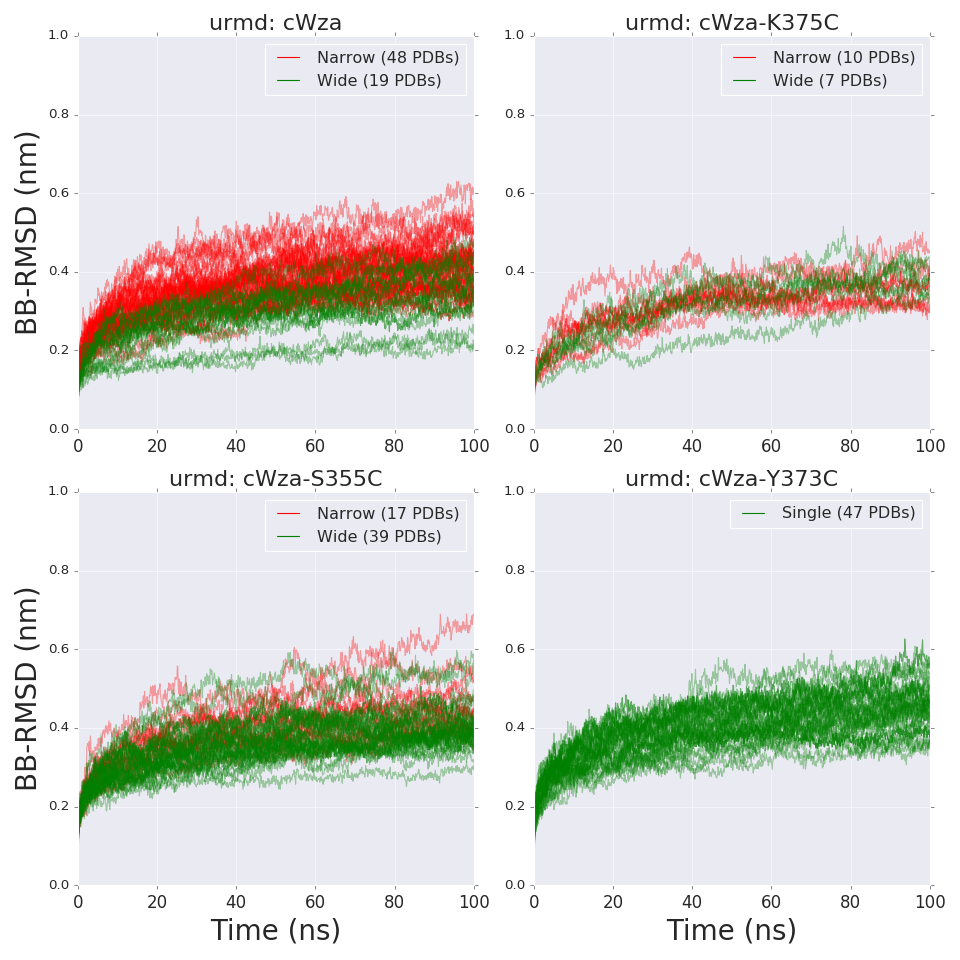

In [262]:
name = 'md_100ns'
atomic_group = 'Backbone'

fig, ax = plt.subplots(2,2,figsize=(12,12))

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'red', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'red', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'red', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-K375C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-S355C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-Y373C':{'conformation1':'Single'}
}

def filter_XY(filename):
    lines = open(filename,'r').readlines()
    return [list(map(float,xy.split())) for xy in lines if (not "#" in xy) and (not "@" in xy)]

MyTags = prmd.tags
for tag in MyTags:
    mutant, group = json.loads(tag)
    ############################################
    COUNTER_model = 0
    for n in range(len(refined_param_list)):
        if refined_param_list[n].split('/')[0] == mutant and refined_param_list[n].split('/')[1] == group:
            COUNTER_model += 1
            filename = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name+'_rmsd_'+atomic_group+'.xvg'
            data = filter_XY(filename)
            X,Y = numpy.array(data).T
            mycolor = Colors[mutant][Conformations[mutant][group]]
            axes[mutant].plot(X,Y,color=mycolor,alpha=0.35)
    ############################################
    # Add conformation labels
    mycolor = Colors[mutant][Conformations[mutant][group]]
    axes[mutant].plot([],[],label=Conformations[mutant][group]+" ("+str(COUNTER_model)+" PDBs)",color=mycolor)
    ############################################
    # Customise plot
    axes[mutant].set_xticklabels(range(0,110,20), fontsize=15)
#     axes[mutant].set_yticklabels(range(0,11,2), fontsize=15)
    axes[mutant].set_title("urmd: "+mutant, fontsize=20)
    axes[mutant].set_xlim(0,100000)
    axes[mutant].set_ylim(0,1)
    axes[mutant].legend(loc='best')

# More customisation
axes['cWza'].set_ylabel("BB-RMSD (nm)",fontsize=25)
axes['cWza-S355C'].set_ylabel("BB-RMSD (nm)",fontsize=25)
axes['cWza-S355C'].set_xlabel("Time (ns)",fontsize=25)
axes['cWza-Y373C'].set_xlabel("Time (ns)",fontsize=25)

fig.tight_layout()
plt.show()

## Radius of Gyration: Z-axis principal component

### Scripts for data extraction

In [250]:
%%writefile /home/ba13026/mpmodeling/tools/gyrate_from_traj.py
import sys
import os
import subprocess
import concurrent.futures

# Import modules from folder
modules_path = "/home/ba13026/mpmodeling/protocols/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

from cluster_transfer import BG

# Get path to filename
name = sys.argv[1]
atomic_group = sys.argv[2]
model_path = sys.argv[3]

if os.path.isdir(model_path):
    pass
else:
    try:
        model_path = BG.workdir + model_path
        if os.path.isdir(model_path):
            pass
    except:
        print("Not a valid dir path for model")

extension = '.xtc'
filename = model_path+'/complex/mdf/' + name

# Generate index file
cmd = [
        'gmx_mpi','gyrate',
        '-f',filename+'.xtc',
        '-s',filename+'.tpr',
        '-n',filename+'.ndx',
        '-p',
        '-o',filename+'_gyrate_'+atomic_group+'.xvg'
        ]
proc = subprocess.Popen(cmd, stdin = subprocess.PIPE)

proc.communicate(bytes(atomic_group+"\n",'utf-8'))
proc.wait()

Overwriting /home/ba13026/mpmodeling/tools/gyrate_from_traj.py


In [251]:
%%writefile /home/ba13026/mpmodeling/tools/parallel_gyrate_analysis.py
import sys
import os
import json
import subprocess
import concurrent.futures


# Import modules from folder
modules_path = "/home/ba13026/mpmodeling/protocols/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

from cluster_transfer import BG

ncores = int(sys.argv[1])
json_input = sys.argv[2]

with open(json_input,'r') as fp:
    param_list = json.load(fp)

name = 'md_100ns'
atomic_group = 'Backbone'

refined_param_list = []
for model_dir in param_list:
    filename1 = name+".gro"
    filename2 = name+".xtc"
    file2check1 = BG.workdir+model_dir+'/complex/mdf/'+filename1
    file2check2 = BG.workdir+model_dir+'/complex/mdf/'+filename2
    if os.path.isfile(file2check1) and os.path.isfile(file2check2):
        refined_param_list.append(model_dir)

param_list = refined_param_list

def get_rmsd(r_model_dir):
    script_path = '/home/ba13026/mpmodeling/tools/gyrate_from_traj.py'
    cmd = ['python', script_path, name, atomic_group, r_model_dir]
    proc = subprocess.Popen(cmd)
    proc.wait()

def main():
    with concurrent.futures.ProcessPoolExecutor(max_workers = ncores) as executor:
        executor.map(get_rmsd, param_list)

if __name__ == '__main__':
        main()

Writing /home/ba13026/mpmodeling/tools/parallel_gyrate_analysis.py


Execution in terminal:
```bash
nohup python ~/mpmodeling/tools/parallel_gyrate_analysis.py 10 EMMD_Sample.json > parallel_gyrate_analysis.out &
```

### Data Analysis

<IPython.core.display.Javascript object>


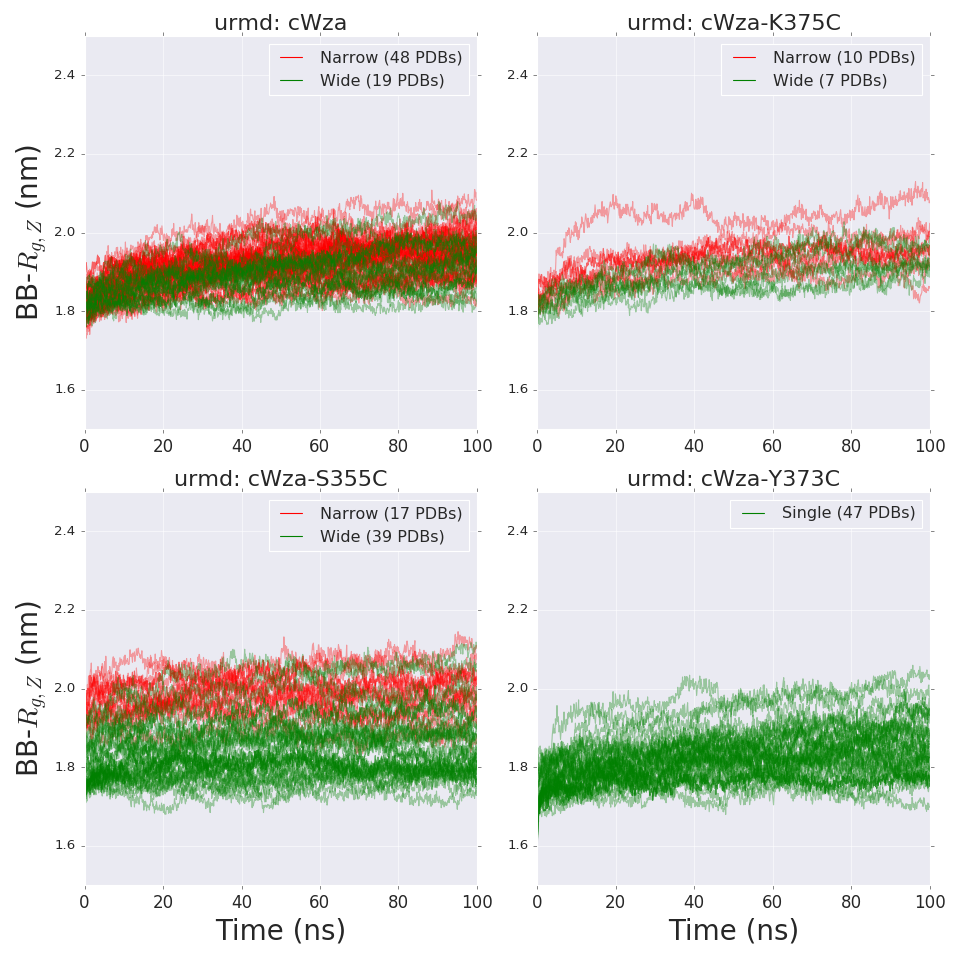

In [261]:
name = 'md_100ns'
atomic_group = 'Backbone'

fig, ax = plt.subplots(2,2,figsize=(12,12))

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'red', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'red', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'red', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-K375C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-S355C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-Y373C':{'conformation1':'Single'}
}

def filter_XY(filename):
    lines = open(filename,'r').readlines()
    return [list(map(float,xy.split())) for xy in lines if (not "#" in xy) and (not "@" in xy)]

MyTags = prmd.tags
for tag in MyTags:
    mutant, group = json.loads(tag)
    ############################################
    COUNTER_model = 0
    for n in range(len(refined_param_list)):
        if refined_param_list[n].split('/')[0] == mutant and refined_param_list[n].split('/')[1] == group:
            COUNTER_model += 1
            filename = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name+'_gyrate_'+atomic_group+'.xvg'
            data = filter_XY(filename)
            data = numpy.array(data).T
            X = data[0]; Y = data[4]
            mycolor = Colors[mutant][Conformations[mutant][group]]
            axes[mutant].plot(X,Y,color=mycolor,alpha=0.35)
    ############################################
    # Add conformation labels
    mycolor = Colors[mutant][Conformations[mutant][group]]
    axes[mutant].plot([],[],label=Conformations[mutant][group]+" ("+str(COUNTER_model)+" PDBs)",color=mycolor)
    ############################################
    # Customise plot
    axes[mutant].set_xticklabels(range(0,110,20), fontsize=15)
#     axes[mutant].set_yticklabels(range(0,11,2), fontsize=15)
    axes[mutant].set_title("urmd: "+mutant, fontsize=20)
    axes[mutant].set_xlim(0,100000)
    axes[mutant].set_ylim(1.5,2.5)
    axes[mutant].legend(loc='best')

# More customisation
axes['cWza'].set_ylabel("BB-$R_{g, Z}$ (nm)",fontsize=25)
axes['cWza-S355C'].set_ylabel("BB-$R_{g, Z}$ (nm)",fontsize=25)
axes['cWza-S355C'].set_xlabel("Time (ns)",fontsize=25)
axes['cWza-Y373C'].set_xlabel("Time (ns)",fontsize=25)

fig.tight_layout()
plt.show()

## RMSF 

In [465]:
import MDAnalysis as mda
from MDAnalysis.analysis import align

filename = BG.workdir+'cWza/conformation0/refined1_0001_INPUT_0736_ignorechain/complex/mdf/md_100ns'

u = mda.Universe(filename+'.tpr',filename+'.xtc')
len(u.trajectory)

1001

CONDENSATION: Ref structure, *average*

<IPython.core.display.Javascript object>


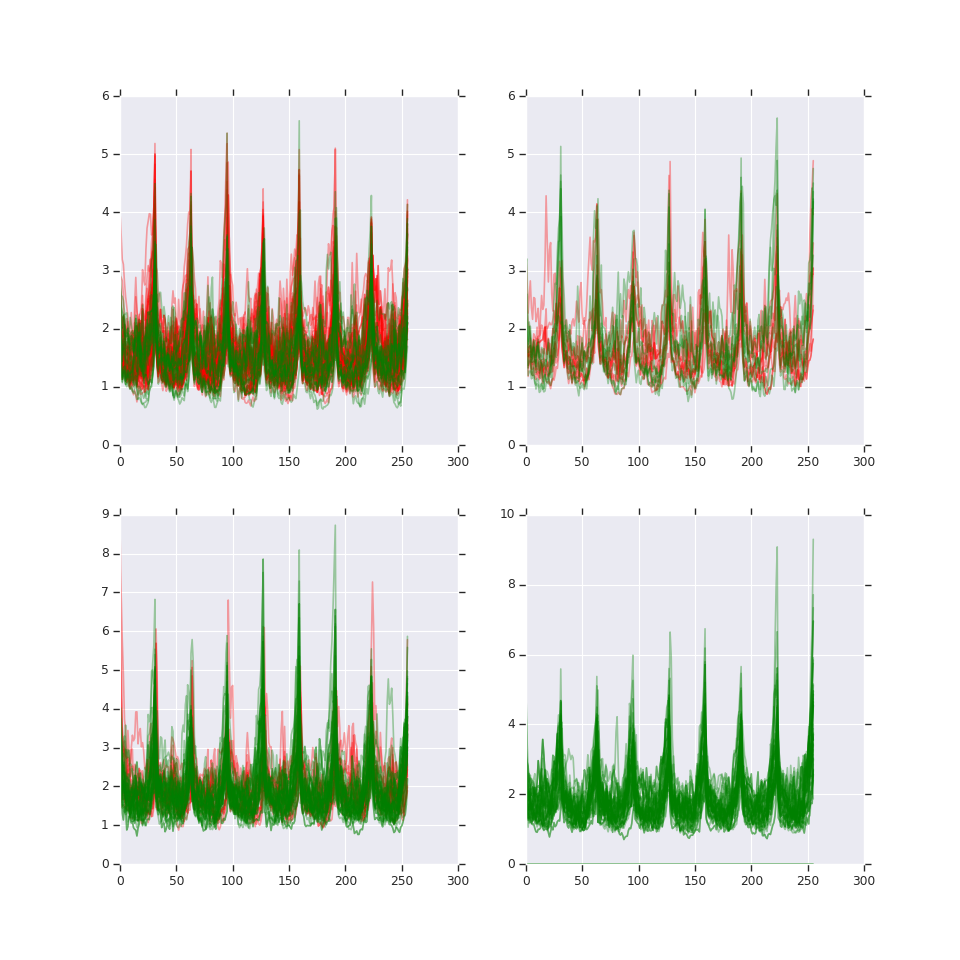

Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]
Step  1001/1001 [100.0%]


In [343]:
import MDAnalysis as mda
from MDAnalysis.analysis import align
from MDAnalysis.analysis.rms import RMSF

name = 'md_100ns'

fig, ax = plt.subplots(2,2,figsize=(12,12))

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'red', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'red', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'red', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-K375C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-S355C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-Y373C':{'conformation1':'Single'}
}

MyData = {}

MyTags = prmd.tags
for tag in MyTags:
    mutant, group = json.loads(tag)
    MyData[tag] = []
    ############################################
    COUNTER_model = 0
    for n in range(len(refined_param_list)):
        if refined_param_list[n].split('/')[0] == mutant and refined_param_list[n].split('/')[1] == group:
            COUNTER_model += 1
            filename = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name
            u = mda.Universe(filename+'.tpr',filename+'.xtc', in_memory=True)
            protein = u.select_atoms("protein")

            reference_coordinates = u.trajectory.timeseries(asel=protein).mean(axis=1)
            reference = mda.Merge(protein).load_new(
                        reference_coordinates[:, None, :], order="afc")

            aligner = align.AlignTraj(u, reference, select="protein and name CA", in_memory=True).run()

            calphas = protein.select_atoms("name CA")
            rmsfer = RMSF(calphas, verbose=True).run()
            
            mycolor = Colors[mutant][Conformations[mutant][group]]
            MyData[tag].append([calphas.resnums, rmsfer.rmsf])
            
            axes[mutant].plot(calphas.resnums, rmsfer.rmsf,color=mycolor,alpha=0.35)
            
plt.show()

CONDENSATION: Ref structure, *initial structure*

<IPython.core.display.Javascript object>


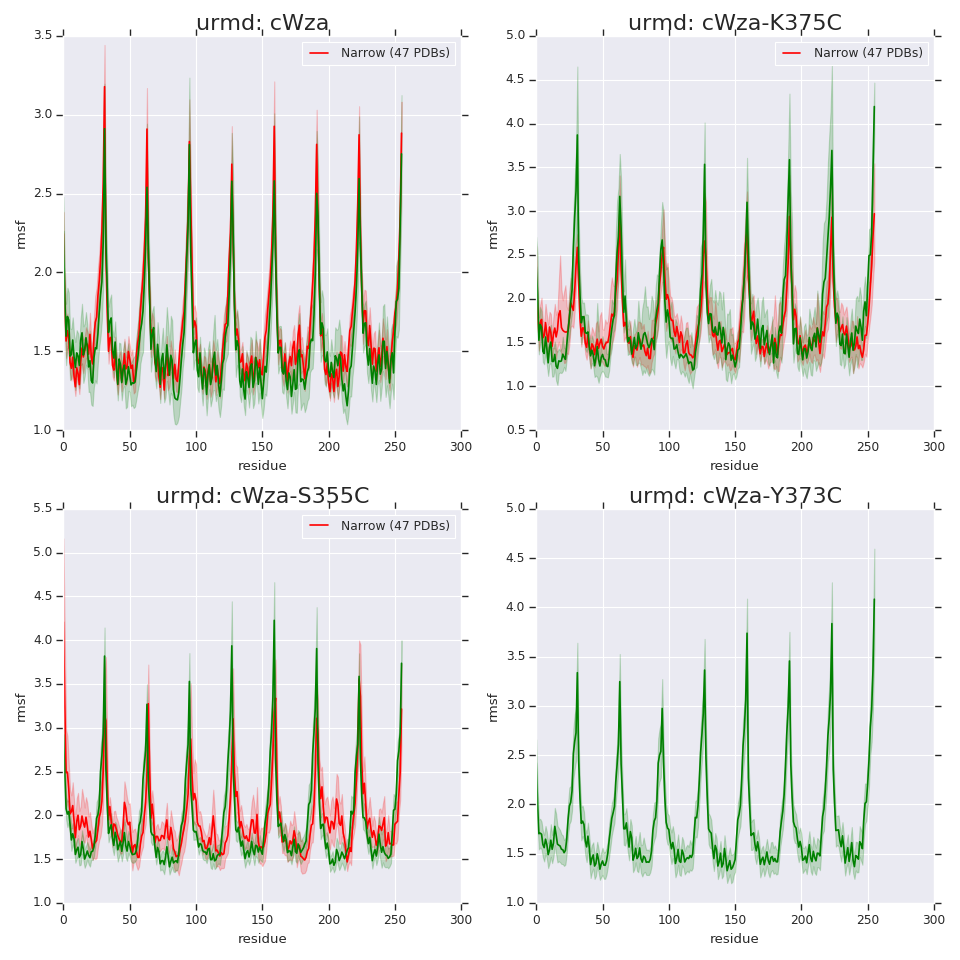

In [428]:
name = 'md_100ns'
atomic_group = 'Backbone'

fig, ax = plt.subplots(2,2,figsize=(12,12))

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'red', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'red', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'red', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-K375C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-S355C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-Y373C':{'conformation1':'Single'}
}

MyTags = prmd.tags
for tag in MyTags:
    mutant, group = json.loads(tag)
    test_data = {}
    test_data['residue'] = []
    test_data['rmsf'] = []
    for xy in MyData[tag]:
        test_data['residue'] = test_data['residue'] + list(xy[0])
        test_data['rmsf'] = test_data['rmsf'] + list(xy[1])

    df = pd.DataFrame(test_data)
    mycolor = Colors[mutant][Conformations[mutant][group]]
    sns.lineplot(x='residue', y='rmsf', data = df, color=mycolor, ax=axes[mutant])
    
    ############################################
    axes[mutant].plot([],[],label=Conformations[mutant][group]+" ("+str(COUNTER_model)+" PDBs)",color=mycolor)
    ############################################
#     Customise plot
#     axes[mutant].set_xticklabels(range(0,33),fontsize=15)
#     axes[mutant].set_yticklabels(range(0,11,2), fontsize=15)
    axes[mutant].set_title("urmd: "+mutant, fontsize=20)
#     axes[mutant].set_xlim(0,33)
#     axes[mutant].set_ylim(0.1,0.4)
#     axes[mutant].tick_params(axis='both',direction='in')
#     axes[mutant].legend(loc='best')

# More customisation
# axes['cWza'].set_ylabel("BB-RMSF (nm)",fontsize=25)
# axes['cWza-K375C'].set_ylabel(" ",fontsize=25)
# axes['cWza-S355C'].set_ylabel("BB-RMSF (nm)",fontsize=25)
# axes['cWza-Y373C'].set_ylabel(" ",fontsize=25)
# axes['cWza'].set_xlabel(" ",fontsize=25)
# axes['cWza-K375C'].set_xlabel(" ",fontsize=25)
# axes['cWza-S355C'].set_xlabel("residue number",fontsize=25)
# axes['cWza-Y373C'].set_xlabel("residue number",fontsize=25)

fig.tight_layout()
plt.show()    

### Scripts for data extraction

Back-end script

In [344]:
%%writefile /home/ba13026/mpmodeling/tools/rmsf_from_traj.py
import sys
import os
import subprocess
import concurrent.futures

# Import modules from folder
modules_path = "/home/ba13026/mpmodeling/protocols/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

from cluster_transfer import BG

# Get path to filename
name = sys.argv[1]
atomic_group = sys.argv[2]
model_path = sys.argv[3]

if os.path.isdir(model_path):
    pass
else:
    try:
        model_path = BG.workdir + model_path
        if os.path.isdir(model_path):
            pass
    except:
        print("Not a valid dir path for model")

extension = '.xtc'
filename = model_path+'/complex/mdf/' + name

# Generate index file
cmd = [
        'gmx_mpi','rmsf',
        '-f',filename+'.xtc',
        '-s',filename+'.tpr',
        '-n',filename+'.ndx',
        '-res',
        '-o',filename+'_rmsf_'+atomic_group+'.xvg'
        ]
proc = subprocess.Popen(cmd, stdin = subprocess.PIPE)

proc.communicate(bytes(atomic_group+"\n",'utf-8'))
proc.wait()

Writing /home/ba13026/mpmodeling/tools/rmsf_from_traj.py


Front-end script

In [345]:
%%writefile /home/ba13026/mpmodeling/tools/parallel_rmsf_analysis.py
import sys
import os
import json
import subprocess
import concurrent.futures


# Import modules from folder
modules_path = "/home/ba13026/mpmodeling/protocols/"
if modules_path not in sys.path:
    sys.path.append(modules_path)

from cluster_transfer import BG

ncores = int(sys.argv[1])
json_input = sys.argv[2]

with open(json_input,'r') as fp:
    param_list = json.load(fp)

name = 'md_100ns'
atomic_group = 'Backbone'

refined_param_list = []
for model_dir in param_list:
    filename1 = name+".gro"
    filename2 = name+".xtc"
    file2check1 = BG.workdir+model_dir+'/complex/mdf/'+filename1
    file2check2 = BG.workdir+model_dir+'/complex/mdf/'+filename2
    if os.path.isfile(file2check1) and os.path.isfile(file2check2):
        refined_param_list.append(model_dir)

param_list = refined_param_list

def get_rmsd(r_model_dir):
    script_path = '/home/ba13026/mpmodeling/tools/rmsf_from_traj.py'
    cmd = ['python', script_path, name, atomic_group, r_model_dir]
    proc = subprocess.Popen(cmd)
    proc.wait()

def main():
    with concurrent.futures.ProcessPoolExecutor(max_workers = ncores) as executor:
        executor.map(get_rmsd, param_list)

if __name__ == '__main__':
        main()

Writing /home/ba13026/mpmodeling/tools/parallel_rmsf_analysis.py


### Data Analysis

Raw data

<IPython.core.display.Javascript object>


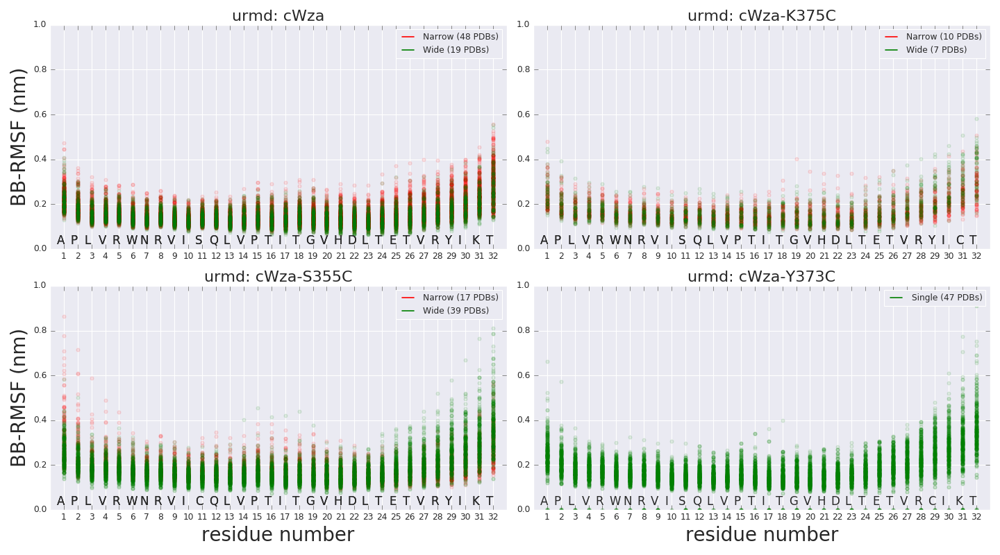

In [458]:
name = 'md_100ns'
atomic_group = 'Backbone'

fig, ax = plt.subplots(2,2,figsize=(18,10))

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'red', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'red', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'red', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-K375C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-S355C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-Y373C':{'conformation1':'Single'}
}

Sequences = {
    'cWza': 'APLVRWNRVISQLVPTITGVHDLTETVRYIKT',
    'cWza-K375C' : 'APLVRWNRVISQLVPTITGVHDLTETVRYICT',
    'cWza-S355C': 'APLVRWNRVICQLVPTITGVHDLTETVRYIKT',
    'cWza-Y373C': 'APLVRWNRVISQLVPTITGVHDLTETVRCIKT'
}

def filter_XY(filename):
    lines = open(filename,'r').readlines()
    return [list(map(float,xy.split())) for xy in lines if (not "#" in xy) and (not "@" in xy)]


MyTags = prmd.tags
for tag in MyTags:
    mutant, group = json.loads(tag)
    test_data = {}
    test_data['residue'] = []
    test_data['rmsf'] = []
    ############################################
    COUNTER_model = 0
    for n in range(len(refined_param_list)):
        if refined_param_list[n].split('/')[0] == mutant and refined_param_list[n].split('/')[1] == group:
            COUNTER_model += 1
            filename = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name+'_rmsf_'+atomic_group+'.xvg'
            data = filter_XY(filename)
            data = numpy.array(data).T
            X = data[0]; Y = data[1]
            ######################
            test_data['residue'] = test_data['residue'] + list(X)
            test_data['rmsf'] = test_data['rmsf'] + list(Y)
            ######################
            mycolor = Colors[mutant][Conformations[mutant][group]]
            axes[mutant].scatter(X,Y,color=mycolor,alpha=0.1)
    ############################################
    # Add conformation labels
#     mycolor = Colors[mutant][Conformations[mutant][group]]
#     ############################################
#     df = pd.DataFrame(test_data)
#     sns.lineplot(x='residue',y='rmsf',data = df,color=mycolor, ax=axes[mutant])
    ############################################
    axes[mutant].plot([],[],label=Conformations[mutant][group]+" ("+str(COUNTER_model)+" PDBs)",color=mycolor)
    ############################################
    # Customise plot
    axes[mutant].set_xticks(range(1,33))
#     axes[mutant].set_xticklabels(Sequences[mutant], fontsize=15)
    for resn in range(32):
        axes[mutant].text(resn+0.5,0.02,Sequences[mutant][resn],fontsize=15)

    axes[mutant].set_title("urmd: "+mutant, fontsize=20)
    axes[mutant].set_xlim(0,33)
    axes[mutant].set_ylim(0.0,1)
    axes[mutant].tick_params(axis='both',direction='in',width=0.5)
    axes[mutant].legend(loc='best')

# More customisation
axes['cWza'].set_ylabel("BB-RMSF (nm)",fontsize=25)
axes['cWza-K375C'].set_ylabel(" ",fontsize=25)
axes['cWza-S355C'].set_ylabel("BB-RMSF (nm)",fontsize=25)
axes['cWza-Y373C'].set_ylabel(" ",fontsize=25)
axes['cWza'].set_xlabel(" ",fontsize=25)
axes['cWza-K375C'].set_xlabel(" ",fontsize=25)
axes['cWza-S355C'].set_xlabel("residue number",fontsize=25)
axes['cWza-Y373C'].set_xlabel("residue number",fontsize=25)

fig.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


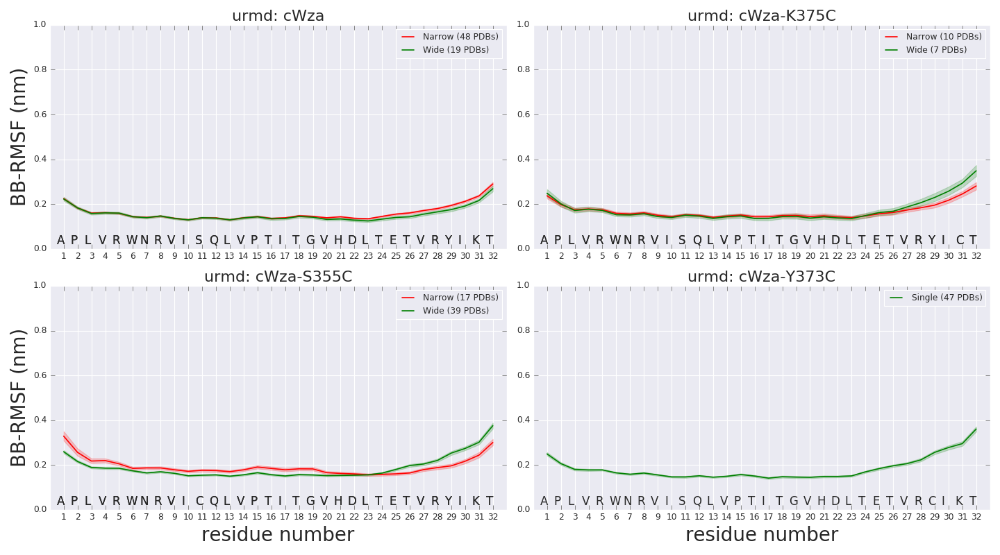

In [459]:
name = 'md_100ns'
atomic_group = 'Backbone'

fig, ax = plt.subplots(2,2,figsize=(18,10))

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'red', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'red', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'red', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-K375C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-S355C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-Y373C':{'conformation1':'Single'}
}

Sequences = {
    'cWza': 'APLVRWNRVISQLVPTITGVHDLTETVRYIKT',
    'cWza-K375C' : 'APLVRWNRVISQLVPTITGVHDLTETVRYICT',
    'cWza-S355C': 'APLVRWNRVICQLVPTITGVHDLTETVRYIKT',
    'cWza-Y373C': 'APLVRWNRVISQLVPTITGVHDLTETVRCIKT'
}

def filter_XY(filename):
    lines = open(filename,'r').readlines()
    return [list(map(float,xy.split())) for xy in lines if (not "#" in xy) and (not "@" in xy)]


MyTags = prmd.tags
for tag in MyTags:
    mutant, group = json.loads(tag)
    test_data = {}
    test_data['residue'] = []
    test_data['rmsf'] = []
    ############################################
    COUNTER_model = 0
    for n in range(len(refined_param_list)):
        if refined_param_list[n].split('/')[0] == mutant and refined_param_list[n].split('/')[1] == group:
            COUNTER_model += 1
            filename = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name+'_rmsf_'+atomic_group+'.xvg'
            data = filter_XY(filename)
            data = numpy.array(data).T
            X = data[0]; Y = data[1]
            ######################
            test_data['residue'] = test_data['residue'] + list(X)
            test_data['rmsf'] = test_data['rmsf'] + list(Y)
            ######################
            mycolor = Colors[mutant][Conformations[mutant][group]]
#             axes[mutant].scatter(X,Y,color=mycolor,alpha=0.35)
    ############################################
    # Add conformation labels
    mycolor = Colors[mutant][Conformations[mutant][group]]
    ############################################
    df = pd.DataFrame(test_data)
    sns.lineplot(x='residue',y='rmsf',data = df,color=mycolor, ax=axes[mutant])
    ############################################
    axes[mutant].plot([],[],label=Conformations[mutant][group]+" ("+str(COUNTER_model)+" PDBs)",color=mycolor)
    ############################################
    # Customise plot
    axes[mutant].set_xticks(range(1,33))
#     axes[mutant].set_xticklabels(Sequences[mutant], fontsize=15)
    for resn in range(32):
        axes[mutant].text(resn+0.5,0.02,Sequences[mutant][resn],fontsize=15)

    axes[mutant].set_title("urmd: "+mutant, fontsize=20)
    axes[mutant].set_xlim(0,33)
    axes[mutant].set_ylim(0,1)
    axes[mutant].tick_params(axis='both',direction='in',width=0.5)
    axes[mutant].legend(loc='best')

# More customisation
axes['cWza'].set_ylabel("BB-RMSF (nm)",fontsize=25)
axes['cWza-K375C'].set_ylabel(" ",fontsize=25)
axes['cWza-S355C'].set_ylabel("BB-RMSF (nm)",fontsize=25)
axes['cWza-Y373C'].set_ylabel(" ",fontsize=25)
axes['cWza'].set_xlabel(" ",fontsize=25)
axes['cWza-K375C'].set_xlabel(" ",fontsize=25)
axes['cWza-S355C'].set_xlabel("residue number",fontsize=25)
axes['cWza-Y373C'].set_xlabel("residue number",fontsize=25)

fig.tight_layout()
plt.show()

## Identification of backbone-assembly stable models 

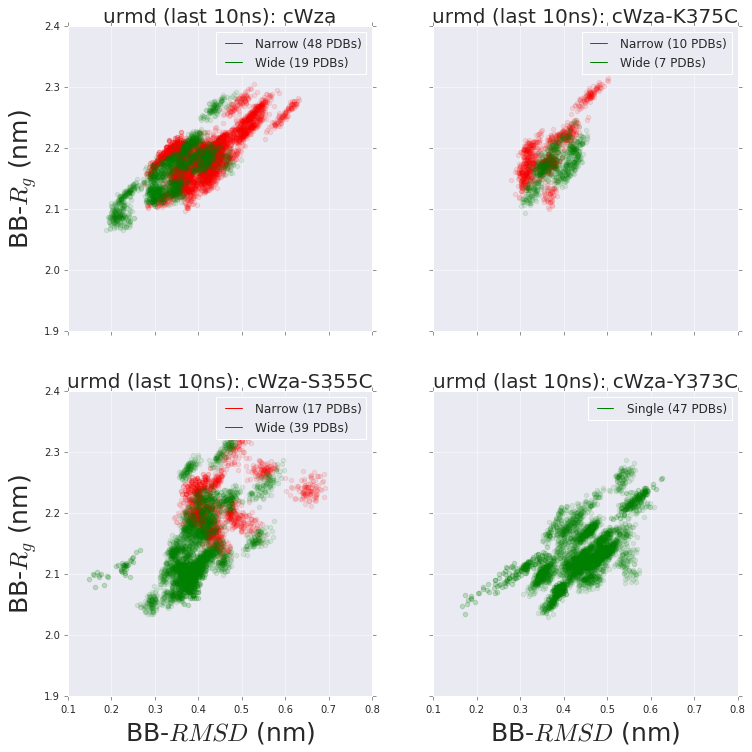

In [56]:
name = 'md_100ns'
atomic_group = 'Backbone'

fig, ax = plt.subplots(2,2,figsize=(12,12),sharex=True,sharey=True)

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'red', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'red', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'red', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-K375C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-S355C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-Y373C':{'conformation1':'Single'}
}

def filter_XY(filename):
    lines = open(filename,'r').readlines()
    return [list(map(float,xy.split())) for xy in lines if (not "#" in xy) and (not "@" in xy)]

MyTags = prmd.tags
for tag in MyTags:
    mutant, group = json.loads(tag)
    ############################################
    COUNTER_model = 0
    for n in range(len(refined_param_list)):
        if refined_param_list[n].split('/')[0] == mutant and refined_param_list[n].split('/')[1] == group:
            COUNTER_model += 1
            filename1 = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name+'_rmsd_'+atomic_group+'.xvg'
            filename2 = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name+'_gyrate_'+atomic_group+'.xvg'
            data1 = filter_XY(filename1)
            data2 = filter_XY(filename2)
            X1,Y1 = numpy.array(data1).T
            data2 = numpy.array(data2).T
            X2 = data2[0]; Y2 = data2[1]
            
            mycolor = Colors[mutant][Conformations[mutant][group]]
            axes[mutant].scatter(Y1[-100:],Y2[-100:],color=mycolor,s=20,alpha=0.1)
    axes[mutant].plot([],[],label=Conformations[mutant][group]+" ("+str(COUNTER_model)+" PDBs)",color=mycolor)
    ############################################
    # Customise plot
#     axes[mutant].set_xticklabels(range(0,110,20), fontsize=15)
#     axes[mutant].set_yticklabels(range(0,11,2), fontsize=15)
    axes[mutant].set_title("urmd (last 10ns): "+mutant, fontsize=20)
    axes[mutant].set_xlim(0.1,0.8)
#     axes[mutant].set_ylim(1.5,2.5)
    axes[mutant].legend(loc='best')

# More customisation
axes['cWza'].set_ylabel("BB-$R_{g}$ (nm)",fontsize=25)
axes['cWza-S355C'].set_ylabel("BB-$R_{g}$ (nm)",fontsize=25)
axes['cWza-S355C'].set_xlabel("BB-$RMSD$ (nm)",fontsize=25)
axes['cWza-Y373C'].set_xlabel("BB-$RMSD$ (nm)",fontsize=25)

plt.show()

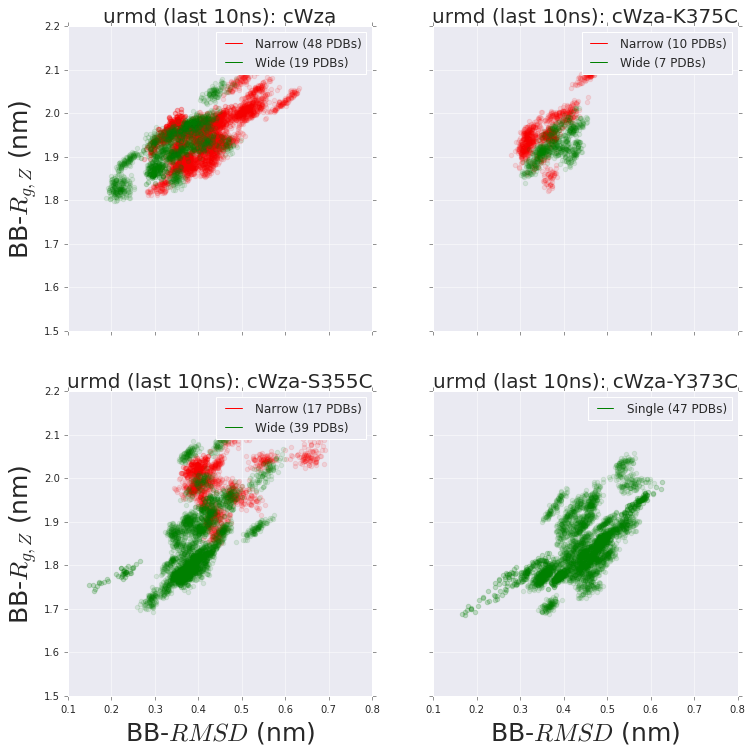

In [57]:
name = 'md_100ns'
atomic_group = 'Backbone'

fig, ax = plt.subplots(2,2,figsize=(12,12),sharex=True,sharey=True)

sns.set_style("darkgrid")

axes = {
    'cWza':ax[0,0],
    'cWza-K375C':ax[0,1],
    'cWza-S355C':ax[1,0],
    'cWza-Y373C':ax[1,1]
}

Colors = {
    'cWza':{'Narrow':'red', 'Wide':'green'},
    'cWza-K375C':{'Narrow':'red', 'Wide':'green'},
    'cWza-S355C':{'Narrow':'red', 'Wide':'green'},
    'cWza-Y373C':{'Single':'green'}
}

Conformations = {
    'cWza':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-K375C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-S355C':{'conformation0':'Narrow', 'conformation1':'Wide'},
    'cWza-Y373C':{'conformation1':'Single'}
}

def filter_XY(filename):
    lines = open(filename,'r').readlines()
    return [list(map(float,xy.split())) for xy in lines if (not "#" in xy) and (not "@" in xy)]

MyTags = prmd.tags
for tag in MyTags:
    mutant, group = json.loads(tag)
    ############################################
    COUNTER_model = 0
    for n in range(len(refined_param_list)):
        if refined_param_list[n].split('/')[0] == mutant and refined_param_list[n].split('/')[1] == group:
            COUNTER_model += 1
            filename1 = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name+'_rmsd_'+atomic_group+'.xvg'
            filename2 = BG.workdir+refined_param_list[n]+'/complex/mdf/'+name+'_gyrate_'+atomic_group+'.xvg'
            data1 = filter_XY(filename1)
            data2 = filter_XY(filename2)
            X1,Y1 = numpy.array(data1).T
            data2 = numpy.array(data2).T
            X2 = data2[0]; Y2 = data2[4]
            
            mycolor = Colors[mutant][Conformations[mutant][group]]
            axes[mutant].scatter(Y1[-100:],Y2[-100:],color=mycolor,s=20,alpha=0.1)
    axes[mutant].plot([],[],label=Conformations[mutant][group]+" ("+str(COUNTER_model)+" PDBs)",color=mycolor)
    ############################################
    # Customise plot
#     axes[mutant].set_xticklabels(range(0,110,20), fontsize=15)
#     axes[mutant].set_yticklabels(range(0,11,2), fontsize=15)
    axes[mutant].set_title("urmd (last 10ns): "+mutant, fontsize=20)
    axes[mutant].set_xlim(0.1,0.8)
#             axes[mutant].set_ylim(1.5,2.5)
    axes[mutant].legend(loc='best')

# More customisation
axes['cWza'].set_ylabel("BB-$R_{g,Z}$ (nm)",fontsize=25)
axes['cWza-S355C'].set_ylabel("BB-$R_{g,Z}$ (nm)",fontsize=25)
axes['cWza-S355C'].set_xlabel("BB-$RMSD$ (nm)",fontsize=25)
axes['cWza-Y373C'].set_xlabel("BB-$RMSD$ (nm)",fontsize=25)

plt.show()

# Extended PRMD simulations (50 ns, 2fs time-step)

These interactions are shared between cWza, cWza-K375C, and cWza-S355C

```python
bg white
hide lines
show cartoon, chain a+b
show sticks, resid 29 and chain b
show sticks, chain a and resid 21+24+25+28
ray
```

```python
bg white
hide lines
show cartoon, chain a+b
show sticks, resid 3 and chain a
show sticks, chain b and resid 9+12+13+16
ray
```

This KIH atomic group is not shared with any of the previous

```python
bg white
hide lines
show cartoon, chain a+b
show sticks, resid 19 and chain b
show sticks, chain a and resid 14+17+18+21
show sticks, resid 26 and chain b
show sticks, chain a and resid 21+24+25+28
ray
```

**Key interactions identified through docking**


*OH-atoms*

**cWza**

Narrow: 

21-H ||| 22-O, 0

18-H ||| 22-O, -1


**cWza-K375C**

Wide:

28-H ||| 32-O, -1

**cWza-S355C**

Narrow:

21-H ||| 22-O, 0

Wide:

26-H ||| 25-O, 1

**cWza-Y373C** 

26-H ||| 25-O, 1

*KIHs atoms*



# FIGURES


## L-state, cWza

```bash
pymol cWza/conformation0/refined1_0001_INPUT_0089_ignorechain/complex/protein_RAW.pdb

# PyMOL commands
bg white
hide lines
set ray_orthoscopic, on
# Customise cartoon
create chainsAB, chain a+b
create chainsC2H, chain c:h
#
set cartoon_color, marine
#
show cartoon, chainsAB
show cartoon, chainsC2H
set cartoon_transparency, 0.5, chainsAB
set cartoon_transparency, 0.8, chainsC2H
# Show sticks of KIHs
show sticks, chain b and resid 29
show sticks, chain a and resid 21+24+25+28
#
set ray_opaque_background, 0
ray 2400, 2400
png /home/ba13026/research/cwza_L.png
```

```bash
pymol cWza/conformation1/refined1_0001_INPUT_0099_ignorechain/complex/protein_RAW.pdb

# PyMOL commands
bg white
hide lines
set ray_orthoscopic, on
# Customise cartoon
create chainsAB, chain a+b
create chainsC2H, chain c:h
#
set cartoon_color, green
#
show cartoon, chainsAB
show cartoon, chainsC2H
set cartoon_transparency, 0.5, chainsAB
set cartoon_transparency, 0.8, chainsC2H
# Show sticks of KIHs
show sticks, chain b and resid 16
show sticks, chain a and resid 3+7+10+14
#
set ray_opaque_background, 0
ray 2400, 2400
png /home/ba13026/research/cwza_H.png
```

## cWza-Y373C

```bash
pymol cWza/conformation1/refined1_0001_INPUT_0099_ignorechain/complex/protein_RAW.pdb

# PyMOL commands
bg white
hide lines
set ray_orthoscopic, on
# Customise cartoon
create chainsAB, chain a+b
create chainsC2H, chain c:h
#
set cartoon_color, green
#
show cartoon, chainsAB
show cartoon, chainsC2H
set cartoon_transparency, 0.5, chainsAB
set cartoon_transparency, 0.8, chainsC2H
# Show sticks of KIHs
show sticks, chain b and resid 19+26
show sticks, chain a and resid 14+17+18+21+24+25+28
#
set ray_opaque_background, 0
ray 2400, 2400
png /home/ba13026/research/cwzay373c_H.png
```